## Red Neuronal Inception V3 Tesis
# Juan David Galan Vargas - 202111470
### Correción con NUEVA MUESTRA DE ENTRENAMIENTO CON DISTANCIAS POR SHELL AJUSTADAS

In [1]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
import os
import keras
from keras.models import Sequential
from keras import backend as K
from keras.layers import Input
import pandas as pd
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import csv
import pydot
from tensorflow.keras.utils import plot_model
import tensorflow.keras.backend as K
from sklearn.metrics import f1_score
import matplotlib.colors as mcolors
import re
from astropy.coordinates import SkyCoord, CartesianRepresentation, CartesianDifferential, Angle
import astropy.units as u


c:\Users\juang\anaconda3\lib\site-packages\pandas\core\computation\expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.7.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
c:\Users\juang\anaconda3\lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.2' currently installed).
  from pandas.core import (


In [2]:
cumulos_folder_shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell1\si"
nocumulos_folder_shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell1\no"

shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\Muestra Entrenamiento Corregida\Shell1"
shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\Muestra Entrenamiento Corregida\Shell2"

cumulos_folder_shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell2\si"
nocumulos_folder_shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Muestra Entrenamiento\Shell2\no"

clasificar_shell1=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Diagramas Shell\shell1"
clasificar_shell2=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Diagramas Shell\shell2"

### Shell 1

In [ ]:
#VALIDATION SET IMBALANCED

from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
train_data_dir=shell1
# Step 1: Gather image filepaths and labels
filepaths = []
labels = []

for class_name in ['no', 'si']:
    class_dir = os.path.join(train_data_dir, class_name)
    for fname in os.listdir(class_dir):
        filepaths.append(os.path.join(class_dir, fname))
        labels.append(class_name)

df = pd.DataFrame({'filename': filepaths, 'class': labels})

# Step 2: Custom class-imbalanced validation split
# Desired validation fraction and class proportions
validation_fraction = 0.15  # 15% of the full dataset
validation_no_ratio = 0.8
validation_si_ratio = 0.2

total_val_samples = int(len(df) * validation_fraction)
val_no_count = int(total_val_samples * validation_no_ratio)
val_si_count = total_val_samples - val_no_count  # to ensure the total matches

df_no = df[df['class'] == 'no']
df_si = df[df['class'] == 'si']

val_no = df_no.sample(n=val_no_count, random_state=42)
val_si = df_si.sample(n=val_si_count, random_state=42)

val_df = pd.concat([val_no, val_si])
train_df = df.drop(val_df.index)


# Step 3: Use flow_from_dataframe
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False
)

val_datagen = ImageDataGenerator(rescale=1.0/255.0)

train_generator = train_datagen.flow_from_dataframe(
    train_df,
    x_col='filename',
    y_col='class',
    target_size=(253, 385),
    class_mode='binary',
    batch_size=32,
    shuffle=True
)

validation_generator = val_datagen.flow_from_dataframe(
    val_df,
    x_col='filename',
    y_col='class',
    target_size=(253, 385),
    class_mode='binary',
    batch_size=32,
    shuffle=False  # don't shuffle validation
)


Found 8732 validated image filenames belonging to 2 classes.
Found 1540 validated image filenames belonging to 2 classes.


In [ ]:
# Data generators
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False,
    validation_split=0.15  # 20% for validation
)

# CAMBIAR SHELL 1 O SHELL 2
train_data_dir = shell1

# Training data
train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,
    subset='training'  # Training set (80%)
)

# Validation data
validation_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,           # Typically don't shuffle validation data
    subset='validation'      # Validation set (20%)
)


Found 8732 images belonging to 2 classes.
Found 1540 images belonging to 2 classes.


In [5]:
def reshape_binary_labels(generator):
    for x, y in generator:
        yield x, y.reshape(-1, 1)

train_data_dir = shell1

# Data generators
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False,
    validation_split=0.15  # 20% for validation
)

train_generator = reshape_binary_labels(train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,
    subset='training'
))

validation_generator = reshape_binary_labels(train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(253, 385),
    batch_size=32,
    class_mode='binary',
    classes=['no', 'si'],
    shuffle=True,
    subset='validation'
))


Found 8732 images belonging to 2 classes.
Found 1540 images belonging to 2 classes.


In [4]:
def get_model():
    base_model = InceptionV3(input_shape = (253,385,3), weights='imagenet', include_top=False)
    x = base_model.output
    x = keras.layers.GlobalAveragePooling2D()(x)
    x = keras.layers.Dense(1024, activation='relu')(x)
    x = keras.layers.BatchNormalization()(x)
    #x = keras.layers.Dense(512, activation='relu')(x)
    #x = keras.layers.BatchNormalization()(x)
    predictions = keras.layers.Dense(1, activation='sigmoid')(x)
    model = keras.models.Model(inputs=base_model.input, outputs=predictions)
    for layer in base_model.layers:
        layer.trainable = False #Originalmente False, True en prueba
        
    for layer in base_model.layers[-150:]:
        layer.trainable = False
    return model
model = get_model()

# Compile the model


In [5]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.BinaryAccuracy(name='accuracy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
]
model.compile(
    optimizer=keras.optimizers.Adam(0.001),
    loss='binary_crossentropy',
    metrics=METRICS)

In [6]:
model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=2)
    #,class_weight={0: 1.25, 1: 5.0})

c:\Users\juang\anaconda3\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/2
273/273 ━━━━━━━━━━━━━━━━━━━━ 815s 3s/step - accuracy: 0.8888 - auc: 0.9456 - fn: 264.0110 - fp: 177.0146 - loss: 0.3470 - precision: 0.9163 - recall: 0.8791 - tn: 1784.3759 - tp: 2170.9490 - val_accuracy: 0.9669 - val_auc: 0.9824 - val_fn: 50.0000 - val_fp: 1.0000 - val_loss: 0.1096 - val_precision: 0.9961 - val_recall: 0.8377 - val_tn: 1231.0000 - val_tp: 258.0000
Epoch 2/2
273/273 ━━━━━━━━━━━━━━━━━━━━ 964s 4s/step - accuracy: 0.9180 - auc: 0.9684 - fn: 221.3759 - fp: 138.0329 - loss: 0.2164 - precision: 0.9407 - recall: 0.9092 - tn: 1827.3467 - tp: 2210.0767 - val_accuracy: 0.9649 - val_auc: 0.9863 - val_fn: 31.0000 - val_fp: 23.0000 - val_loss: 0.0917 - val_precision: 0.9233 - val_recall: 0.8994 - val_tn: 1209.0000 - val_tp: 277.0000


### Modelos

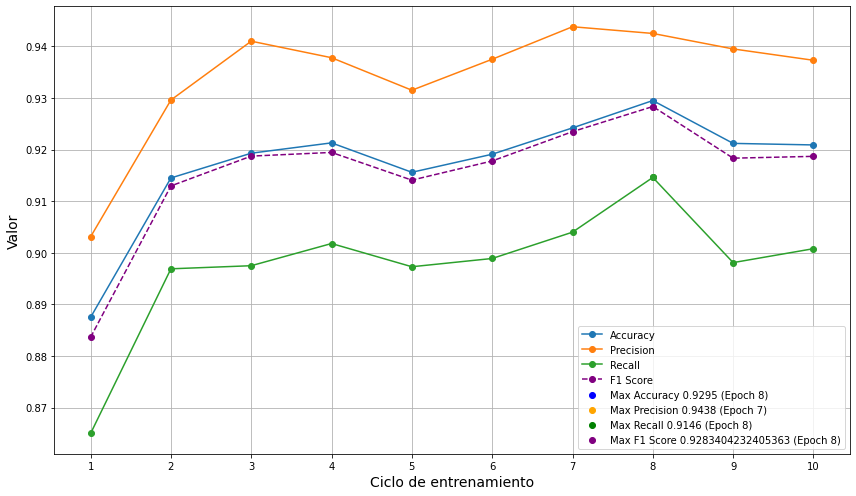

Highest Accuracy: 0.9295 at Epoch 8
Highest Precision: 0.9438 at Epoch 7
Highest Recall: 0.9146 at Epoch 8
Highest F1 Score: 0.9283404232405363 at Epoch 8


In [4]:
#MODELO 0
# Metrics data from your training output
epochs = range(1, 11)
accuracy = [0.8875, 0.9145, 0.9193, 0.9213, 0.9156, 0.9191, 0.9242, 0.9295, 0.9212, 0.9209]
precision = [0.9031, 0.9296, 0.9410, 0.9378, 0.9315, 0.9375, 0.9438, 0.9425, 0.9395, 0.9373]
recall = [0.8650, 0.8969, 0.8975, 0.9018, 0.8973, 0.8989, 0.9040, 0.9146, 0.8981, 0.9008]

# Calculate F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 0 (Only Dense Layer Trained)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")


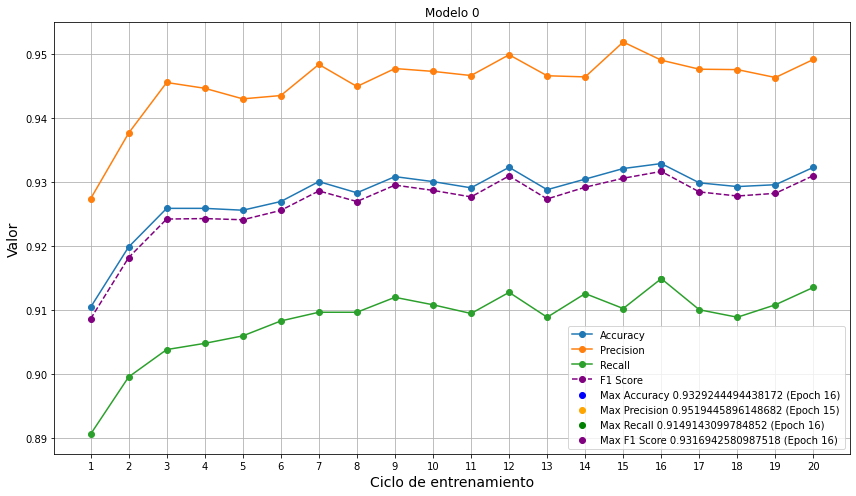

Highest Accuracy: 0.9329244494438172 at Epoch 16
Highest Precision: 0.9519445896148682 at Epoch 15
Highest Recall: 0.9149143099784852 at Epoch 16
Highest F1 Score: 0.9316942580987518 at Epoch 16


In [11]:
#MODELO 0 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo0.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 0")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

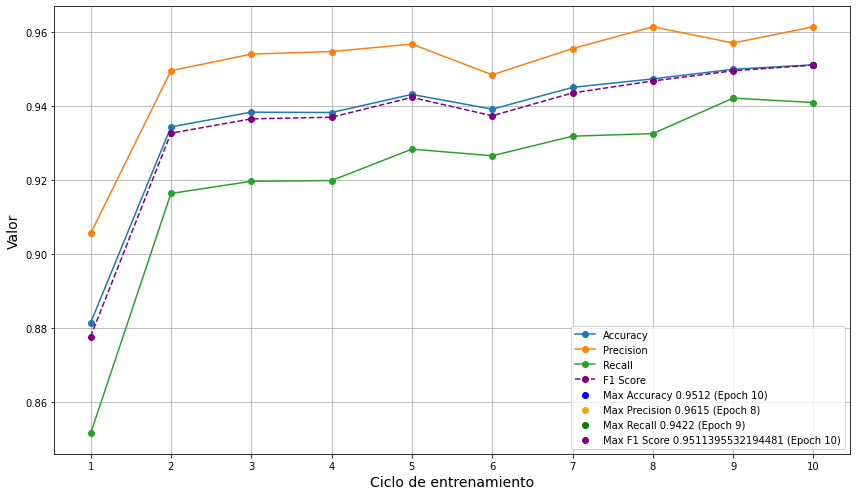

Highest Accuracy: 0.9512 at Epoch 10
Highest Precision: 0.9615 at Epoch 8
Highest Recall: 0.9422 at Epoch 9
Highest F1 Score: 0.9511395532194481 at Epoch 10


In [5]:
#MODELO 1
epochs = list(range(1, 11))  # Epochs 1 to 10

accuracy = [0.8814, 0.9344, 0.9384, 0.9383, 0.9432, 0.9392, 0.9451, 0.9474, 0.9500, 0.9512]
auc = [0.9422, 0.9790, 0.9811, 0.9802, 0.9839, 0.9827, 0.9863, 0.9876, 0.9888, 0.9906]
fn = [331.7050, 224.2547, 204.9193, 199.1087, 192.4689, 188.5745, 174.5807, 164.6429, 153.7950, 154.9783]
fp = [190.5248, 133.0217, 114.5435, 114.9565, 113.8758, 120.6553, 109.1677, 101.3789, 99.2733, 99.3758]
loss = [0.3159, 0.1737, 0.1650, 0.1669, 0.1502, 0.1598, 0.1410, 0.1343, 0.1296, 0.1204]
precision = [0.9056, 0.9496, 0.9541, 0.9548, 0.9568, 0.9485, 0.9556, 0.9615, 0.9571, 0.9615]
recall = [0.8515, 0.9164, 0.9197, 0.9199, 0.9284, 0.9266, 0.9319, 0.9326, 0.9422, 0.9410]
tn = [2372.2144, 2466.4131, 2483.5684, 2469.3262, 2466.6926, 2481.4875, 2483.9473, 2472.1987, 2482.8540, 2466.0684]
tp = [2273.4565, 2344.2112, 2364.8696, 2384.5093, 2394.8633, 2377.1833, 2400.2051, 2429.6802, 2431.9783, 2447.4783]
# Calculate the F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")


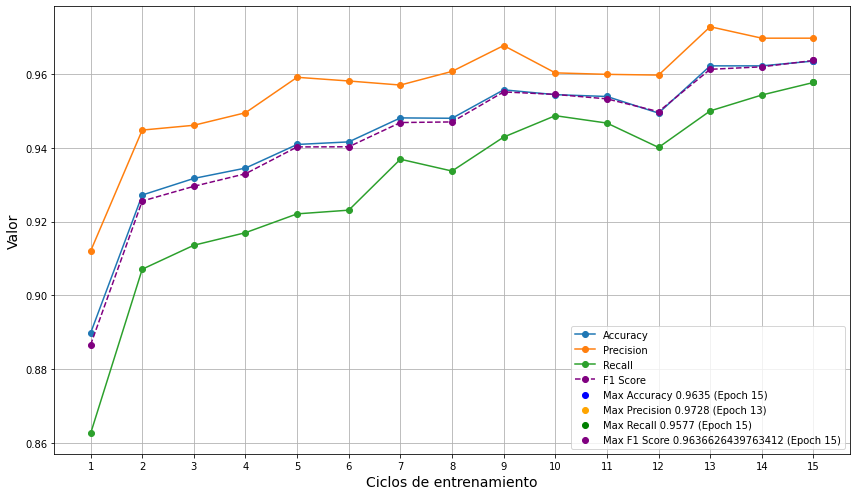

Highest Accuracy: 0.9635 at Epoch 15
Highest Precision: 0.9728 at Epoch 13
Highest Recall: 0.9577 at Epoch 15
Highest F1 Score: 0.9636626439763412 at Epoch 15


In [6]:
#Modelo 
epochs = np.arange(1, 16)
accuracy = [0.8898, 0.9272, 0.9317, 0.9345, 0.9409, 0.9416, 0.9481, 0.9480, 0.9557, 0.9544, 0.9539, 0.9494, 0.9622, 0.9622, 0.9635]
precision = [0.9120, 0.9448, 0.9461, 0.9495, 0.9591, 0.9581, 0.9570, 0.9607, 0.9677, 0.9603, 0.9599, 0.9597, 0.9728, 0.9697, 0.9697]
recall = [0.8626, 0.9071, 0.9136, 0.9170, 0.9221, 0.9231, 0.9369, 0.9337, 0.9429, 0.9487, 0.9467, 0.9401, 0.9500, 0.9543, 0.9577]

# Compute F1 score
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclos de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")


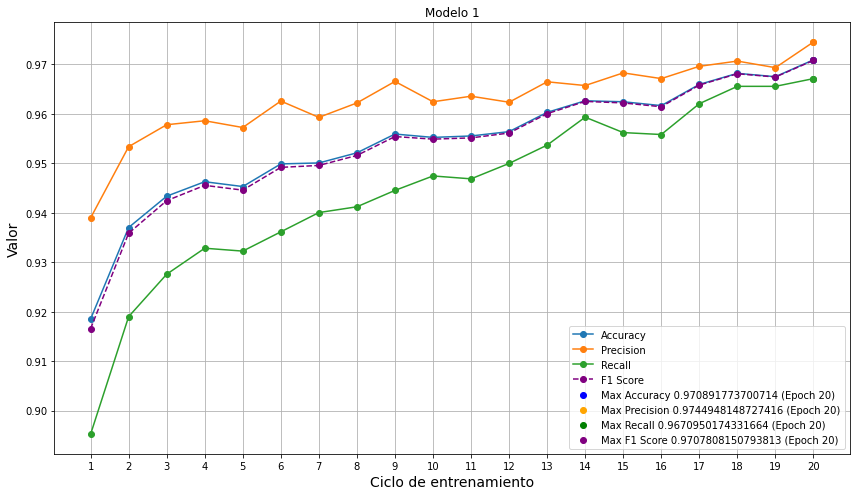

Highest Accuracy: 0.970891773700714 at Epoch 20
Highest Precision: 0.9744948148727416 at Epoch 20
Highest Recall: 0.9670950174331664 at Epoch 20
Highest F1 Score: 0.9707808150793813 at Epoch 20


In [12]:
#MODELO 1 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo1.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

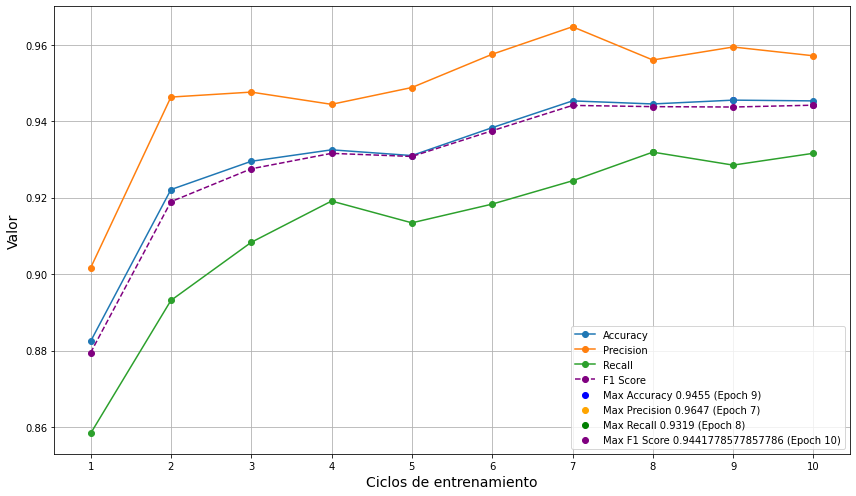

Highest Accuracy: 0.9455 at Epoch 9
Highest Precision: 0.9647 at Epoch 7
Highest Recall: 0.9319 at Epoch 8
Highest F1 Score: 0.9441778577857786 at Epoch 10


In [7]:
#MODELO 2
epochs = list(range(1, 11))  # Epochs 1 to 10

accuracy = [0.8824, 0.9221, 0.9295, 0.9325, 0.9310, 0.9383, 0.9453, 0.9445, 0.9455, 0.9453]
auc = [0.9418, 0.9721, 0.9779, 0.9805, 0.9797, 0.9833, 0.9847, 0.9868, 0.9860, 0.9870]
fn = [329.8696, 259.6397, 233.6801, 218.7609, 224.2795, 209.5435, 187.2888, 175.9845, 177.4006, 172.9317]
fp = [198.6211, 128.2764, 130.4845, 138.8634, 126.2360, 103.7453, 90.2857, 109.3385, 101.1087, 104.3571]
loss = [0.3316, 0.1991, 0.1777, 0.1718, 0.1741, 0.1563, 0.1445, 0.1373, 0.1437, 0.1390]
precision = [0.9016, 0.9463, 0.9476, 0.9444, 0.9488, 0.9575, 0.9647, 0.9560, 0.9594, 0.9571]
recall = [0.8583, 0.8931, 0.9083, 0.9191, 0.9134, 0.9183, 0.9244, 0.9319, 0.9285, 0.9316]
tn = [2397.5715, 2467.4067, 2456.2051, 2440.9006, 2429.2515, 2464.8508, 2493.6335, 2477.1086, 2509.8665, 2484.4380]
tp = [2241.8386, 2312.5776, 2347.5310, 2369.3757, 2388.1335, 2389.7610, 2396.6926, 2405.4690, 2379.5249, 2406.1738]
# Calculate the F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 2 (2nd Dense Layer)", fontsize=16)
plt.xlabel("Ciclos de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")



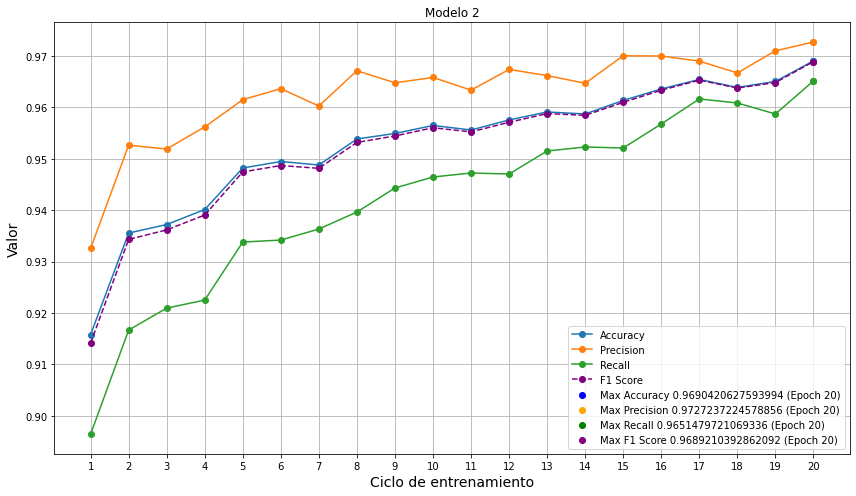

Highest Accuracy: 0.9690420627593994 at Epoch 20
Highest Precision: 0.9727237224578856 at Epoch 20
Highest Recall: 0.9651479721069336 at Epoch 20
Highest F1 Score: 0.9689210392862092 at Epoch 20


In [17]:
#MODELO 2 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo2.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 2")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

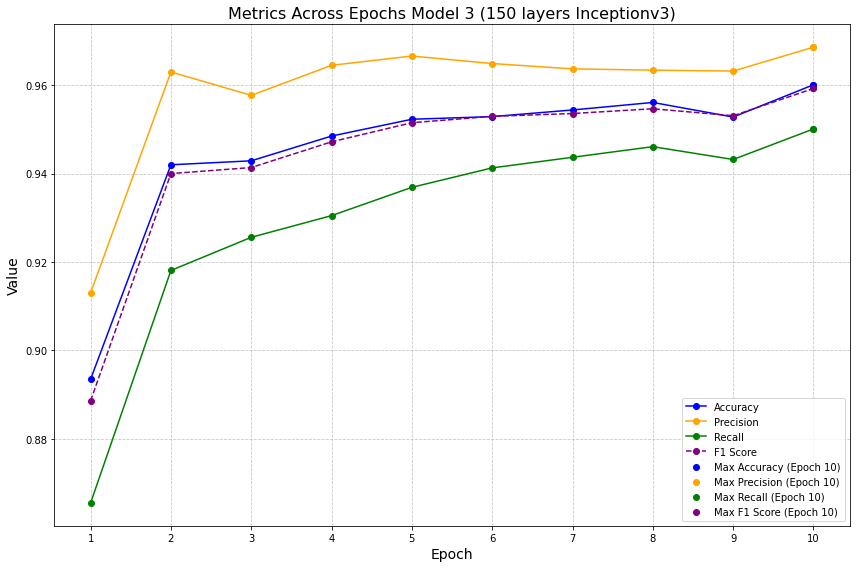

Highest Accuracy: 0.9601 at Epoch 10
Highest Precision: 0.9686 at Epoch 10
Highest Recall: 0.9501 at Epoch 10
Highest F1 Score: 0.9593 at Epoch 10


In [ ]:
#MODELO 3
epochs = range(1, 11)
accuracy = [0.8935, 0.9420, 0.9429, 0.9485, 0.9523, 0.9529, 0.9544, 0.9561, 0.9528, 0.9601]
precision = [0.9130, 0.9630, 0.9577, 0.9645, 0.9666, 0.9649, 0.9637, 0.9634, 0.9632, 0.9686]
recall = [0.8655, 0.9181, 0.9256, 0.9305, 0.9369, 0.9413, 0.9437, 0.9461, 0.9432, 0.9501]

# Calculate F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epochs with the highest values for each metric
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 8))
plt.plot(epochs, accuracy, label="Accuracy", marker='o', color='blue')
plt.plot(epochs, precision, label="Precision", marker='o', color='orange')
plt.plot(epochs, recall, label="Recall", marker='o', color='green')
plt.plot(epochs, f1_score, label="F1 Score", marker='o', linestyle='--', color='purple')

# Highlight the highest points
plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and grid
plt.title("Metrics Across Epochs Model 3 (150 layers Inceptionv3)", fontsize=16)
plt.xlabel("Epoch", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

# Print the epochs with the highest values
print(f"Highest Accuracy: {max(accuracy):.4f} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision):.4f} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall):.4f} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score):.4f} at Epoch {max_f1_epoch}")


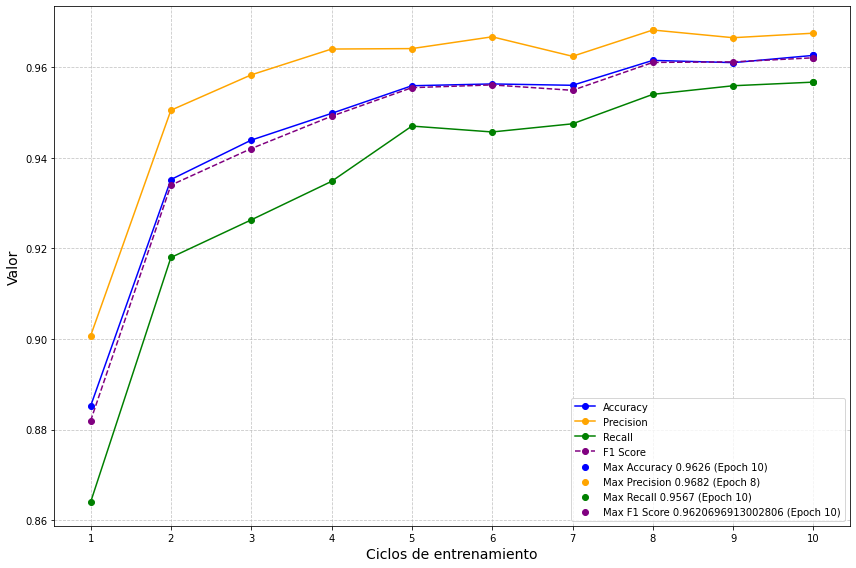

Highest Accuracy: 0.9626 at Epoch 10
Highest Precision: 0.9682 at Epoch 8
Highest Recall: 0.9567 at Epoch 10
Highest F1 Score: 0.9621 at Epoch 10


In [8]:
#MODELO 3 MUESTRA DE ENTRENAMIENTO CORREGIDO
epochs = list(range(1, 11))  # Epochs 1 to 10

accuracy = [0.8852, 0.9352, 0.9439, 0.9498, 0.9559, 0.9563, 0.9560, 0.9615, 0.9610, 0.9626]
auc = [0.9471, 0.9785, 0.9834, 0.9867, 0.9904, 0.9915, 0.9920, 0.9932, 0.9944, 0.9946]
fn = [295.9969, 207.6584, 182.9503, 167.9099, 144.1087, 145.8975, 130.2205, 116.7205, 114.1025, 110.5870]
fp = [201.0186, 124.4969, 97.6056, 96.5217, 94.0093, 86.2888, 91.6180, 81.6087, 79.8323, 82.8230]
loss = [0.3066, 0.1749, 0.1529, 0.1348, 0.1171, 0.1117, 0.1069, 0.0990, 0.0926, 0.0888]
precision = [0.9007, 0.9505, 0.9583, 0.9640, 0.9641, 0.9667, 0.9624, 0.9682, 0.9665, 0.9675]
recall = [0.8640, 0.9180, 0.9263, 0.9348, 0.9470, 0.9457, 0.9475, 0.9540, 0.9559, 0.9567]
tn = [2405.1895, 2449.5374, 2501.1646, 2481.3416, 2500.0249, 2484.9534, 2506.8167, 2498.6492, 2498.6709, 2524.5466]
tp = [2265.6956, 2386.2080, 2386.1802, 2422.1274, 2429.7578, 2450.7610, 2439.2454, 2470.9224, 2475.2949, 2449.9441]


# Calculate F1 score for each epoch
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epochs with the highest values for each metric
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 8))
plt.plot(epochs, accuracy, label="Accuracy", marker='o', color='blue')
plt.plot(epochs, precision, label="Precision", marker='o', color='orange')
plt.plot(epochs, recall, label="Recall", marker='o', color='green')
plt.plot(epochs, f1_score, label="F1 Score", marker='o', linestyle='--', color='purple')

# Highlight the highest points
plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and grid
#plt.title("Metrics Across Epochs Model 3 (150 layers Inceptionv3) (NEW TRAINING SET)", fontsize=16)
plt.xlabel("Ciclos de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.xticks(epochs)
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

# Print the epochs with the highest values
print(f"Highest Accuracy: {max(accuracy):.4f} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision):.4f} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall):.4f} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score):.4f} at Epoch {max_f1_epoch}")


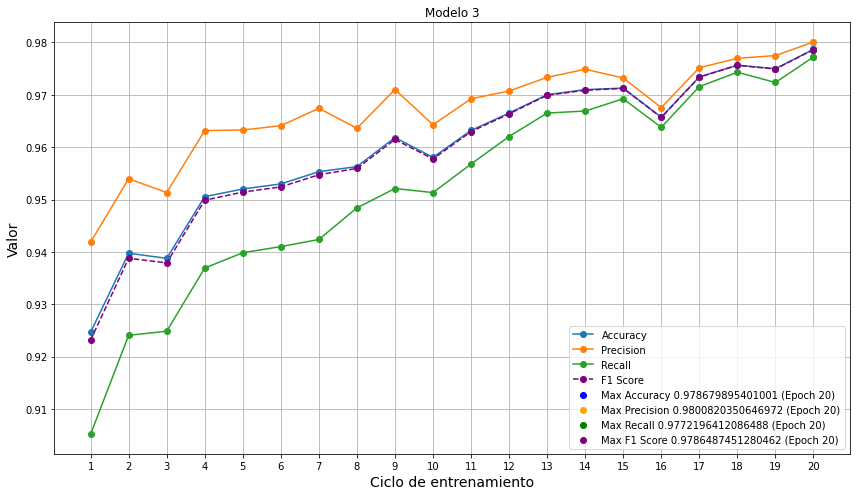

Highest Accuracy: 0.978679895401001 at Epoch 20
Highest Precision: 0.9800820350646972 at Epoch 20
Highest Recall: 0.9772196412086488 at Epoch 20
Highest F1 Score: 0.9786487451280462 at Epoch 20


In [3]:
#MODELO 3 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

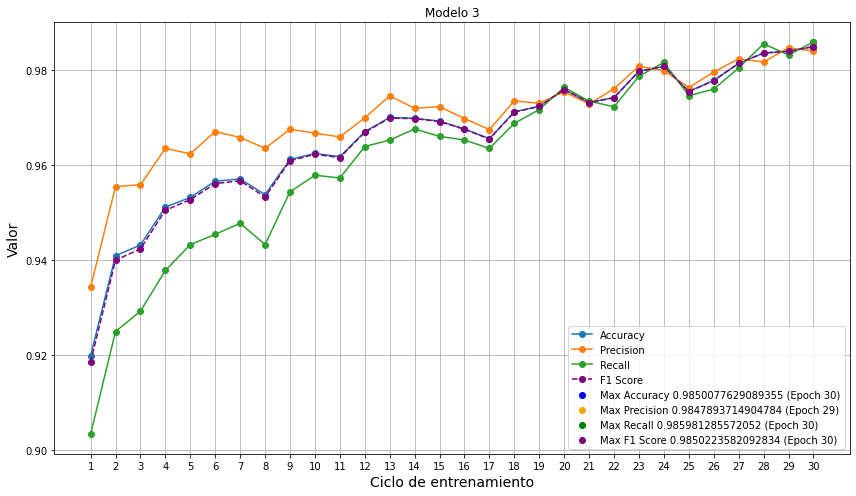

Highest Accuracy: 0.9850077629089355 at Epoch 30
Highest Precision: 0.9847893714904784 at Epoch 29
Highest Recall: 0.985981285572052 at Epoch 30
Highest F1 Score: 0.9850223582092834 at Epoch 30


In [3]:
#MODELO 3 CLUSTER
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_30ciclos.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

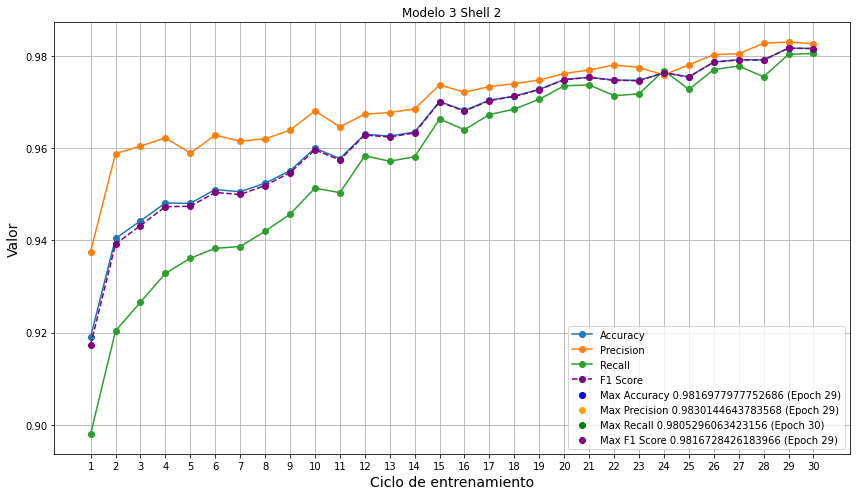

Highest Accuracy: 0.9816977977752686 at Epoch 29
Highest Precision: 0.9830144643783568 at Epoch 29
Highest Recall: 0.9805296063423156 at Epoch 30
Highest F1 Score: 0.9816728426183966 at Epoch 29


In [3]:
#MODELO 3 CLUSTER SHELL 2
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_30ciclos_shell2.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Shell 2")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

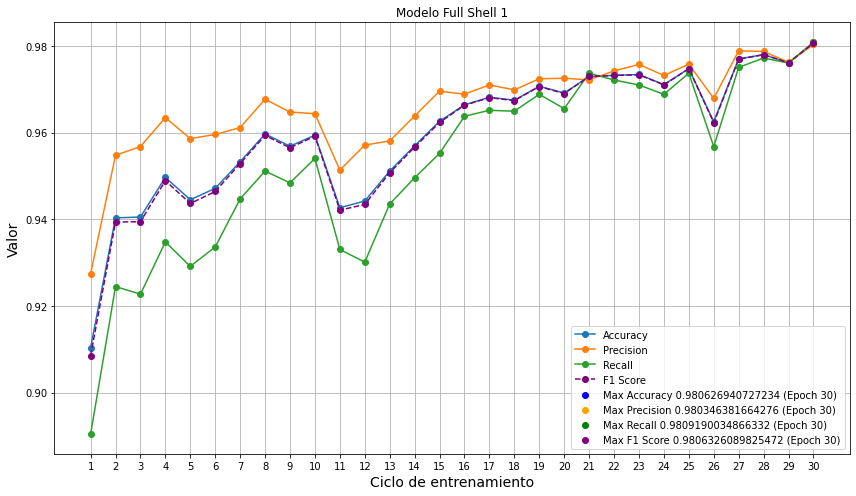

Highest Accuracy: 0.980626940727234 at Epoch 30
Highest Precision: 0.980346381664276 at Epoch 30
Highest Recall: 0.9809190034866332 at Epoch 30
Highest F1 Score: 0.9806326089825472 at Epoch 30


In [3]:
#MODELO FULL CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modeloFull.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo Full Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

### Modelos Convergentes (Diferencia)

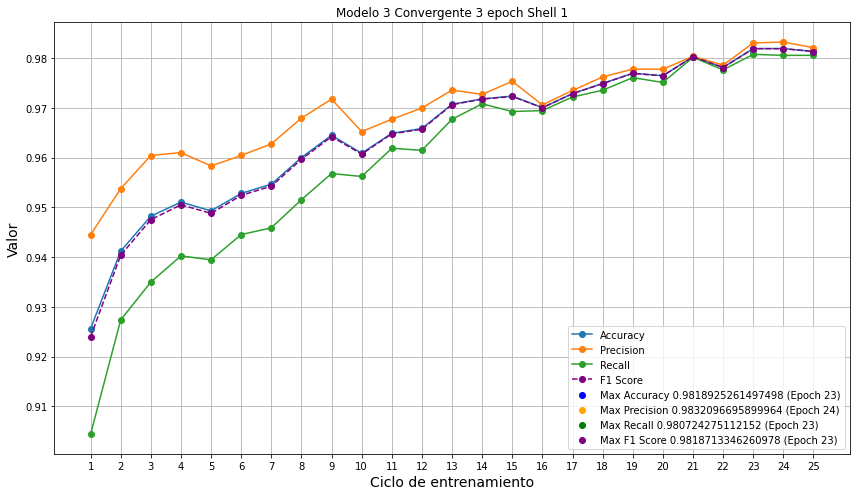

Highest Accuracy: 0.9818925261497498 at Epoch 23
Highest Precision: 0.9832096695899964 at Epoch 24
Highest Recall: 0.980724275112152 at Epoch 23
Highest F1 Score: 0.9818713346260978 at Epoch 23


In [ ]:
#MODELO 3 CONVERGENTE 3 0.001 EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_convergente150.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Convergente 3 epoch Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

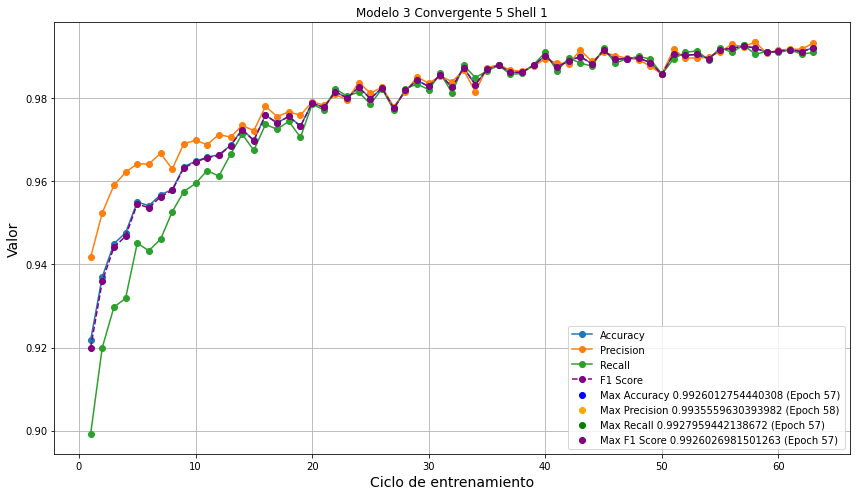

Highest Accuracy: 0.9926012754440308 at Epoch 57
Highest Precision: 0.9935559630393982 at Epoch 58
Highest Recall: 0.9927959442138672 at Epoch 57
Highest F1 Score: 0.9926026981501263 at Epoch 57


In [ ]:
#MODELO 3 CONVERGENTE 5 EPOCHS (0.001) CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Convergente 5 Shell 1")
#plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

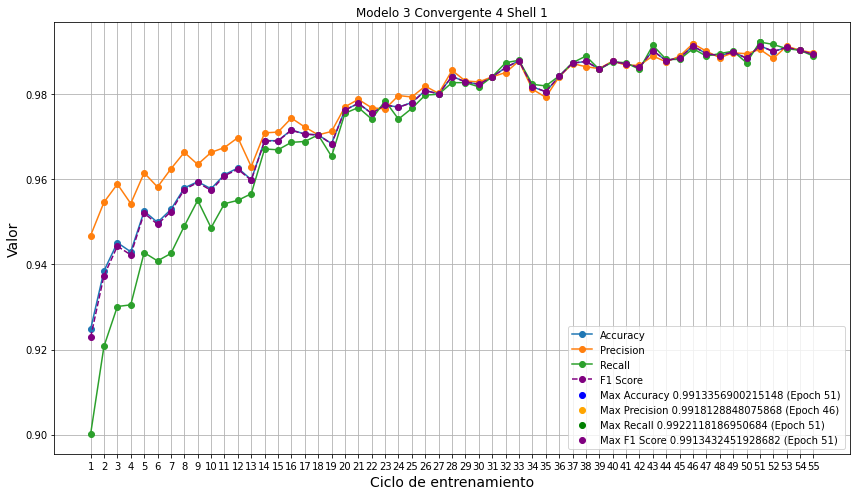

Highest Accuracy: 0.9913356900215148 at Epoch 51
Highest Precision: 0.9918128848075868 at Epoch 46
Highest Recall: 0.9922118186950684 at Epoch 51
Highest F1 Score: 0.9913432451928682 at Epoch 51


In [ ]:
#MODELO 3 CONVERGENTE 4 (0.001) EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo3_convergente4.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 3 Convergente 4 Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

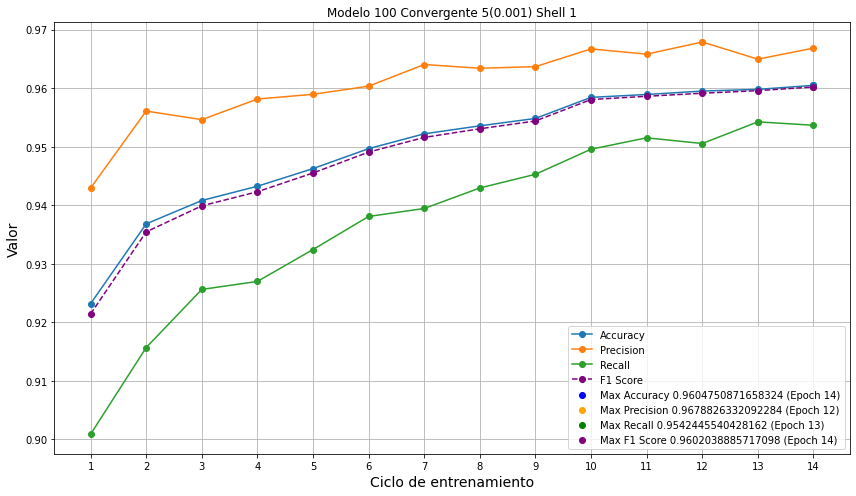

Highest Accuracy: 0.9604750871658324 at Epoch 14
Highest Precision: 0.9678826332092284 at Epoch 12
Highest Recall: 0.9542445540428162 at Epoch 13
Highest F1 Score: 0.9602038885717098 at Epoch 14


In [16]:
#MODELO 100 CONVERGENTE 5 (0.001) EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo100_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 100 Convergente 5(0.001) Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

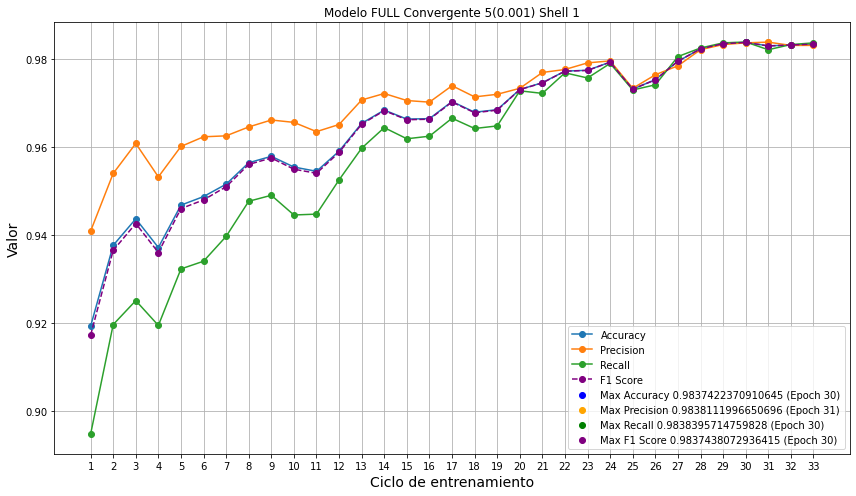

Highest Accuracy: 0.9837422370910645 at Epoch 30
Highest Precision: 0.9838111996650696 at Epoch 31
Highest Recall: 0.9838395714759828 at Epoch 30
Highest F1 Score: 0.9837438072936415 at Epoch 30


In [17]:
#MODELO FULL CONVERGENTE 5 (0.001) EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modeloFull_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo FULL Convergente 5(0.001) Shell 1")
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

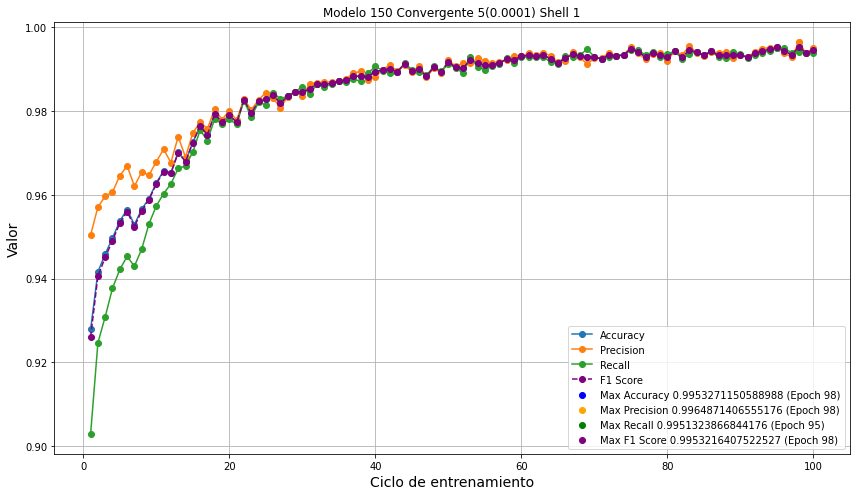

Highest Accuracy: 0.9953271150588988 at Epoch 98
Highest Precision: 0.9964871406555176 at Epoch 98
Highest Recall: 0.9951323866844176 at Epoch 95
Highest F1 Score: 0.9953216407522527 at Epoch 98


In [89]:
#MODELO 3 CONVERGENTE 5 (0.0001) EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_00001_convergente5.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1")
#plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

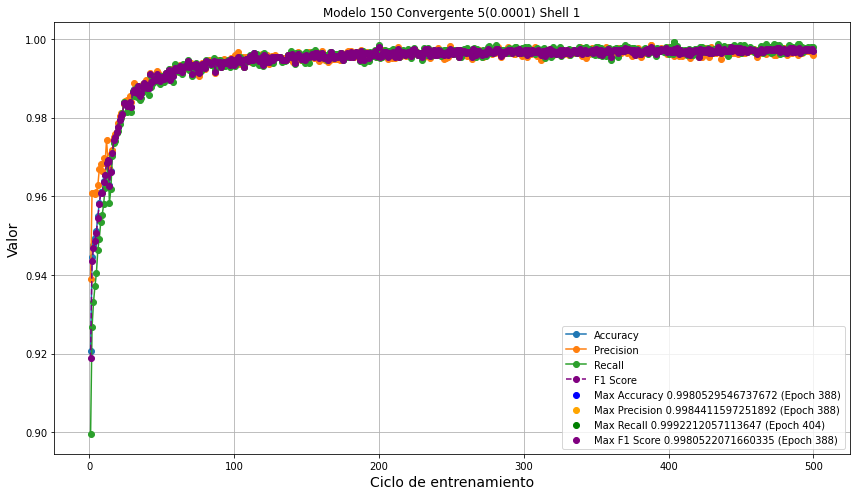

Highest Accuracy: 0.9980529546737672 at Epoch 388
Highest Precision: 0.9984411597251892 at Epoch 388
Highest Recall: 0.9992212057113647 at Epoch 404
Highest F1 Score: 0.9980522071660335 at Epoch 388


In [4]:
#MODELO 150 CONVERGENTE 5 (0.0001) 500 EPOCHS CLUSTER SHELL 1
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_00001_convergente5LIMITE500.txt"
metrica=pd.read_csv(metrica_direccion)
epochs=list(metrica["Epoch"])
accuracy=list(metrica["accuracy"])
precision=list(metrica["precision"])
recall=list(metrica["recall"])
f1_score = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision, recall)]

# Find the epoch with the highest F1 score
max_f1_epoch = f1_score.index(max(f1_score)) + 1

# Plot the metrics
plt.figure(figsize=(12, 7))
plt.plot(epochs, accuracy, label='Accuracy', marker='o')
plt.plot(epochs, precision, label='Precision', marker='o')
plt.plot(epochs, recall, label='Recall', marker='o')
plt.plot(epochs, f1_score, label='F1 Score', marker='o', linestyle='--', color='purple')

# Highlight the highest points
max_acc_epoch = accuracy.index(max(accuracy)) + 1
max_prec_epoch = precision.index(max(precision)) + 1
max_recall_epoch = recall.index(max(recall)) + 1

plt.scatter(max_acc_epoch, max(accuracy), color='blue', label=f"Max Accuracy {max(accuracy)} (Epoch {max_acc_epoch})")
plt.scatter(max_prec_epoch, max(precision), color='orange', label=f"Max Precision {max(precision)} (Epoch {max_prec_epoch})")
plt.scatter(max_recall_epoch, max(recall), color='green', label=f"Max Recall {max(recall)} (Epoch {max_recall_epoch})")
plt.scatter(max_f1_epoch, max(f1_score), color='purple', label=f"Max F1 Score {max(f1_score)} (Epoch {max_f1_epoch})")

# Add labels, legend, and title
#plt.title("Metrics Across Epochs for Model 1 (No second Dense Layer, 100 Layers)", fontsize=16)
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1")
#plt.xticks(epochs)
#plt.xscale("log")
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.xscale("log")
# Show the plot
plt.show()

# Print the highest values and their epochs
print(f"Highest Accuracy: {max(accuracy)} at Epoch {max_acc_epoch}")
print(f"Highest Precision: {max(precision)} at Epoch {max_prec_epoch}")
print(f"Highest Recall: {max(recall)} at Epoch {max_recall_epoch}")
print(f"Highest F1 Score: {max(f1_score)} at Epoch {max_f1_epoch}")

### Modelos Convergentes (Diferencias y Derivadas)

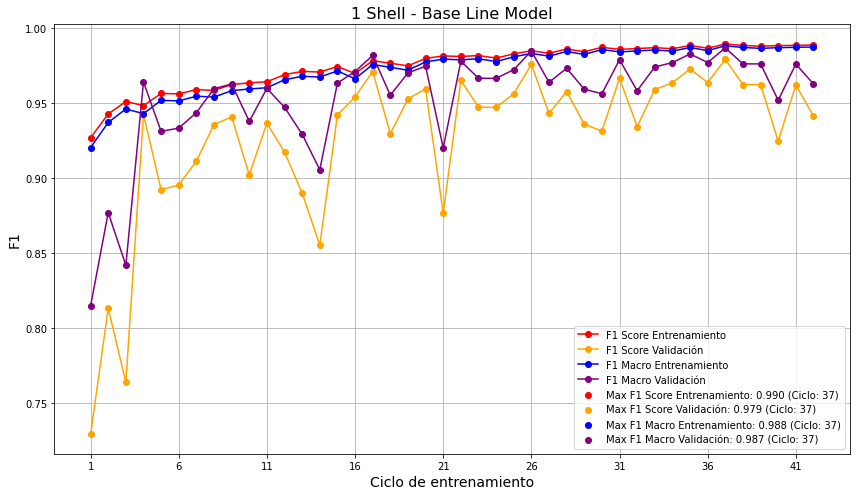

Highest F1 Score (Training): 0.9896 at Epoch 36
Highest F1 Score (Validation): 0.9793 at Epoch 36
Highest F1 Macro (Training): 0.9884 at Epoch 36
Highest F1 Macro (Validation): 0.9870 at Epoch 36


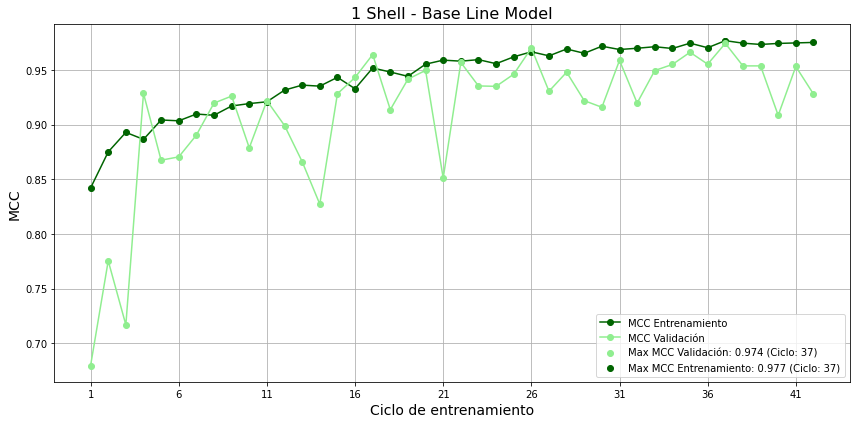

Highest MCC Training: 0.9768 at Epoch 36
Highest MCC Validation: 0.9744 at Epoch 36


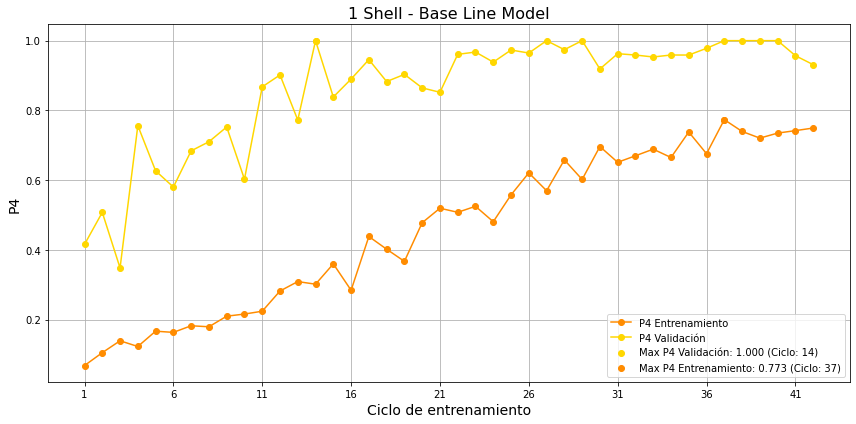

Highest P4 Training: 0.7735 at Epoch 36
Highest P4 Validation: 1.0000 at Epoch 13


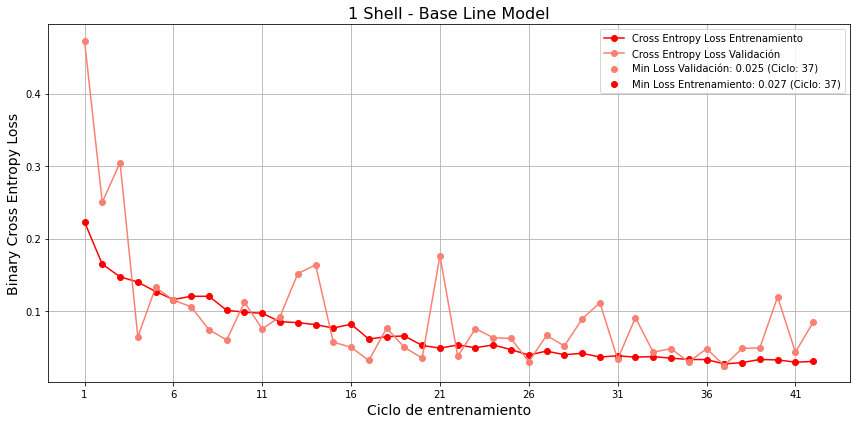

Lowest Loss Training: 0.0271 at Epoch 36
Lowest Loss Validation: 0.0248 at Epoch 36


In [16]:
#MODELO LAXO SHELL 1
#MODELO 150 CONVERGENTE 5 (Derivada + Diferencias de F1 Score y F1 Macro) + Validation Set SHELL 1
#Hiperparametros
#Batch Size=32
#Capas Inception= 150
#F1 Score and Macro Stability: 5 Diferencias: 0.001, Derivadas: 0.000005
#Condiciones minimas: 2
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_F1ScoreDerivate5OTRO.txt"

metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=5
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("1 Shell - Base Line Model", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("1 Shell - Base Line Model", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("1 Shell - Base Line Model", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("1 Shell - Base Line Model", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")

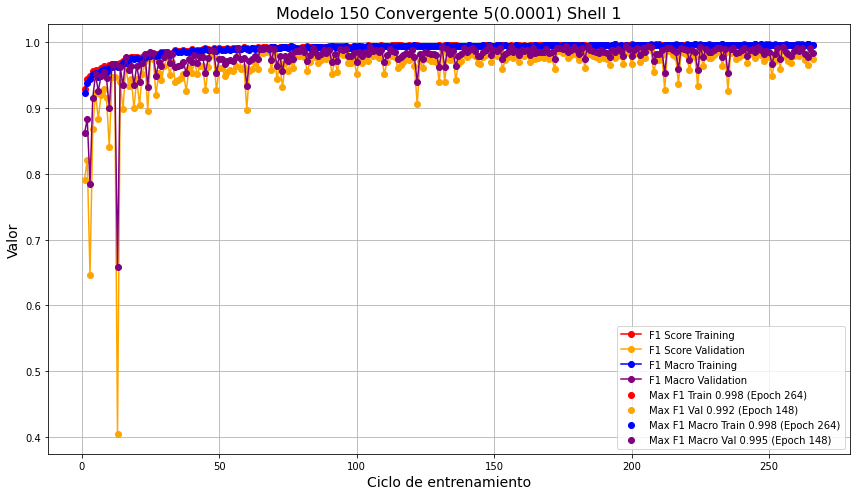

Highest F1 Score (Training): 0.9978 at Epoch 264
Highest F1 Score (Validation): 0.9919 at Epoch 148
Highest F1 Macro (Training): 0.9976 at Epoch 264
Highest F1 Macro (Validation): 0.9949 at Epoch 148


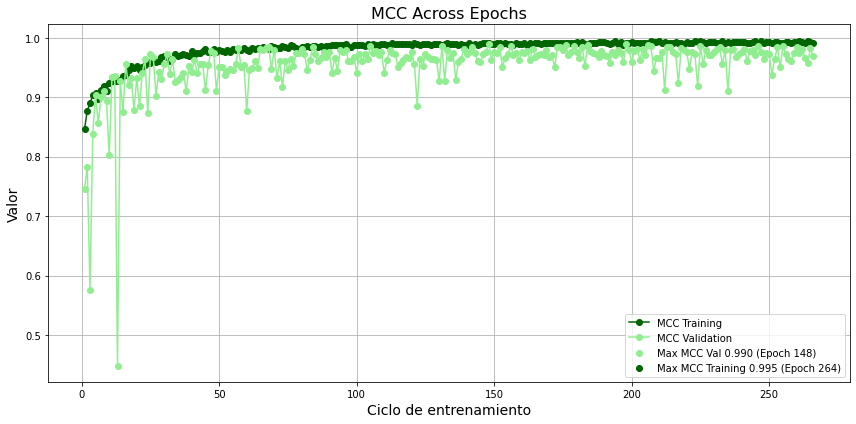

Highest MCC Training: 0.9951 at Epoch 264
Highest MCC Validation: 0.9899 at Epoch 148


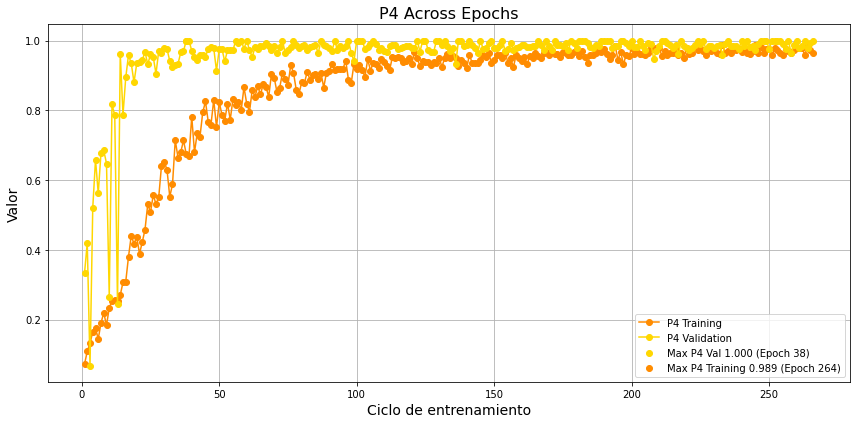

Highest P4 Training: 0.9887 at Epoch 264
Highest P4 Validation: 1.0000 at Epoch 38


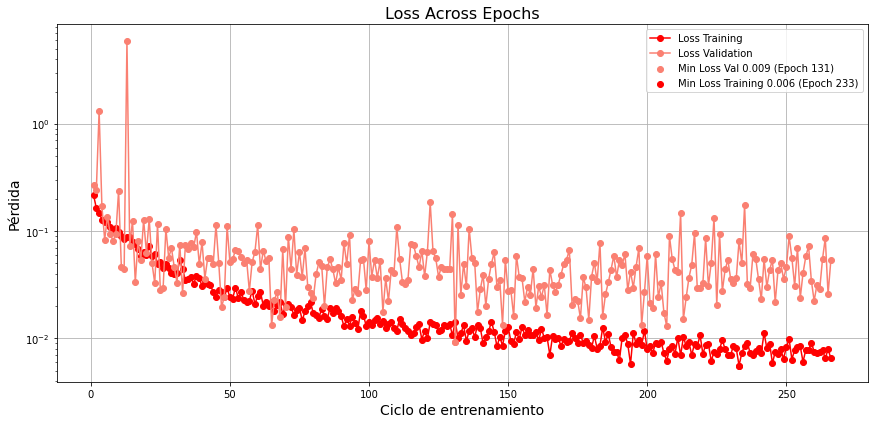

Lowest Loss Training: 0.0056 at Epoch 233
Lowest Loss Validation: 0.0092 at Epoch 131


In [2]:
#MODELO 150 CONVERGENTE 5 (Derivada + Diferencias de F1 Score y F1 Macro) + Validation Set SHELL 1
#Hiperparametros
#Batch Size=32
#Capas Inception= 150
#F1 Score and Macro Stability: 5 Diferencias: 0.0001, Derivadas: 0.00005
#Condiciones minimas: 2
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_F1ScoreDerivate5OTROESTRICTO.txt"
metrica=pd.read_csv(metrica_direccion)
#print(metrica.tail(1))
metrica = metrica.drop(metrica.index[-1])
epochs=list(metrica["Epoch"])
#Training Dataset
accuracy_training=list(metrica["accuracy"])
precision_training=list(metrica["precision"])
recall_training=list(metrica["recall"])
loss_training=list(metrica["loss"])
P4_training=list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training=list(metrica["F1_score"])
F1_MACRO_training=list(metrica["F1_macro"])

#Validation Set
accuracy_validation=list(metrica["val_accuracy"])
precision_validation=list(metrica["val_precision"])
recall_validation=list(metrica["val_recall"])
loss_validation=list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp=list(metrica["val_tp"])
tn=list(metrica["val_tn"])
fp=list(metrica["val_fp"])
fn=list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn,fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn,fp)]
F1_neg=[2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation=[(pos+neg)/2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation= [(4* tp* tn)/(4* tp* tn + (tp+tn) * (fp*fn)) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]
MCC_validation=[(tp * tn - fp * fn)/(tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]

# Plot the F1
plt.figure(figsize=(12, 7))

# Plot the F1 metrics
plt.plot(epochs, F1_score_training, label='F1 Score Training', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validation', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Training', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validation', marker='o', color='purple')

# Find max values and epochs
max_f1_epoch = F1_score_training.index(max(F1_score_training)) + 1
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation)) + 1
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training)) + 1
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation)) + 1

# Highlight maxima
plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Train {max(F1_score_training):.3f} (Epoch {max_f1_epoch})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Val {max(F1_score_validation):.3f} (Epoch {max_f1_val_epoch})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Train {max(F1_MACRO_training):.3f} (Epoch {max_f1_macro_epoch})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Val {max(F1_MACRO_validation):.3f} (Epoch {max_f1_macro_val_epoch})")

# Labels, title, legend
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
# plt.xscale("log") # Optional

# Show plot
plt.show()

# Print summary
print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")


# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) + 1
max_mcc_training_epoch=MCC_training.index(max(MCC_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Training', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validation', marker='o', color='lightgreen')

plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Val {max(MCC_validation):.3f} (Epoch {max_mcc_val_epoch})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Training {max(MCC_training):.3f} (Epoch {max_mcc_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("MCC Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")
# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))+1
max_p4_training_epoch = P4_training.index(max(P4_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Training', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validation', marker='o', color='gold')

plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold',
            label=f"Max P4 Val {max(P4_validation):.3f} (Epoch {max_p4_val_epoch})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange',
            label=f"Max P4 Training {max(P4_training):.3f} (Epoch {max_p4_training_epoch})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("P4 Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) +1
min_loss_training_epoch = loss_training.index(min(loss_training)) +1
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Loss Training', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Loss Validation', marker='o', color='salmon')

plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon',
            label=f"Min Loss Val {min(loss_validation):.3f} (Epoch {min_loss_val_epoch})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red',
            label=f"Min Loss Training {min(loss_training):.3f} (Epoch {min_loss_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Pérdida", fontsize=14)
plt.title("Loss Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")

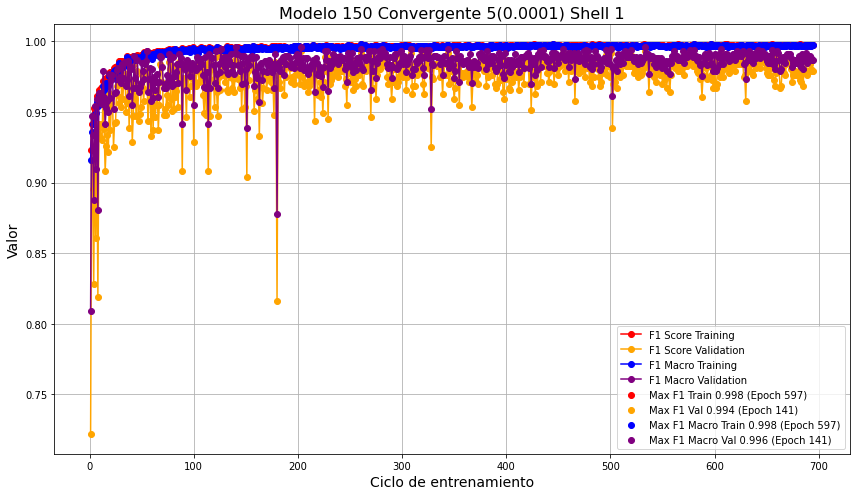

Highest F1 Score (Training): 0.9982 at Epoch 597
Highest F1 Score (Validation): 0.9935 at Epoch 141
Highest F1 Macro (Training): 0.9980 at Epoch 597
Highest F1 Macro (Validation): 0.9959 at Epoch 141


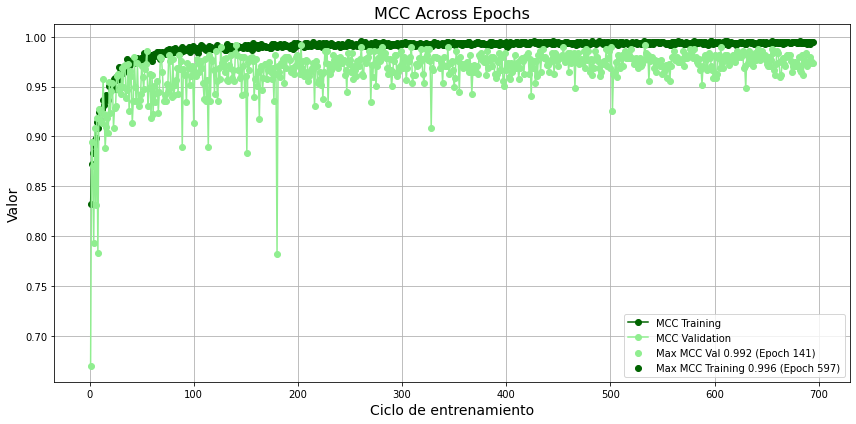

Highest MCC Training: 0.9961 at Epoch 597
Highest MCC Validation: 0.9919 at Epoch 141


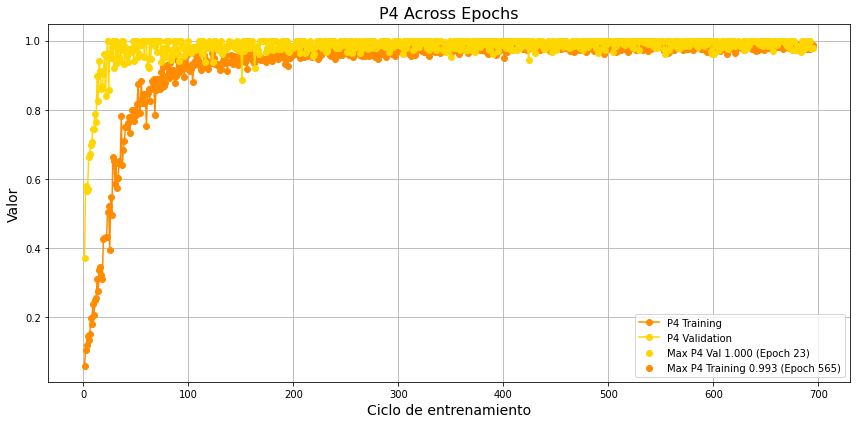

Highest P4 Training: 0.9931 at Epoch 565
Highest P4 Validation: 1.0000 at Epoch 23


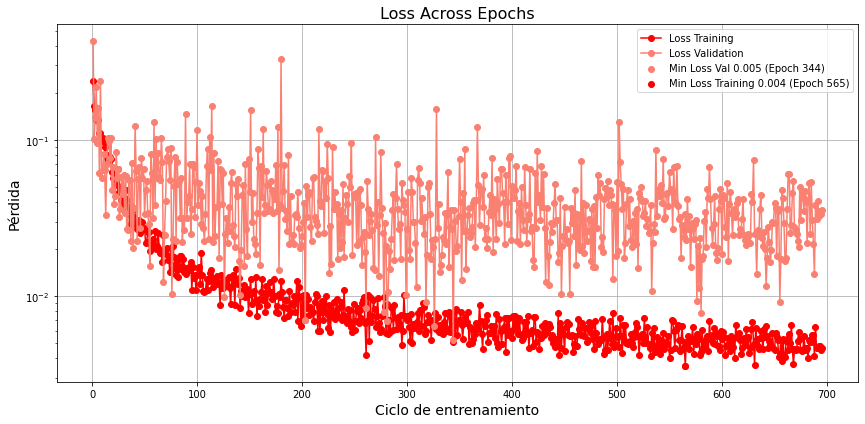

Lowest Loss Training: 0.0036 at Epoch 565
Lowest Loss Validation: 0.0052 at Epoch 344


In [4]:
#MODELO 150 CONVERGENTE 5 (Derivada + Diferencias de F1 Score y F1 Macro) + Validation Set SHELL 1
#Hiperparametros
#Batch Size=32
#Capas Inception= 150
#Neuronas densas=1024
#F1 Score and Macro Stability: 5 Diferencias: 0.001, Derivadas: 0.000005
#Condiciones minimas: 3

metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo150_F1ScoreDerivate5OTRO_ULTRA_ESTRICTO.txt"
metrica=pd.read_csv(metrica_direccion)
#print(metrica.tail(1))
metrica = metrica.drop(metrica.index[-1])
epochs=list(metrica["Epoch"])
#Training Dataset
accuracy_training=list(metrica["accuracy"])
precision_training=list(metrica["precision"])
recall_training=list(metrica["recall"])
loss_training=list(metrica["loss"])
P4_training=list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training=list(metrica["F1_score"])
F1_MACRO_training=list(metrica["F1_macro"])

#Validation Set
accuracy_validation=list(metrica["val_accuracy"])
precision_validation=list(metrica["val_precision"])
recall_validation=list(metrica["val_recall"])
loss_validation=list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp=list(metrica["val_tp"])
tn=list(metrica["val_tn"])
fp=list(metrica["val_fp"])
fn=list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn,fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn,fp)]
F1_neg=[2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation=[(pos+neg)/2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation= [(4* tp* tn)/(4* tp* tn + (tp+tn) * (fp*fn)) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]
MCC_validation=[(tp * tn - fp * fn)/(tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]

# Plot the F1
plt.figure(figsize=(12, 7))

# Plot the F1 metrics
plt.plot(epochs, F1_score_training, label='F1 Score Training', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validation', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Training', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validation', marker='o', color='purple')

# Find max values and epochs
max_f1_epoch = F1_score_training.index(max(F1_score_training)) + 1
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation)) + 1
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training)) + 1
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation)) + 1

# Highlight maxima
plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Train {max(F1_score_training):.3f} (Epoch {max_f1_epoch})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Val {max(F1_score_validation):.3f} (Epoch {max_f1_val_epoch})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Train {max(F1_MACRO_training):.3f} (Epoch {max_f1_macro_epoch})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Val {max(F1_MACRO_validation):.3f} (Epoch {max_f1_macro_val_epoch})")

# Labels, title, legend
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
# plt.xscale("log") # Optional

# Show plot
plt.show()

# Print summary
print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")


# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) + 1
max_mcc_training_epoch=MCC_training.index(max(MCC_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Training', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validation', marker='o', color='lightgreen')

plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Val {max(MCC_validation):.3f} (Epoch {max_mcc_val_epoch})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Training {max(MCC_training):.3f} (Epoch {max_mcc_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("MCC Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")
# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))+1
max_p4_training_epoch = P4_training.index(max(P4_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Training', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validation', marker='o', color='gold')

plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold',
            label=f"Max P4 Val {max(P4_validation):.3f} (Epoch {max_p4_val_epoch})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange',
            label=f"Max P4 Training {max(P4_training):.3f} (Epoch {max_p4_training_epoch})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("P4 Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) +1
min_loss_training_epoch = loss_training.index(min(loss_training)) +1
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Loss Training', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Loss Validation', marker='o', color='salmon')

plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon',
            label=f"Min Loss Val {min(loss_validation):.3f} (Epoch {min_loss_val_epoch})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red',
            label=f"Min Loss Training {min(loss_training):.3f} (Epoch {min_loss_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Pérdida", fontsize=14)
plt.title("Loss Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")

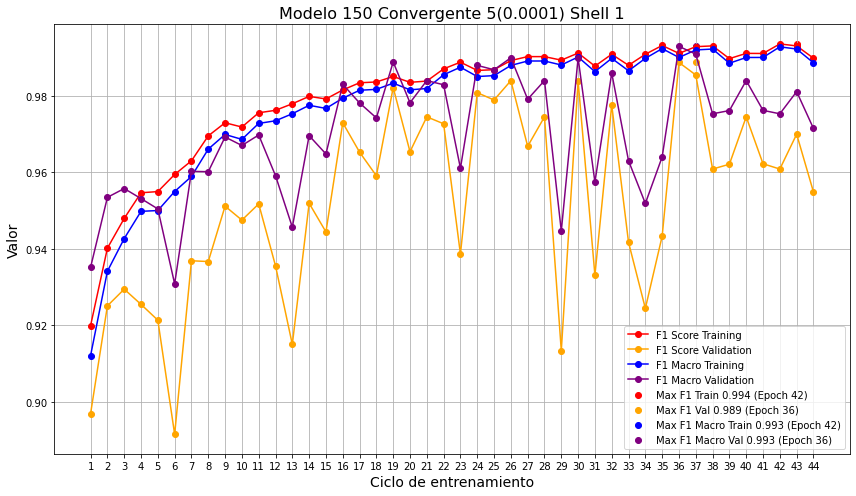

Highest F1 Score (Training): 0.9936 at Epoch 42
Highest F1 Score (Validation): 0.9887 at Epoch 36
Highest F1 Macro (Training): 0.9928 at Epoch 42
Highest F1 Macro (Validation): 0.9929 at Epoch 36


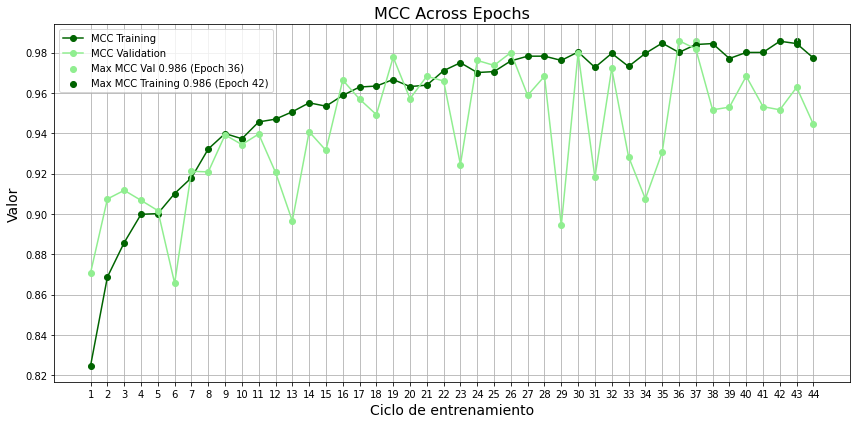

Highest MCC Training: 0.9856 at Epoch 42
Highest MCC Validation: 0.9859 at Epoch 36


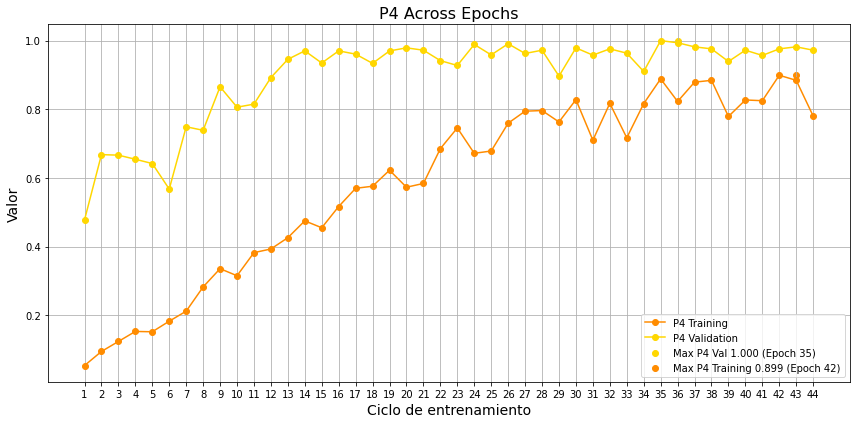

Highest P4 Training: 0.8992 at Epoch 42
Highest P4 Validation: 1.0000 at Epoch 35


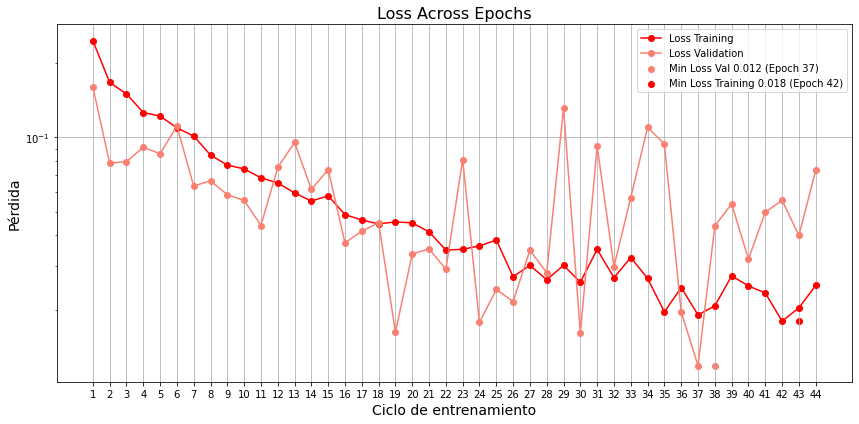

Lowest Loss Training: 0.0180 at Epoch 42
Lowest Loss Validation: 0.0119 at Epoch 37


In [8]:
#MODELO CONVERGENTE 5 (Derivada + Diferencias de F1 Score y F1 Macro) + Validation Set SHELL 1
#Hiperparametros
#learning rate= 0.00010996514580098046
#Batch Size=64
#Capas Inception= 135
#Neuronas densas=1920
#'f1_diff_thresh': 0.00018478447063416316, 'f1_macro_diff_thresh': 0.0005323241399583822, 'f1_deriv_thresh': 7.880603619160596e-05, 'f1_macro_deriv_thresh': 7.282653071154631e-05.
#Condiciones minimas: 1

metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo135_F1ScoreOPTI.txt"
metrica=pd.read_csv(metrica_direccion)
#print(metrica.tail(1))
metrica = metrica.drop(metrica.index[-1])
epochs=list(metrica["Epoch"])
#Training Dataset
accuracy_training=list(metrica["accuracy"])
precision_training=list(metrica["precision"])
recall_training=list(metrica["recall"])
loss_training=list(metrica["loss"])
P4_training=list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training=list(metrica["F1_score"])
F1_MACRO_training=list(metrica["F1_macro"])

#Validation Set
accuracy_validation=list(metrica["val_accuracy"])
precision_validation=list(metrica["val_precision"])
recall_validation=list(metrica["val_recall"])
loss_validation=list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp=list(metrica["val_tp"])
tn=list(metrica["val_tn"])
fp=list(metrica["val_fp"])
fn=list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn,fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn,fp)]
F1_neg=[2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation=[(pos+neg)/2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation= [(4* tp* tn)/(4* tp* tn + (tp+tn) * (fp*fn)) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]
MCC_validation=[(tp * tn - fp * fn)/(tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]

# Plot the F1
plt.figure(figsize=(12, 7))

# Plot the F1 metrics
plt.plot(epochs, F1_score_training, label='F1 Score Training', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validation', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Training', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validation', marker='o', color='purple')

# Find max values and epochs
max_f1_epoch = F1_score_training.index(max(F1_score_training)) + 1
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation)) + 1
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training)) + 1
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation)) + 1

# Highlight maxima
plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Train {max(F1_score_training):.3f} (Epoch {max_f1_epoch})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Val {max(F1_score_validation):.3f} (Epoch {max_f1_val_epoch})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Train {max(F1_MACRO_training):.3f} (Epoch {max_f1_macro_epoch})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Val {max(F1_MACRO_validation):.3f} (Epoch {max_f1_macro_val_epoch})")

# Labels, title, legend
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 150 Convergente 5(0.0001) Shell 1", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
# plt.xscale("log") # Optional

# Show plot
plt.show()

# Print summary
print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")


# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) + 1
max_mcc_training_epoch=MCC_training.index(max(MCC_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Training', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validation', marker='o', color='lightgreen')

plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Val {max(MCC_validation):.3f} (Epoch {max_mcc_val_epoch})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Training {max(MCC_training):.3f} (Epoch {max_mcc_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("MCC Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")
# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))+1
max_p4_training_epoch = P4_training.index(max(P4_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Training', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validation', marker='o', color='gold')

plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold',
            label=f"Max P4 Val {max(P4_validation):.3f} (Epoch {max_p4_val_epoch})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange',
            label=f"Max P4 Training {max(P4_training):.3f} (Epoch {max_p4_training_epoch})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("P4 Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) +1
min_loss_training_epoch = loss_training.index(min(loss_training)) +1
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Loss Training', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Loss Validation', marker='o', color='salmon')

plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon',
            label=f"Min Loss Val {min(loss_validation):.3f} (Epoch {min_loss_val_epoch})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red',
            label=f"Min Loss Training {min(loss_training):.3f} (Epoch {min_loss_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Pérdida", fontsize=14)
plt.title("Loss Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")


### Modelos Optimizado Optuna FINALES

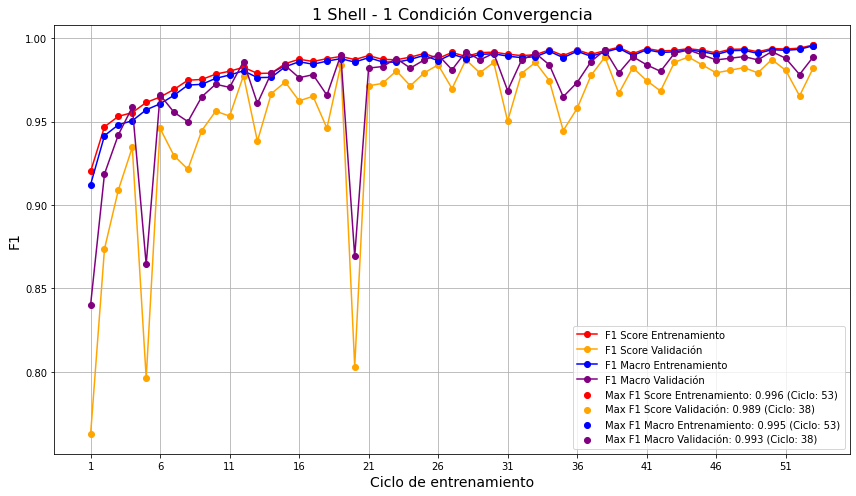

Highest F1 Score (Training): 0.9960 at Epoch 52
Highest F1 Score (Validation): 0.9887 at Epoch 37
Highest F1 Macro (Training): 0.9955 at Epoch 52
Highest F1 Macro (Validation): 0.9929 at Epoch 37


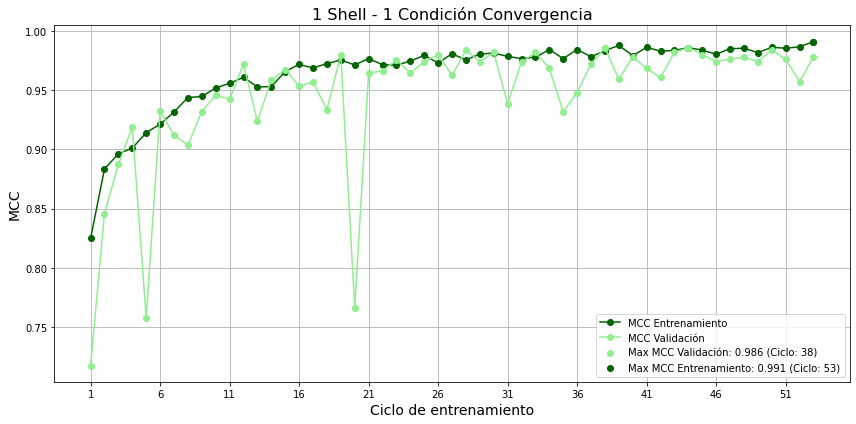

Highest MCC Training: 0.9910 at Epoch 52
Highest MCC Validation: 0.9859 at Epoch 37


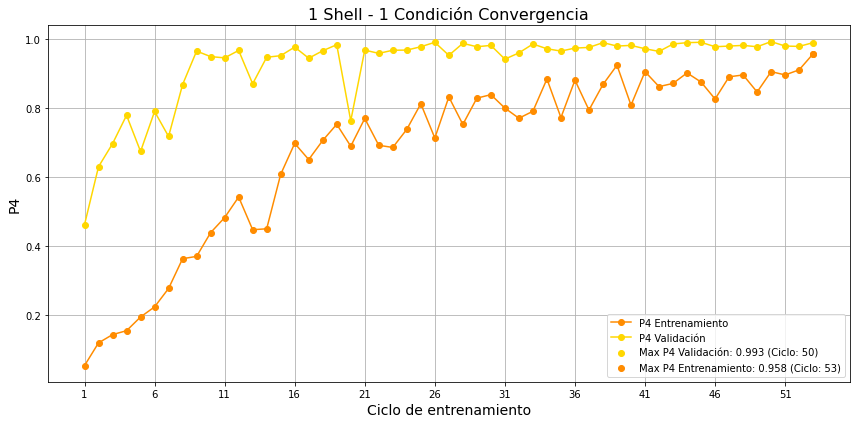

Highest P4 Training: 0.9577 at Epoch 52
Highest P4 Validation: 0.9929 at Epoch 49


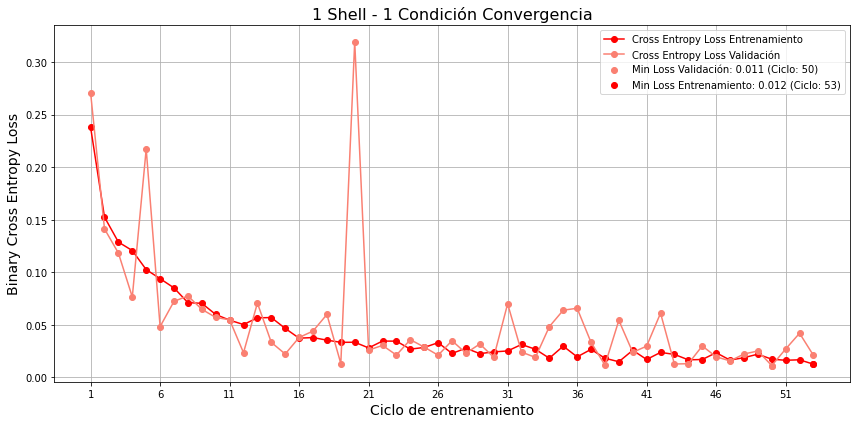

Lowest Loss Training: 0.0124 at Epoch 52
Lowest Loss Validation: 0.0111 at Epoch 49


In [19]:
#Condiciones minimas: 1
#Hiperparametros
#Trial 26 finished with value: 0.9935270269686288
# and parameters: {'lr': 9.521711513431419e-05,
# 'batch_size': 32,
# 'dense_units': 640,
# 'trainable_layers': 182, 
# 'f1_diff_thresh': 0.0003247219291335028,
# 'f1_macro_diff_thresh': 1.7056074089496955e-05,
# 'f1_deriv_thresh': 1.4693957298216927e-05,
# 'f1_macro_deriv_thresh': 7.05692081944898e-05}.

metrica_direccion = r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_final_1cond_1shell.txt"
metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=5
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("1 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("1 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("1 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("1 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")


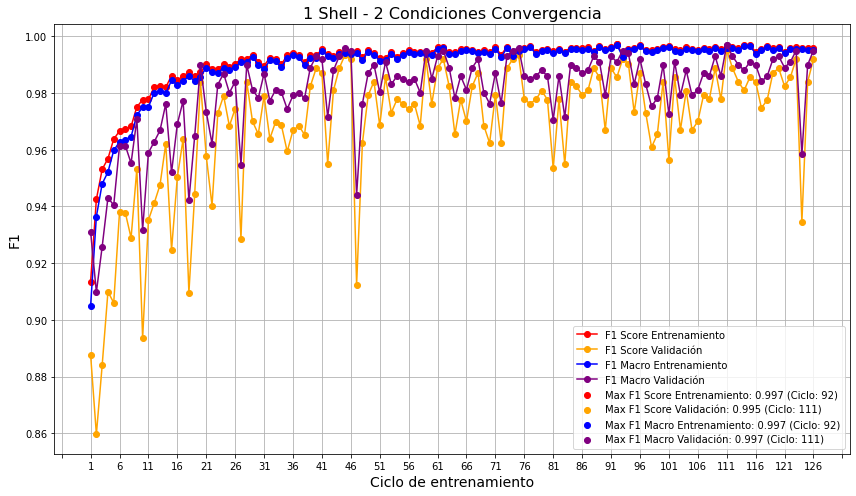

Highest F1 Score (Training): 0.9973 at Epoch 91
Highest F1 Score (Validation): 0.9952 at Epoch 110
Highest F1 Macro (Training): 0.9970 at Epoch 91
Highest F1 Macro (Validation): 0.9970 at Epoch 110


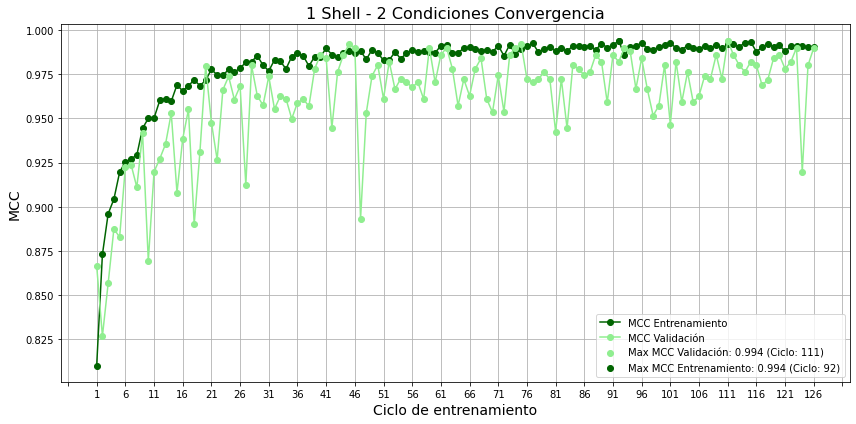

Highest MCC Training: 0.9940 at Epoch 91
Highest MCC Validation: 0.9940 at Epoch 110


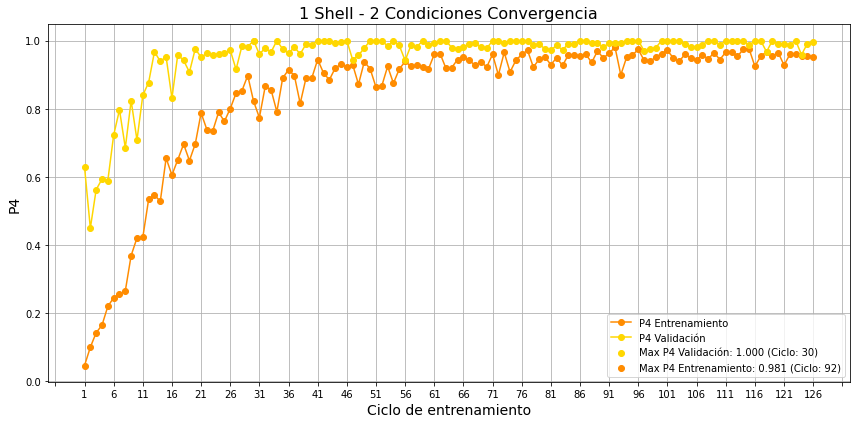

Highest P4 Training: 0.9812 at Epoch 91
Highest P4 Validation: 1.0000 at Epoch 29


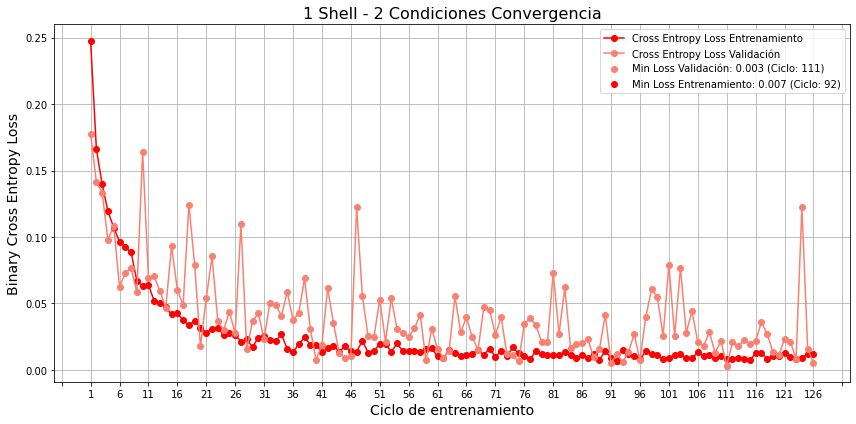

Lowest Loss Training: 0.0068 at Epoch 91
Lowest Loss Validation: 0.0032 at Epoch 110


In [17]:
#Condiciones minimas: 2
#Trial 16 finished with value: 0.9951529762588545 
# and parameters: {'lr': 6.14262564122435e-05,
# 'batch_size': 64,
# 'dense_units': 1280,
# 'trainable_layers': 258,
# 'f1_diff_thresh': 0.0006172075197813498,
# 'f1_macro_diff_thresh': 0.0005658986371592043,
# 'f1_deriv_thresh': 5.655720961320632e-05,
# 'f1_macro_deriv_thresh': 1.4307749891566144e-05}.


metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_final_2cond_1shell.txt"
metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=5
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("1 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("1 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("1 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("1 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")

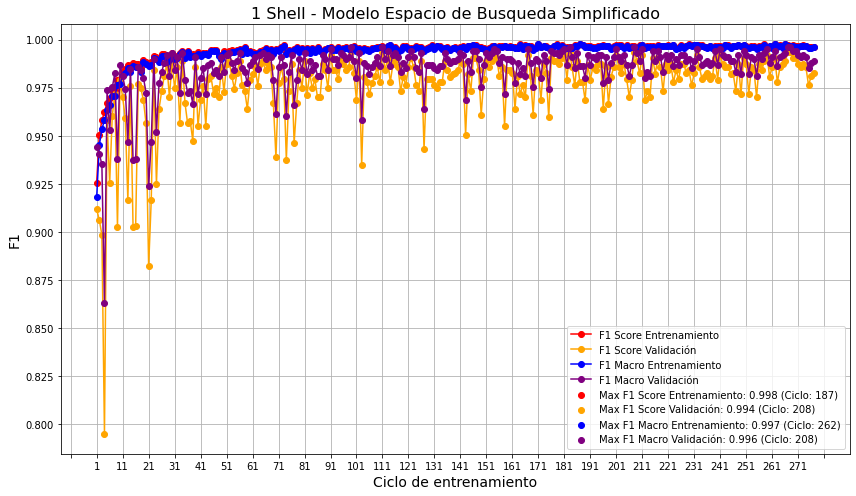

Highest F1 Score (Training): 0.9977 at Epoch 186
Highest F1 Score (Validation): 0.9935 at Epoch 207
Highest F1 Macro (Training): 0.9975 at Epoch 261
Highest F1 Macro (Validation): 0.9960 at Epoch 207


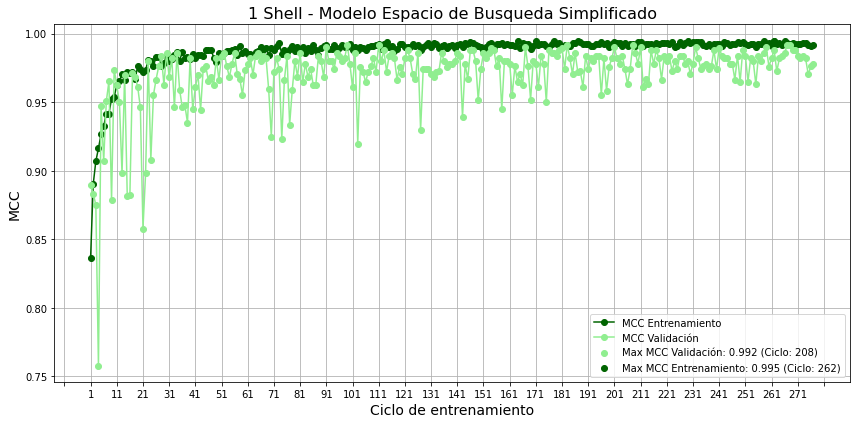

Highest MCC Training: 0.9949 at Epoch 261
Highest MCC Validation: 0.9920 at Epoch 207


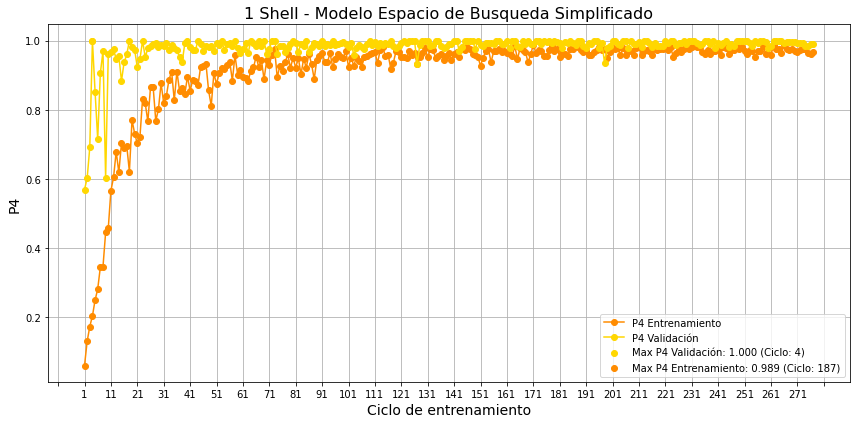

Highest P4 Training: 0.9890 at Epoch 186
Highest P4 Validation: 1.0000 at Epoch 3


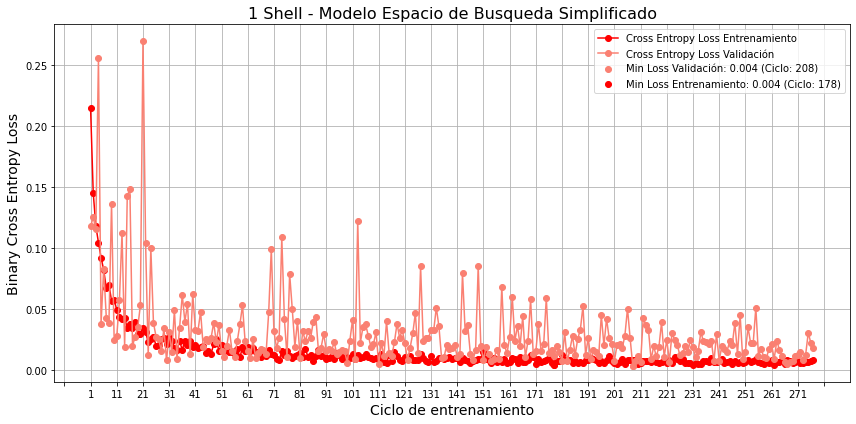

Lowest Loss Training: 0.0043 at Epoch 177
Lowest Loss Validation: 0.0039 at Epoch 207
277


In [5]:
#Simplificado: Espacio de Busqueda Simplificado
#Trial 5 (de 7) finished with value: 0.9951529762588545
# and parameters: {'lr': 0.00011818784427633005,
# 'dense_units': 896,
# 'trainable_layers': 202,
# 'f1_deriv_thresh': 2.3537007955528396e-05}


metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_simplificado_1shellINTENTO2.txt"
metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=10
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("1 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("1 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("1 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("1 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")
print(len(epochs))



### Shell 2 Modelos

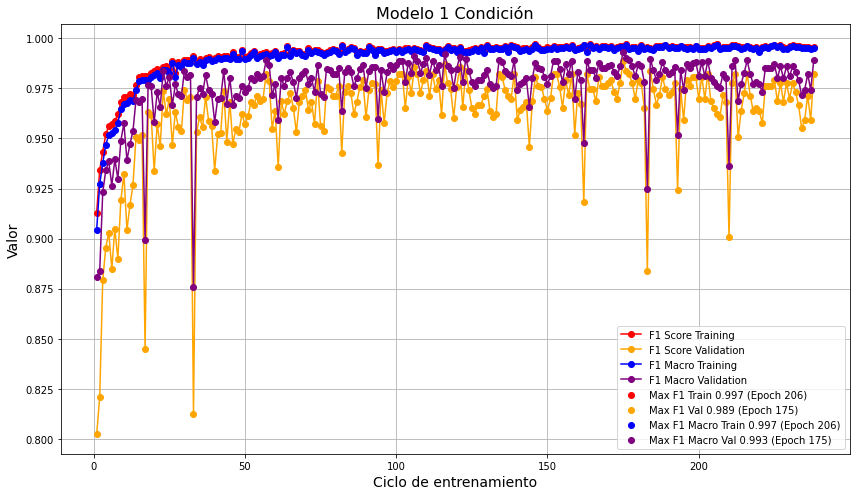

Highest F1 Score (Training): 0.9972 at Epoch 206
Highest F1 Score (Validation): 0.9887 at Epoch 175
Highest F1 Macro (Training): 0.9969 at Epoch 206
Highest F1 Macro (Validation): 0.9929 at Epoch 175


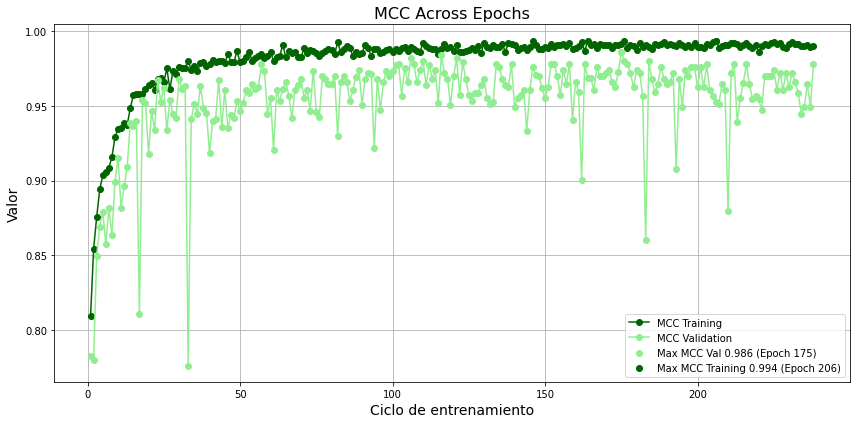

Highest MCC Training: 0.9937 at Epoch 206
Highest MCC Validation: 0.9859 at Epoch 175


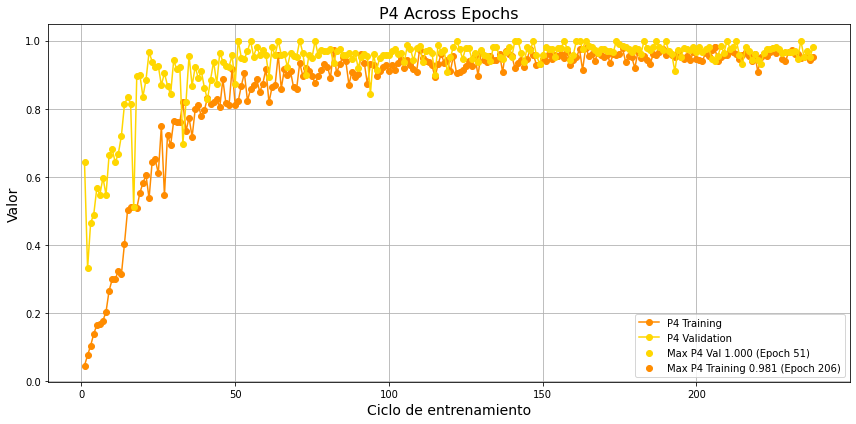

Highest P4 Training: 0.9806 at Epoch 206
Highest P4 Validation: 1.0000 at Epoch 51


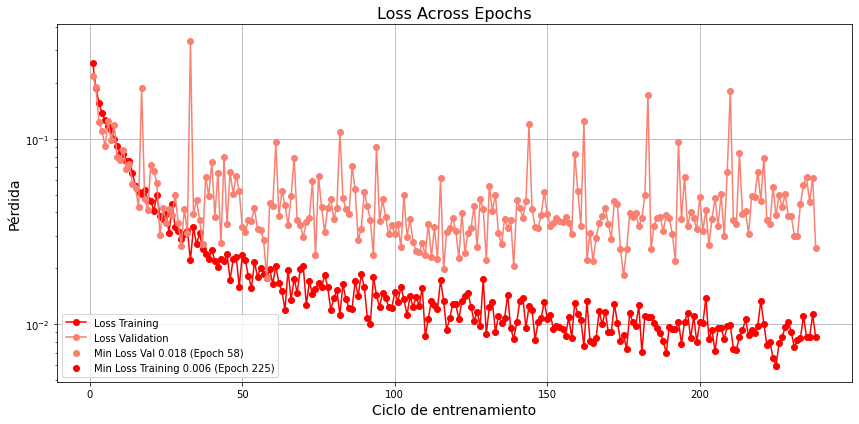

Lowest Loss Training: 0.0060 at Epoch 225
Lowest Loss Validation: 0.0177 at Epoch 58


In [ ]:
#Parametros optimizados a partir de la shell1 con 2 condiciones
# and parameters: {'lr': 6.14262564122435e-05,
# 'batch_size': 64,
# 'dense_units': 1280,
# 'trainable_layers': 258,
# 'f1_diff_thresh': 0.0006172075197813498,
# 'f1_macro_diff_thresh': 0.0005658986371592043,
# 'f1_deriv_thresh': 5.655720961320632e-05,
# 'f1_macro_deriv_thresh': 1.4307749891566144e-05}.

metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_final_2cond_2shell.txt"
metrica=pd.read_csv(metrica_direccion)
#print(metrica.tail(1))
metrica = metrica.drop(metrica.index[-1])
epochs=list(metrica["Epoch"])
epochs=list(map(float, epochs))
#Training Dataset
accuracy_training=list(metrica["accuracy"])
precision_training=list(metrica["precision"])
recall_training=list(metrica["recall"])
loss_training=list(metrica["loss"])
P4_training=list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training=list(metrica["F1_score"])
F1_MACRO_training=list(metrica["F1_macro"])

#Validation Set
accuracy_validation=list(metrica["val_accuracy"])
precision_validation=list(metrica["val_precision"])
recall_validation=list(metrica["val_recall"])
loss_validation=list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp=list(metrica["val_tp"])
tn=list(metrica["val_tn"])
fp=list(metrica["val_fp"])
fn=list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn,fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn,fp)]
F1_neg=[2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation=[(pos+neg)/2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation= [(4* tp* tn)/(4* tp* tn + (tp+tn) * (fp*fn)) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]
MCC_validation=[(tp * tn - fp * fn)/(tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp,tn,fp,fn in zip(tp,tn,fp,fn)]

# Plot the F1
plt.figure(figsize=(12, 7))

# Plot the F1 metrics
plt.plot(epochs, F1_score_training, label='F1 Score Training', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validation', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Training', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validation', marker='o', color='purple')

# Find max values and epochs
max_f1_epoch = F1_score_training.index(max(F1_score_training)) + 1
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation)) + 1
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training)) + 1
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation)) + 1

# Highlight maxima
plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Train {max(F1_score_training):.3f} (Epoch {max_f1_epoch})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Val {max(F1_score_validation):.3f} (Epoch {max_f1_val_epoch})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Train {max(F1_MACRO_training):.3f} (Epoch {max_f1_macro_epoch})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Val {max(F1_MACRO_validation):.3f} (Epoch {max_f1_macro_val_epoch})")

# Labels, title, legend
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("Modelo 1 Condición", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
# plt.xscale("log") # Optional

# Show plot
plt.show()

# Print summary
print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")


# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) + 1
max_mcc_training_epoch=MCC_training.index(max(MCC_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Training', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validation', marker='o', color='lightgreen')

plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Val {max(MCC_validation):.3f} (Epoch {max_mcc_val_epoch})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Training {max(MCC_training):.3f} (Epoch {max_mcc_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("MCC Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")
# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))+1
max_p4_training_epoch = P4_training.index(max(P4_training))+1
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Training', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validation', marker='o', color='gold')

plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold',
            label=f"Max P4 Val {max(P4_validation):.3f} (Epoch {max_p4_val_epoch})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange',
            label=f"Max P4 Training {max(P4_training):.3f} (Epoch {max_p4_training_epoch})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Valor", fontsize=14)
plt.title("P4 Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) +1
min_loss_training_epoch = loss_training.index(min(loss_training)) +1
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Loss Training', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Loss Validation', marker='o', color='salmon')

plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon',
            label=f"Min Loss Val {min(loss_validation):.3f} (Epoch {min_loss_val_epoch})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red',
            label=f"Min Loss Training {min(loss_training):.3f} (Epoch {min_loss_training_epoch})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Pérdida", fontsize=14)
plt.title("Loss Across Epochs", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")


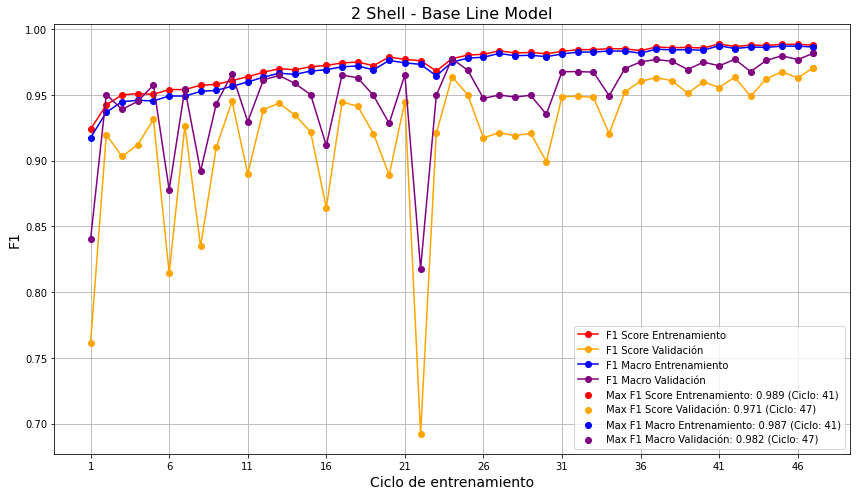

Highest F1 Score (Training): 0.9887 at Epoch 40
Highest F1 Score (Validation): 0.9707 at Epoch 46
Highest F1 Macro (Training): 0.9874 at Epoch 40
Highest F1 Macro (Validation): 0.9817 at Epoch 46


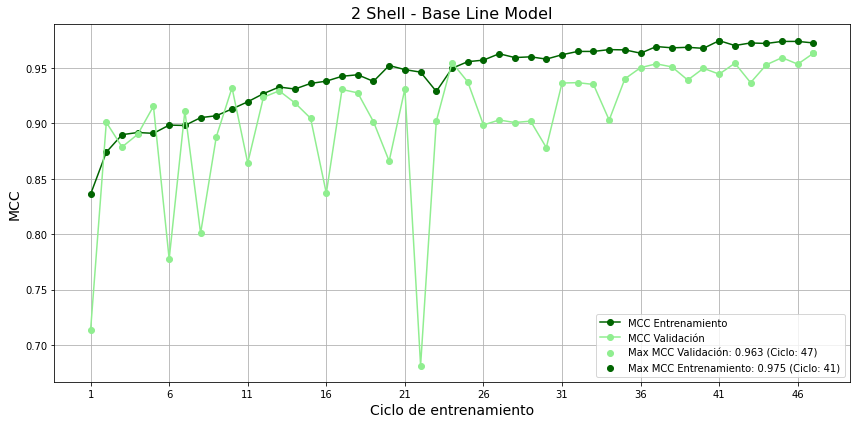

Highest MCC Training: 0.9748 at Epoch 40
Highest MCC Validation: 0.9634 at Epoch 46


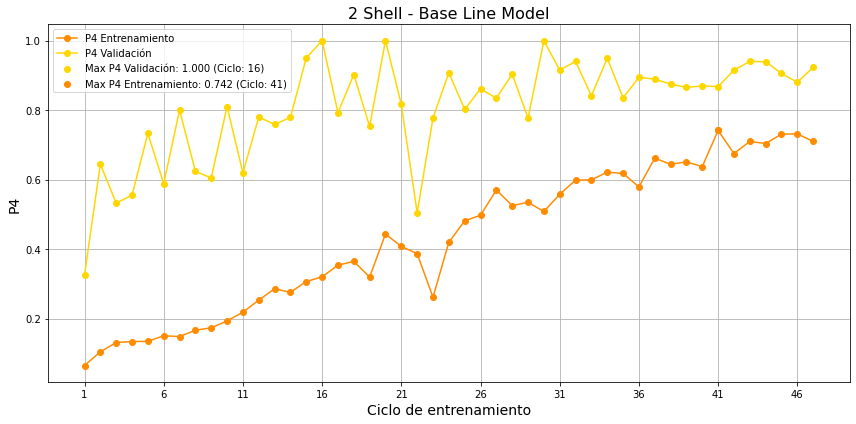

Highest P4 Training: 0.7417 at Epoch 40
Highest P4 Validation: 1.0000 at Epoch 15


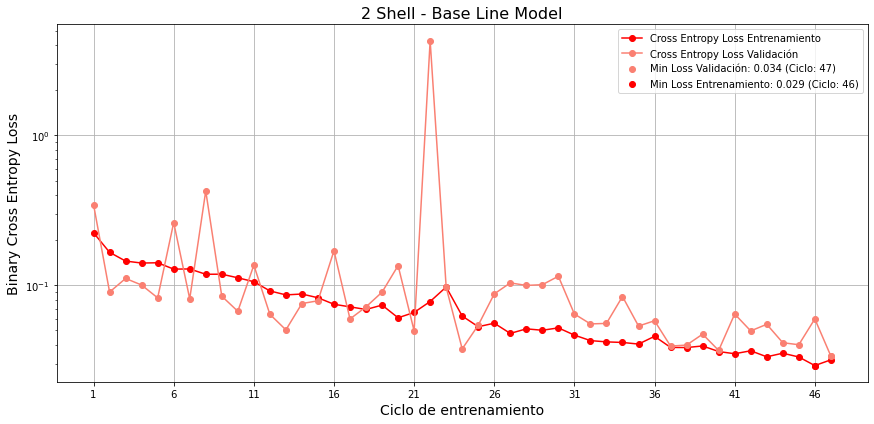

Lowest Loss Training: 0.0292 at Epoch 45
Lowest Loss Validation: 0.0338 at Epoch 46


In [4]:
#Modelo Laxo
#2 condiciones
# and parameters: {'lr': 0.001, 
# 'batch_size': 32,
# 'dense_units': 1064,
# 'trainable_layers': 150,
# 'f1_diff_thresh': 0.001,
# 'f1_macro_diff_thresh': 0.000005,
# 'f1_deriv_thresh': 0.001,
# 'f1_macro_deriv_thresh': 0.000005}.

metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_final_2cond_2shellLAXO.txt"
metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=5
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("2 Shell - Base Line Model", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("2 Shell - Base Line Model", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("2 Shell - Base Line Model", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("2 Shell - Base Line Model", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")


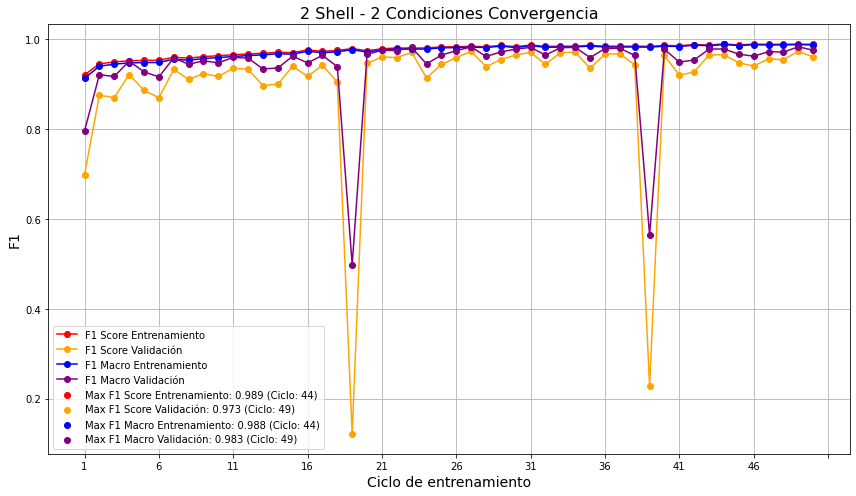

Highest F1 Score (Training): 0.9894 at Epoch 43
Highest F1 Score (Validation): 0.9730 at Epoch 48
Highest F1 Macro (Training): 0.9882 at Epoch 43
Highest F1 Macro (Validation): 0.9830 at Epoch 48


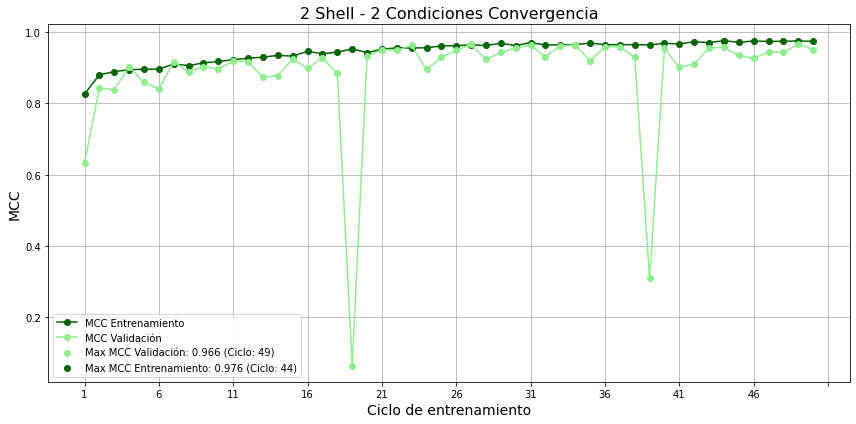

Highest MCC Training: 0.9764 at Epoch 43
Highest MCC Validation: 0.9664 at Epoch 48


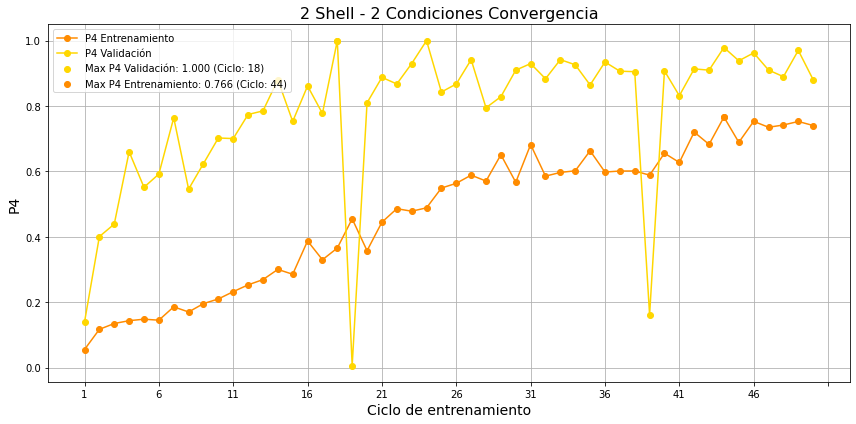

Highest P4 Training: 0.7664 at Epoch 43
Highest P4 Validation: 1.0000 at Epoch 17


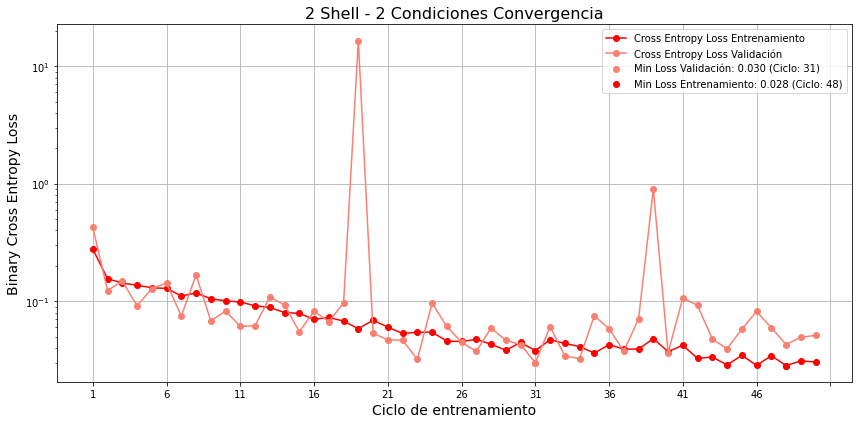

Lowest Loss Training: 0.0283 at Epoch 47
Lowest Loss Validation: 0.0300 at Epoch 30


In [8]:
#Opitmizado con Shell 2, 2 condiciones
#Trial 5 finished with value: 0.988690941502929
# and parameters: {'lr': 6.180292987782124e-05,
# 'batch_size': 64,
# 'dense_units': 1280,
# 'trainable_layers': 141,
# 'f1_diff_thresh': 8.290775550683358e-05,
# 'f1_macro_diff_thresh': 0.0009851946485021942,
# 'f1_deriv_thresh': 9.090709902945475e-05,
# 'f1_macro_deriv_thresh': 1.4181118091558595e-05}.

metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_Optimizado_final_2cond_2shell.txt"
metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=5
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("2 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
#plt.yscale("log")
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("2 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("2 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("2 Shell - 2 Condiciones Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")


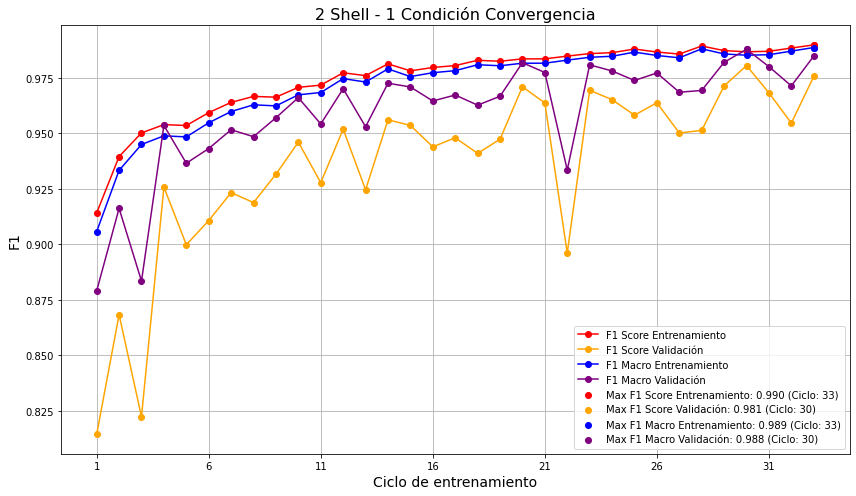

Highest F1 Score (Training): 0.9898 at Epoch 32
Highest F1 Score (Validation): 0.9805 at Epoch 29
Highest F1 Macro (Training): 0.9887 at Epoch 32
Highest F1 Macro (Validation): 0.9878 at Epoch 29


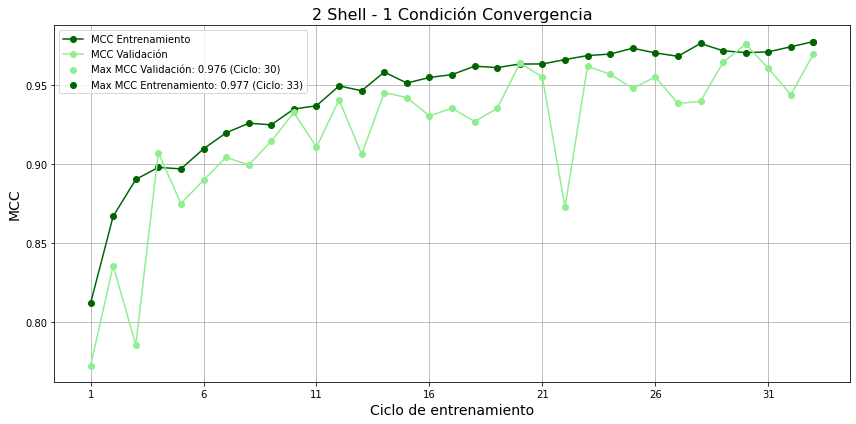

Highest MCC Training: 0.9773 at Epoch 32
Highest MCC Validation: 0.9756 at Epoch 29


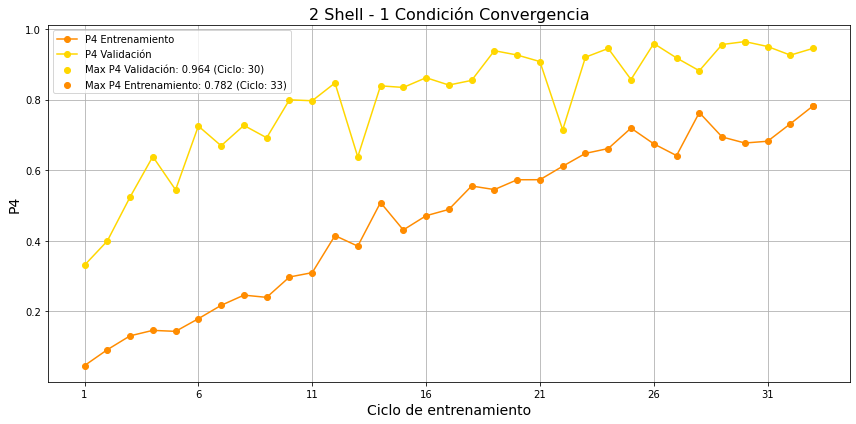

Highest P4 Training: 0.7823 at Epoch 32
Highest P4 Validation: 0.9642 at Epoch 29


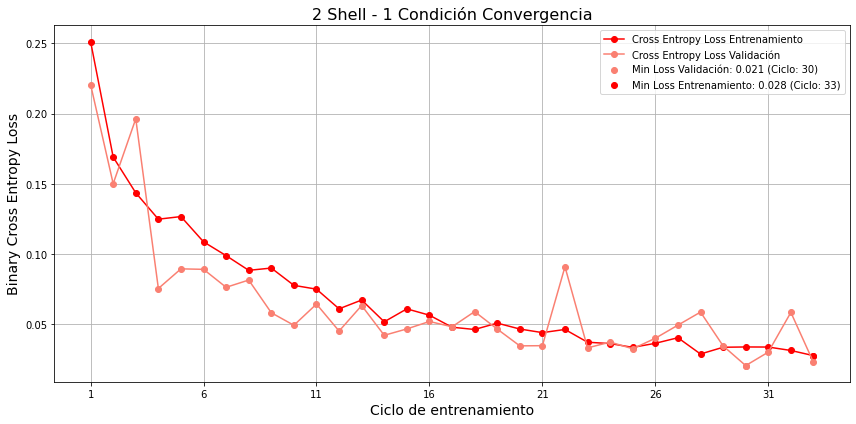

Lowest Loss Training: 0.0278 at Epoch 32
Lowest Loss Validation: 0.0207 at Epoch 29


In [3]:
#Opitmizado con Shell 2, 1 condiciones
#Trial 11 finished with value: 0.9918957589376207
# and parameters: {'lr': 3.292782329056591e-05,
# 'batch_size': 64,
# 'dense_units': 2048,
# 'trainable_layers': 158,
# 'f1_diff_thresh': 5.820350451570645e-05,
# 'f1_macro_diff_thresh': 1.7500748127406587e-05,
# 'f1_deriv_thresh': 2.663145690996998e-06,
# 'f1_macro_deriv_thresh': 9.123428311346003e-05}.
metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_final_1cond_2shell.txt"
metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=5
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("2 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("2 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("2 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("2 Shell - 1 Condición Convergencia", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
#plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")


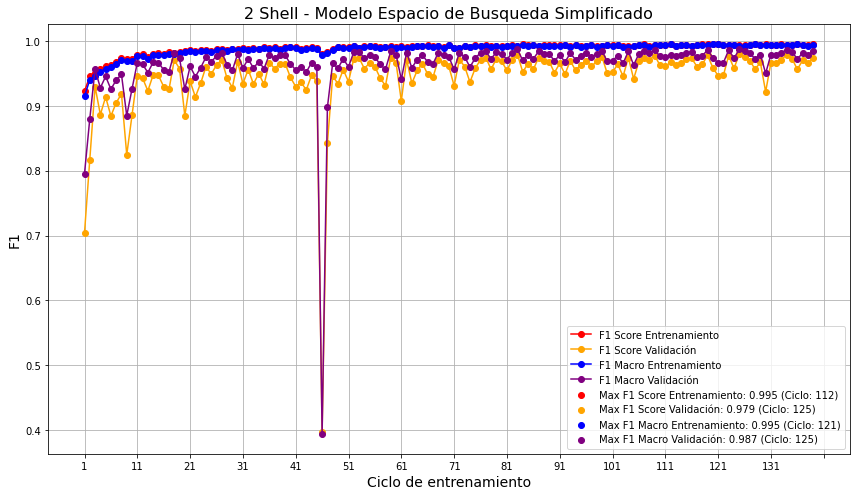

Highest F1 Score (Training): 0.9954 at Epoch 111
Highest F1 Score (Validation): 0.9792 at Epoch 124
Highest F1 Macro (Training): 0.9949 at Epoch 120
Highest F1 Macro (Validation): 0.9870 at Epoch 124


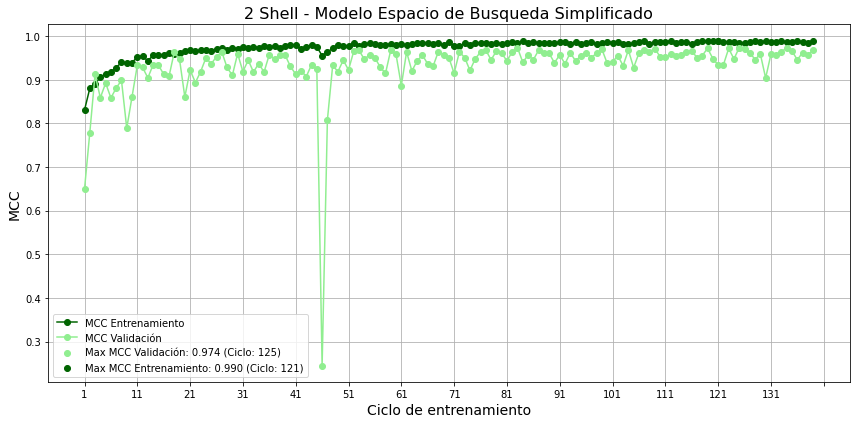

Highest MCC Training: 0.9898 at Epoch 120
Highest MCC Validation: 0.9741 at Epoch 124


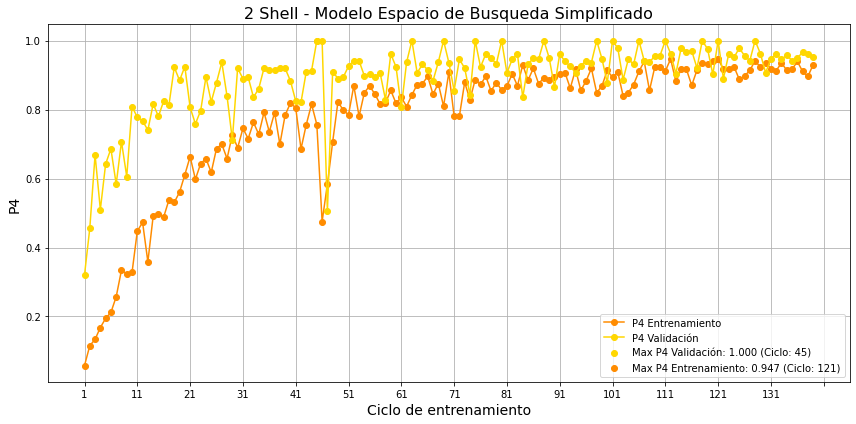

Highest P4 Training: 0.9471 at Epoch 120
Highest P4 Validation: 1.0000 at Epoch 44


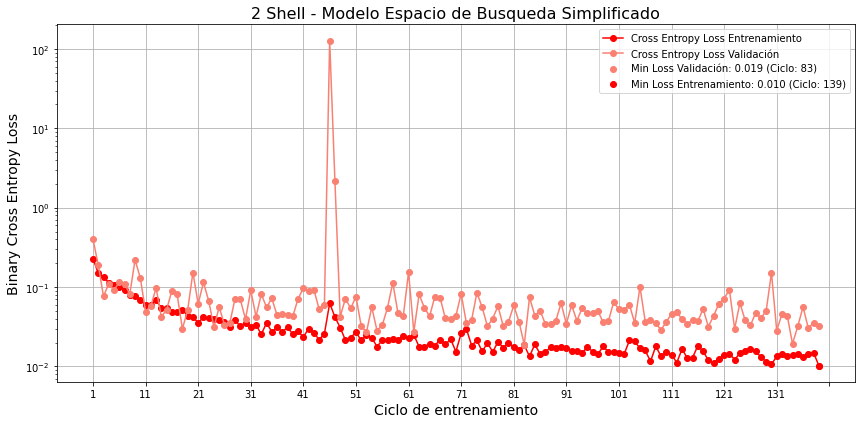

Lowest Loss Training: 0.0103 at Epoch 138
Lowest Loss Validation: 0.0188 at Epoch 82
139


In [7]:
#Modelo Espacio de Busqueda Simplificado (9 Trials)
#Trial 5 finished with value: 0.9902907671804106
# and parameters: {'lr': 0.00039561776455967844,
# 'dense_units': 1280,
# 'trainable_layers': 175,
# 'f1_deriv_thresh': 3.368211989639656e-06}


metrica_direccion=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\metricas_modelos_cluster\metricas_modelo_simplificado_2shellINTENTO2.txt"
metrica = pd.read_csv(metrica_direccion)
metrica = metrica.drop(metrica.index[-1])
epochs = list(metrica["Epoch"])
intervalo=10
# Training Dataset
accuracy_training = list(metrica["accuracy"])
precision_training = list(metrica["precision"])
recall_training = list(metrica["recall"])
loss_training = list(metrica["loss"])
P4_training = list(metrica["P4"])
MCC_training = [float(s[83:-2]) for s in metrica["MCC"]]
F1_score_training = list(metrica["F1_score"])
F1_MACRO_training = list(metrica["F1_macro"])

# Validation Set
accuracy_validation = list(metrica["val_accuracy"])
precision_validation = list(metrica["val_precision"])
recall_validation = list(metrica["val_recall"])
loss_validation = list(metrica["val_loss"])
F1_score_validation = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_validation, recall_validation)]
tp = list(metrica["val_tp"])
tn = list(metrica["val_tn"])
fp = list(metrica["val_fp"])
fn = list(metrica["val_fn"])
precision_neg = [tn / (tn + fn) for tn, fn in zip(tn, fn)]
recall_neg = [tn / (tn + fp) for tn, fp in zip(tn, fp)]
F1_neg = [2 * (p * r) / (p + r) if (p + r) > 0 else 0 for p, r in zip(precision_neg, recall_neg)]
F1_MACRO_validation = [(pos + neg) / 2 for pos, neg in zip(F1_score_validation, F1_neg)]
P4_validation = [(4 * tp * tn) / (4 * tp * tn + (tp + tn) * (fp * fn)) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]
MCC_validation = [(tp * tn - fp * fn) / (tf.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))) for tp, tn, fp, fn in zip(tp, tn, fp, fn)]

# ----------- 1. Plot F1 -------------------------
plt.figure(figsize=(12, 7))
plt.plot(epochs, F1_score_training, label='F1 Score Entrenamiento', marker='o', color='red')
plt.plot(epochs, F1_score_validation, label='F1 Score Validación', marker='o', color='orange')
plt.plot(epochs, F1_MACRO_training, label='F1 Macro Entrenamiento', marker='o', color='blue')
plt.plot(epochs, F1_MACRO_validation, label='F1 Macro Validación', marker='o', color='purple')

max_f1_epoch = F1_score_training.index(max(F1_score_training))
max_f1_val_epoch = F1_score_validation.index(max(F1_score_validation))
max_f1_macro_epoch = F1_MACRO_training.index(max(F1_MACRO_training))
max_f1_macro_val_epoch = F1_MACRO_validation.index(max(F1_MACRO_validation))

plt.scatter(max_f1_epoch, max(F1_score_training), color='red', label=f"Max F1 Score Entrenamiento: {max(F1_score_training):.3f} (Ciclo: {max_f1_epoch+1})")
plt.scatter(max_f1_val_epoch, max(F1_score_validation), color='orange', label=f"Max F1 Score Validación: {max(F1_score_validation):.3f} (Ciclo: {max_f1_val_epoch+1})")
plt.scatter(max_f1_macro_epoch, max(F1_MACRO_training), color='blue', label=f"Max F1 Macro Entrenamiento: {max(F1_MACRO_training):.3f} (Ciclo: {max_f1_macro_epoch+1})")
plt.scatter(max_f1_macro_val_epoch, max(F1_MACRO_validation), color='purple', label=f"Max F1 Macro Validación: {max(F1_MACRO_validation):.3f} (Ciclo: {max_f1_macro_val_epoch+1})")

plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("F1", fontsize=14)
plt.title("2 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend(loc='best', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()

print(f"Highest F1 Score (Training): {max(F1_score_training):.4f} at Epoch {max_f1_epoch}")
print(f"Highest F1 Score (Validation): {max(F1_score_validation):.4f} at Epoch {max_f1_val_epoch}")
print(f"Highest F1 Macro (Training): {max(F1_MACRO_training):.4f} at Epoch {max_f1_macro_epoch}")
print(f"Highest F1 Macro (Validation): {max(F1_MACRO_validation):.4f} at Epoch {max_f1_macro_val_epoch}")

# ----------- 2. Plot MCC -------------------------
max_mcc_val_epoch = MCC_validation.index(max(MCC_validation)) 
max_mcc_training_epoch = MCC_training.index(max(MCC_training))
plt.figure(figsize=(12, 6))
plt.plot(epochs, MCC_training, label='MCC Entrenamiento', marker='o', color='darkgreen')
plt.plot(epochs, MCC_validation, label='MCC Validación', marker='o', color='lightgreen')
plt.scatter(max_mcc_val_epoch, max(MCC_validation), color='lightgreen', label=f"Max MCC Validación: {max(MCC_validation):.3f} (Ciclo: {max_mcc_val_epoch+1})")
plt.scatter(max_mcc_training_epoch, max(MCC_training), color='darkgreen', label=f"Max MCC Entrenamiento: {max(MCC_training):.3f} (Ciclo: {max_mcc_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("MCC", fontsize=14)
plt.title("2 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest MCC Training: {max(MCC_training):.4f} at Epoch {max_mcc_training_epoch}")
print(f"Highest MCC Validation: {max(MCC_validation):.4f} at Epoch {max_mcc_val_epoch}")

# ----------- 3. Plot P4 -------------------------
max_p4_val_epoch = P4_validation.index(max(P4_validation))
max_p4_training_epoch = P4_training.index(max(P4_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, P4_training, label='P4 Entrenamiento', marker='o', color='darkorange')
plt.plot(epochs, P4_validation, label='P4 Validación', marker='o', color='gold')
plt.scatter(max_p4_val_epoch, max(P4_validation), color='gold', label=f"Max P4 Validación: {max(P4_validation):.3f} (Ciclo: {max_p4_val_epoch+1})")
plt.scatter(max_p4_training_epoch, max(P4_training), color='darkorange', label=f"Max P4 Entrenamiento: {max(P4_training):.3f} (Ciclo: {max_p4_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("P4", fontsize=14)
plt.title("2 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Highest P4 Training: {max(P4_training):.4f} at Epoch {max_p4_training_epoch}")
print(f"Highest P4 Validation: {max(P4_validation):.4f} at Epoch {max_p4_val_epoch}")

# ----------- 4. Plot Loss -------------------------------
min_loss_val_epoch = loss_validation.index(min(loss_validation)) 
min_loss_training_epoch = loss_training.index(min(loss_training)) 
plt.figure(figsize=(12, 6))
plt.plot(epochs, loss_training, label='Cross Entropy Loss Entrenamiento', marker='o', color='red')
plt.plot(epochs, loss_validation, label='Cross Entropy Loss Validación', marker='o', color='salmon')
plt.scatter(min_loss_val_epoch, min(loss_validation), color='salmon', label=f"Min Loss Validación: {min(loss_validation):.3f} (Ciclo: {min_loss_val_epoch+1})")
plt.scatter(min_loss_training_epoch, min(loss_training), color='red', label=f"Min Loss Entrenamiento: {min(loss_training):.3f} (Ciclo: {min_loss_training_epoch+1})")
plt.xlabel("Ciclo de entrenamiento", fontsize=14)
plt.ylabel("Binary Cross Entropy Loss", fontsize=14)
plt.title("2 Shell - Modelo Espacio de Busqueda Simplificado", fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.yscale("log")
plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(intervalo))
plt.show()
print(f"Lowest Loss Training: {min(loss_training):.4f} at Epoch {min_loss_training_epoch}")
print(f"Lowest Loss Validation: {min(loss_validation):.4f} at Epoch {min_loss_val_epoch}")
print(len(epochs))



## PRUEBA MODELOS

In [31]:
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo1_prueba3.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo3_30ciclos.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo3_convergente5.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo150_00001_convergente5.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo150_00001_convergente5LIMITE500.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo150_F1ScoreDerivate5OTRO.keras" #LAXO
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo135_F1ScoreOPTI.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_final_1cond_1shell.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_final_2cond_1shell.keras" #ESTRICTO
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_simplificado_1shellINTENTO2.keras"  #MODELO SIMPLIFICADO
## SHELL 2
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_final_2cond_2shell.keras"    
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_final_2cond_2shellLAXO.keras"     #LAXO
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_Optimizado_final_2cond_2shell.keras"
#modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_final_1cond_2shell.keras"
modelo_path=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\modelos\modelo_simplificado_2shellINTENTO2.keras"
model = tf.keras.models.load_model(modelo_path)

In [32]:
resultados={}
#folder_path = r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\data_v2_diagramas\shell1\prueba"
#REVISAR SHELL
folder_path= r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Diagramas Shell\shell2"
for file in os.listdir(folder_path):
    img_path=os.path.join(folder_path,file)
    img = image.load_img(img_path, target_size=(253, 385))
 # Preprocessing the image
    x = image.img_to_array(img)
# x = np.true_divide(x, 255)
## Scaling
    x=x/255
    x = np.expand_dims(x, axis=0)
    preds = model.predict(x)
#preds=np.argmax(preds, axis=1)

    print(file+"   :"+str(preds))
    resultados[file]=preds[0][0]

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Q1_cluster_0.csv.png   :[[1.7440774e-06]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
Q1_cluster_1.csv.png   :[[0.34323314]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
Q1_cluster_10.csv.png   :[[0.99999774]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Q1_cluster_100.csv.png   :[[0.00977317]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
Q1_cluster_101.csv.png   :[[0.00836403]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
Q1_cluster_102.csv.png   :[[0.00025588]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
Q1_cluster_103.csv.png   :[[0.19006494]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
Q1_cluster_104.csv.png   :[[0.00796792]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Q1_cluster_105.csv.png   :[[0.02662994]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Q1_cluster_106.csv.png   :[[1.5782547e-05]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Q1_cluster_107.csv.png   :[[0.0002993]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Q1_cluster_108.csv.png   :[[0.04778111]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
Q1_c

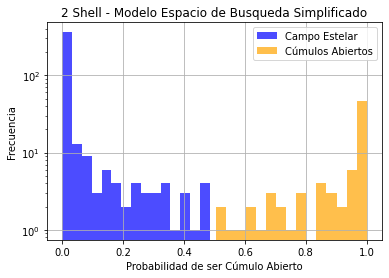

In [33]:
prediccion_shell1=list(resultados.values())
threshold = 0.5

# Split data into two groups
data_below_threshold = [x for x in prediccion_shell1 if x <= threshold]
data_above_threshold = [x for x in prediccion_shell1 if x > threshold]
# Plot histograms
#plt.figure(figsize=(10, 5))
plt.hist(data_below_threshold, bins=15, color='blue', alpha=0.7, label="Campo Estelar")
plt.hist(data_above_threshold, bins=15, color='orange', alpha=0.7, label="Cúmulos Abiertos")
#plt.yscale("log")
# Add labels and legend
plt.xlabel('Probabilidad de ser Cúmulo Abierto')
plt.ylabel('Frecuencia')
plt.title('2 Shell - Modelo Espacio de Busqueda Simplificado')
plt.legend()
plt.grid(True)
plt.yscale("log")
# Show plot
plt.show()

In [34]:
cumulos_resultados={}
campo_resultados={}
llaves=resultados.keys()
for x in llaves:
    valor=resultados[x]
    if valor >0.5:
        cumulos_resultados[x]=valor
    else:
        campo_resultados[x]=valor

len(cumulos_resultados), len(campo_resultados)
#Modelo 3:30 Ciclos: (128,552)
#Modelo 3 [150]: 63 Ciclos (Convergencia 5 de 0.001): (137, 543) #####
#Modelo 3 [150]: 100 Ciclos (Convergencia 5 de 0.0001): (150, 530)
#Modelo 3 [150]: 500 Ciclos (Convergencia 5 de 0.0001): (87, 593)
#Modelo 3 [150]: 42 Ciclos (Convergencia 5 de 0.001, Derivadas 5 de 0.000005): (215,465) [LAXO]
#Modelo [135]: 44 Ciclos (Parametros Optuna 1 cond): (100, 580)
#Modelo Optimizado Optuna 1 cond: (134,546) [ESTRICTO V1]
#Modelo Optimizado Optuna 2 cond: (79,601)  [ESTRICTO V2]
#Modelo Simplificado (91, 589)

###Shell 2
#Modelo Optimizado (con shell1) Optuna 2 cond: (69,430)  [ESTRICTO V2]
#Modelo Laxo (27,472)
#Modelo Optimizado (con Shell2) 2 cond: (79,420)
#Modelo Optimizados 1 cond: (96,403)
#Modelo Simplificado: (78,421)

(78, 421)

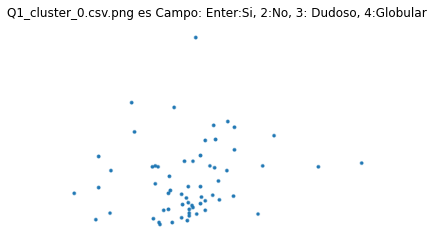

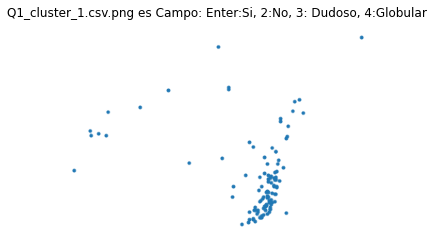

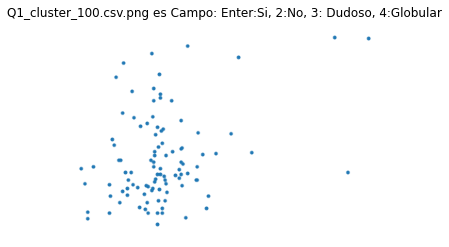

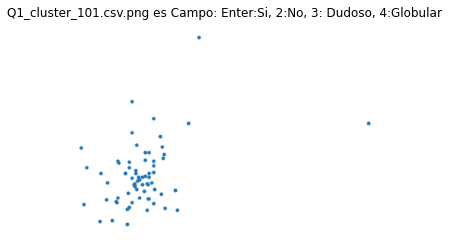

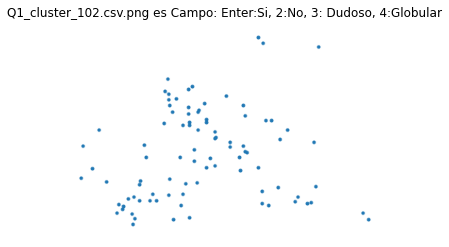

...

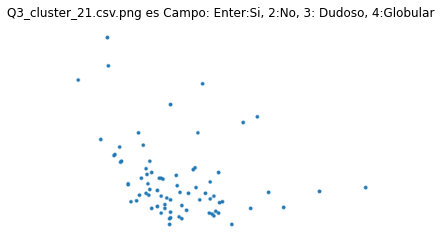

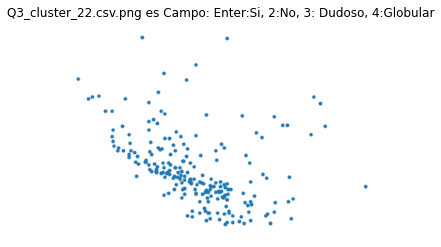

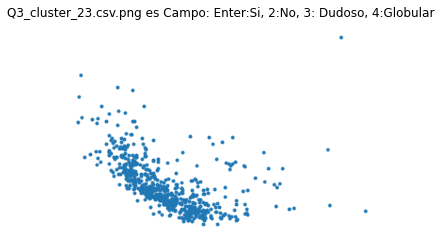

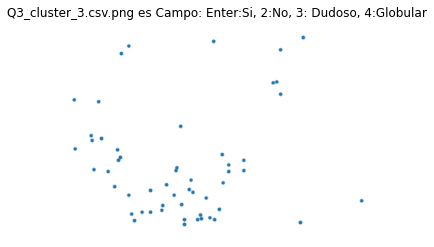

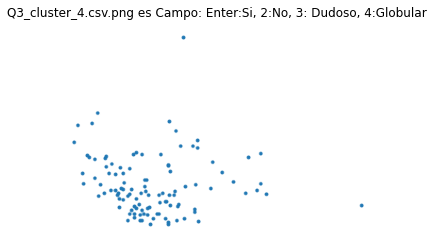

All images have been displayed.


In [35]:
# Folder path and list of image names
## REVISAR SHELL
folder_path = clasificar_shell2  # Replace with your folder path
image_names = list(campo_resultados.keys())  # Replace with your list of image names

image_names1=image_names[:len(image_names)//2]
image_names2=image_names[len(image_names)//2:]

verificacion_campo={}
for image_name in image_names1:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Campo: Enter:Si, 2:No, 3: Dudoso, 4:Globular")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3", "4"]:
            if user_input=="":
                user_input=["True",campo_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",campo_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",campo_resultados[image_name]]
            elif user_input=="4":
                user_input=["Globular",campo_resultados[image_name]]
            verificacion_campo[image_name]=user_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")

print("All images have been displayed.")


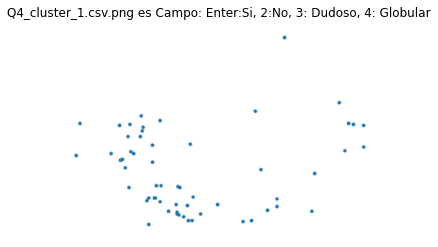

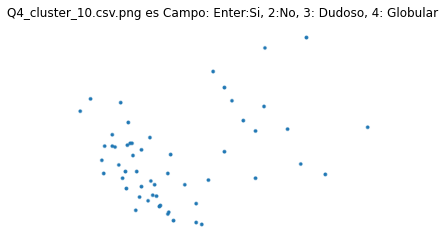

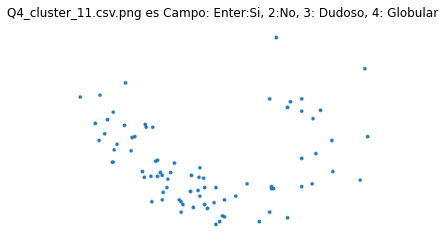

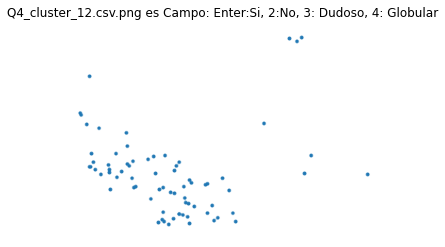

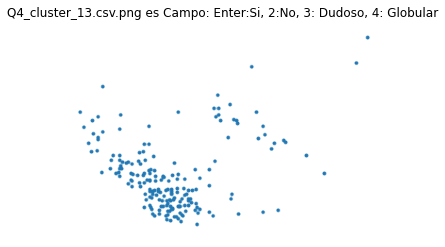

...

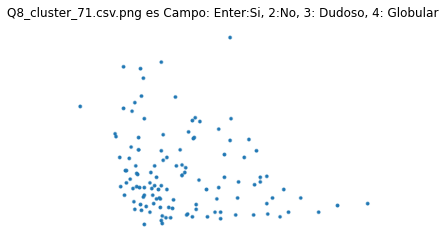

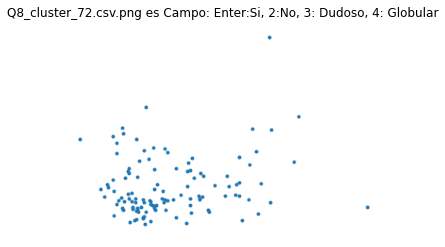

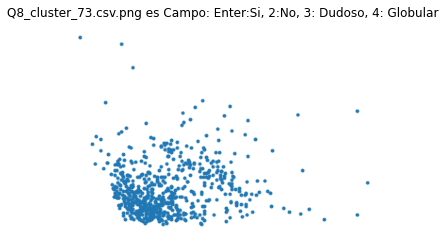

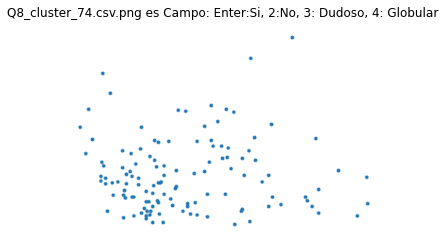

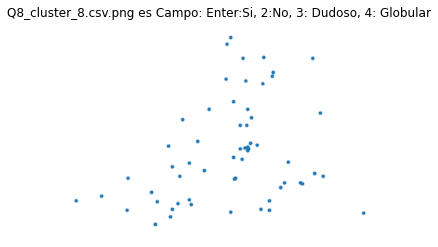

All images have been displayed.


In [23]:
for image_name in image_names2:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Campo: Enter:Si, 2:No, 3: Dudoso, 4: Globular")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3","4"]:
            if user_input=="":
                user_input=["True",campo_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",campo_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",campo_resultados[image_name]]
            elif user_input=="4":
                user_input=["Globular",campo_resultados[image_name]]
            verificacion_campo[image_name]=user_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")
4
print("All images have been displayed.")


In [ ]:
falsos_negativos=0
campos_dudosos=0
globulares_campo=0
for x in verificacion_campo.keys():
    if verificacion_campo[x][0]=="False":
        falsos_negativos+=1
    if verificacion_campo[x][0]=="Dudoso":
        campos_dudosos+=1
    if verificacion_campo[x][0]=="Globular":
        globulares_campo+=1
    
print(falsos_negativos, campos_dudosos, globulares_campo)
#Modelo convergente derivadas 500: 10, 42, 7
#Modelo Convergente derivadas 2 condiciones: 3, 7, 4 Vs 3, 13, 8 [Laxo]
#Modelo Optimizado Optuna 1 cond (intento 1): 9, 36,4
#Modelo Final Optimizado Optina 1 cond: 7,23,3   Vs 12,38,7 Vs 5,42,5
#Modelo Final Optimizado Optuna 2 cond: 14,70,3 Vs 21 84 5
#Modelo Simplificado: 26, 87, 14

#Shell2
#Modelo Baseline: 16, 41, 31
#Modelo Optuna 1 cond: 6,26,9
#Modelo Optimizado (2 shell) 2 cond: 3,11,10 Vs 9, 29, 13
#Modelo Simplificado: 4, 8, 5

4 8 5


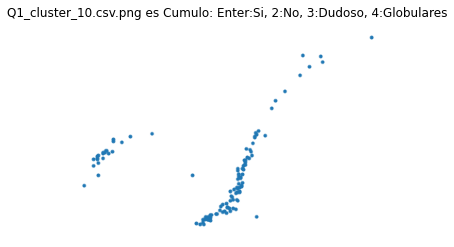

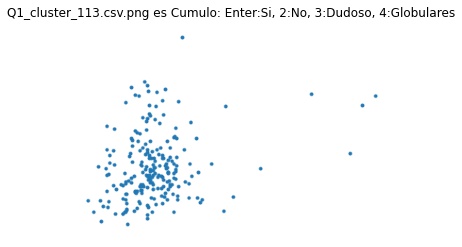

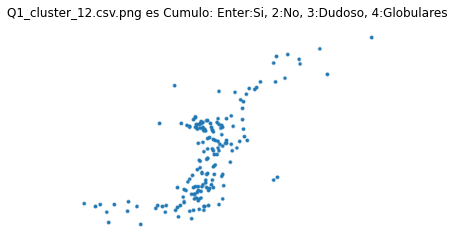

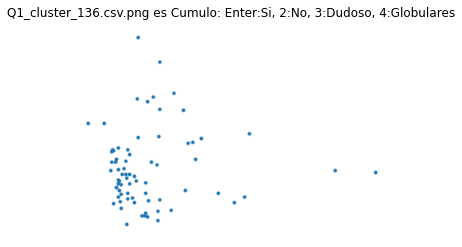

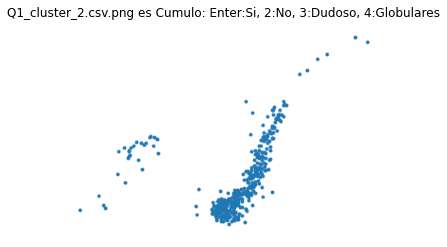

...

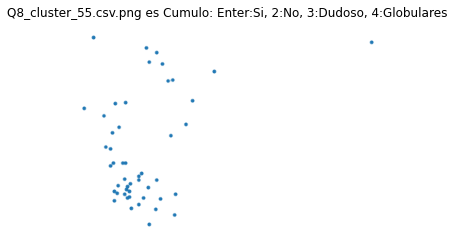

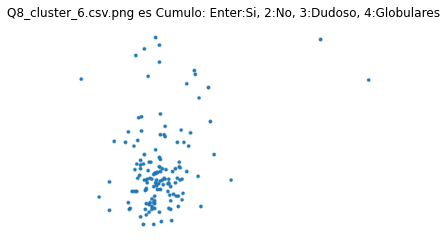

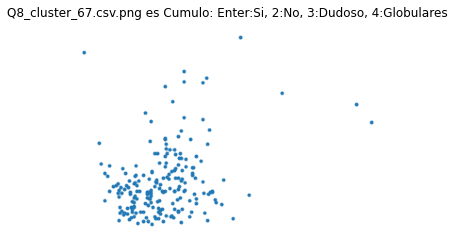

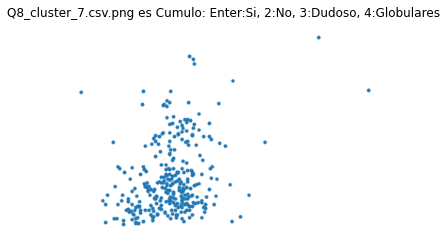

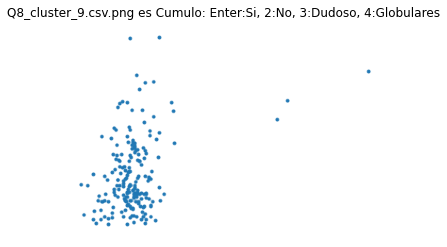

All images have been displayed.


In [39]:
# Folder path and list of image names
##REVISAR SHELL 
folder_path = clasificar_shell2  # Replace with your folder path
image_names = cumulos_resultados.keys()  # Replace with your list of image names
verificacion_cumulo={}
for image_name in image_names:
    # Full path to the image
    image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Hide axis for better viewing
    plt.title(image_name+" es Cumulo: Enter:Si, 2:No, 3:Dudoso, 4:Globulares")
    plt.show()
    
    # Wait for user input
    while True:
        user_input = input(f"Enter True or False for {image_name}: ")
        if user_input in ["", "2","3","4"]:
            if user_input=="":
                user_input=["True",cumulos_resultados[image_name]]
            elif user_input=="2":
                user_input=["False",cumulos_resultados[image_name]]
            elif user_input=="3":
                user_input=["Dudoso",cumulos_resultados[image_name]]
            elif user_input=="4":
                user_input=["Globular",cumulos_resultados[image_name]]
            verificacion_cumulo[image_name]=user_input
            break  # Proceed to the next image if input is valid
        else:
            print("Please enter either 'True' or 'False'.")

print("All images have been displayed.")


In [ ]:
falsos_positivos=0
cumulos_dudosos=0
globulares_cumulos=0
for x in verificacion_cumulo.keys():
    if verificacion_cumulo[x][0]=="False":
        falsos_positivos+=1
    if verificacion_cumulo[x][0]=="Dudoso":
        cumulos_dudosos+=1
    if verificacion_cumulo[x][0]=="Globular":
        globulares_cumulos+=1

print(falsos_positivos, cumulos_dudosos, globulares_cumulos)
#modelo convergente diferencias 500 6,8,5
#modelo convergente diferencias derivadas 2 condiciones: 51, 45, 11 Vs 62, 84, 13 [Laxo]
#Modeo optimizado Optuna 1 cond 1 intento:3, 10, 13 

#Modelo Final Optimizado 1 cond: 17, 15, 14 Vs 14, 24, 15 Vs 11, 25, 15
#Modelo Final Optimizado 2 cond: 5,7,16 Vs 4, 6, 17
#Modelo Simplificado: 6 12 11

#Shell2
#Modelo Base Line: 9, 5, 2
#Modelo Optuna 1 cond: 18, 13, 26
#Optimizado (shell2) 2 cond: 24,12,19 Vs 20, 10, 23
#Modelo Simplificado: 19, 5, 27

19 5 27


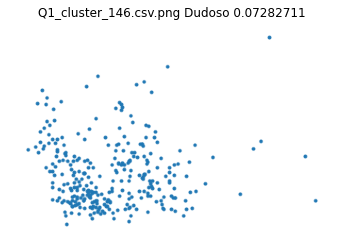

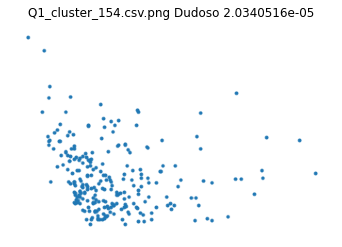

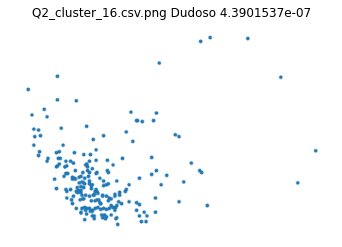

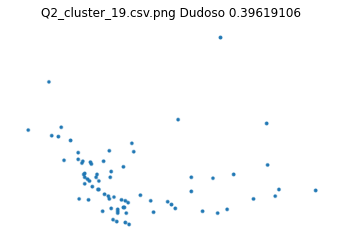

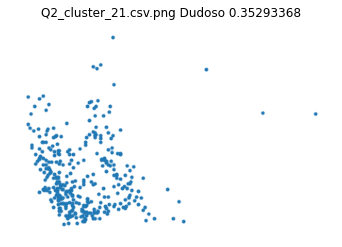

...

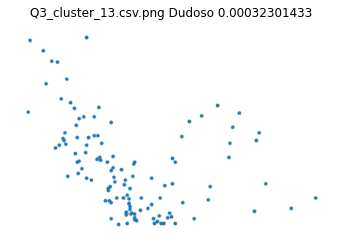

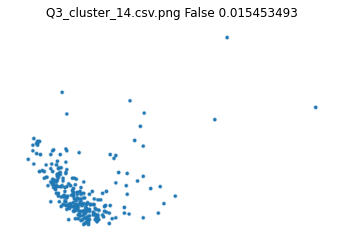

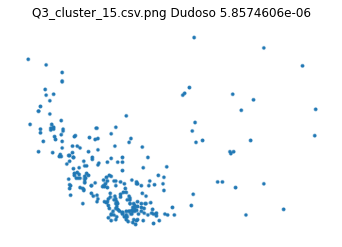

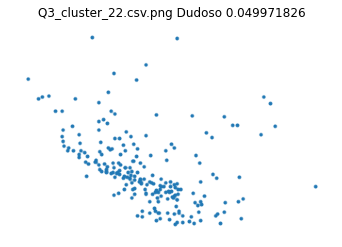

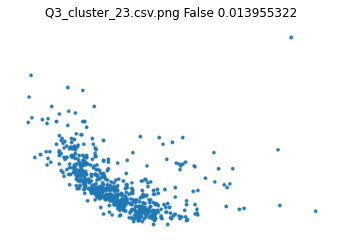

All images have been displayed.


In [41]:
image_names = verificacion_campo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_campo[image_name][0]=="False" or verificacion_campo[image_name][0]=="Dudoso":
        image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.axis('off')  # Hide axis for better viewing
        plt.title(image_name+" " +str(verificacion_campo[image_name][0])+" "+str(verificacion_campo[image_name][1]))
        plt.show()

print("All images have been displayed.")


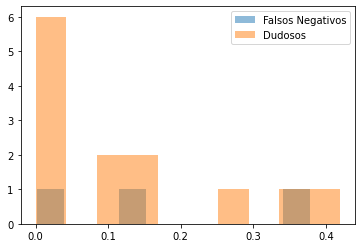

In [17]:
falsos_negativos_probabilidad=[]
falsos_dudosos_probabilidad=[]
image_names = verificacion_campo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_campo[image_name][0]=="False":
        falsos_negativos_probabilidad.append(verificacion_campo[image_name][1])
    if verificacion_campo[image_name][0]=="Dudoso":
        falsos_dudosos_probabilidad.append(verificacion_campo[image_name][1])
        

plt.hist(falsos_negativos_probabilidad,alpha=0.5,label="Falsos Negativos")
plt.hist(falsos_dudosos_probabilidad,alpha=0.5,label="Dudosos")
plt.legend()
plt.show()

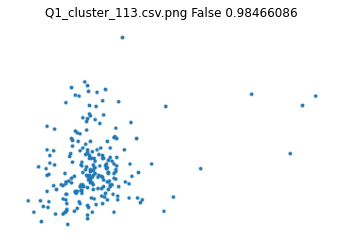

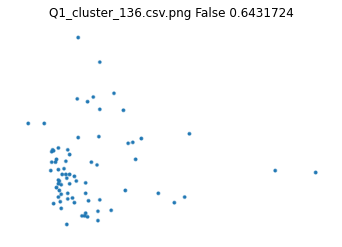

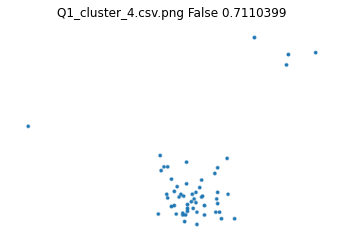

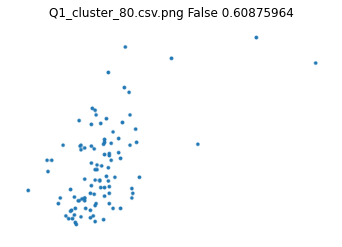

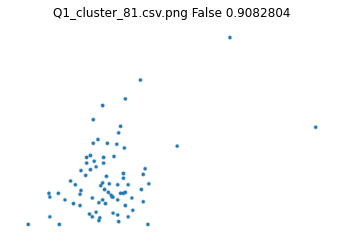

...

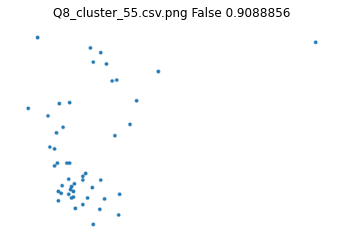

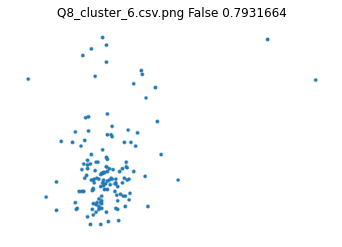

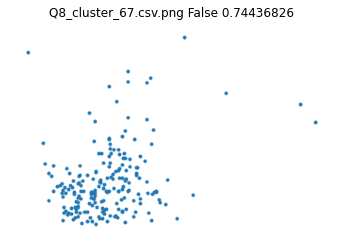

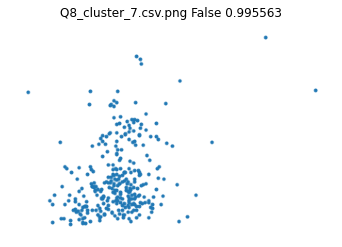

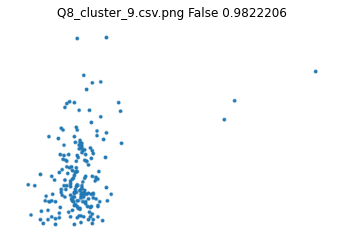

All images have been displayed.


In [42]:
image_names = verificacion_cumulo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_cumulo[image_name][0]=="False" or verificacion_cumulo[image_name][0]=="Dudoso":
        image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.axis('off')  # Hide axis for better viewing
        plt.title(image_name+" " +str(verificacion_cumulo[image_name][0])+" "+str(verificacion_cumulo[image_name][1]))
        plt.show()

print("All images have been displayed.")

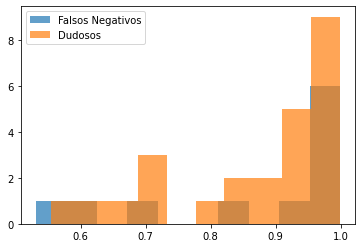

In [72]:
falsos_positivos_probabilidad=[]
positivos_dudosos_probabilidad=[]
image_names = verificacion_cumulo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_cumulo[image_name][0]=="False":
        falsos_positivos_probabilidad.append(verificacion_cumulo[image_name][1])
    if verificacion_cumulo[image_name][0]=="Dudoso":
        positivos_dudosos_probabilidad.append(verificacion_cumulo[image_name][1])
        

plt.hist(falsos_positivos_probabilidad,alpha=0.7,label="Falsos Negativos")
plt.hist(positivos_dudosos_probabilidad,alpha=0.7,label="Dudosos")
plt.legend()
plt.show()

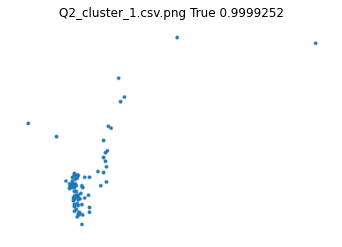

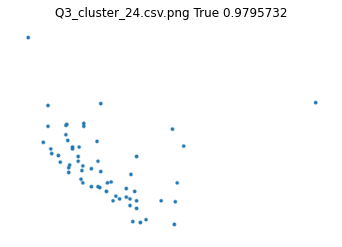

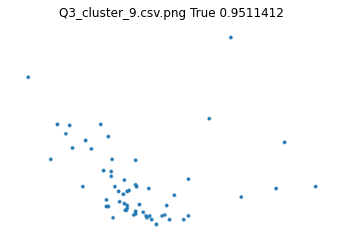

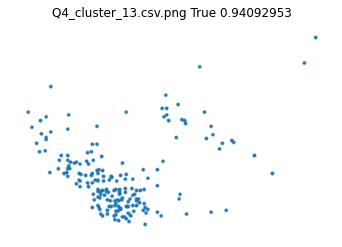

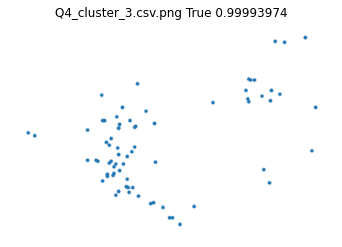

...

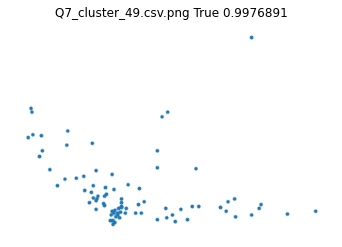

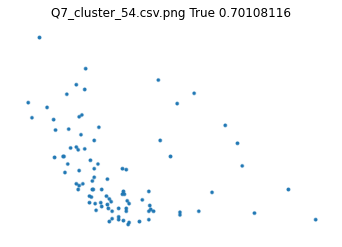

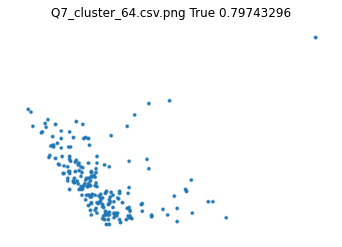

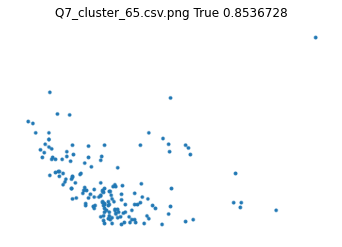

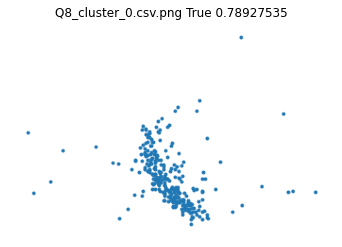

All images have been displayed.


In [43]:
image_names = verificacion_cumulo.keys()  # Replace with your list of image names
for image_name in image_names:
    # Full path to the image
    if verificacion_cumulo[image_name][0]=="True":
        image_path = os.path.join(folder_path, image_name)
    
    # Load and display the image
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.axis('off')  # Hide axis for better viewing
        plt.title(image_name+" " +str(verificacion_cumulo[image_name][0])+" "+str(verificacion_cumulo[image_name][1]))
        plt.show()

print("All images have been displayed.")

In [44]:
output_file = 'candidatos_shell2_simplificado.csv'

# Guardar en CSV
with open(output_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    # Escribir la cabecera (opcional)
    writer.writerow(['Archivo', 'Clasificacion', 'Valor'])
    
    # Escribir los datos
    for key, (clasificacion, valor) in verificacion_cumulo.items():
        writer.writerow([key, clasificacion, valor])

print(f"Archivo '{output_file}' guardado exitosamente.")

        

Archivo 'candidatos_shell2_simplificado.csv' guardado exitosamente.


### Grafico Circular

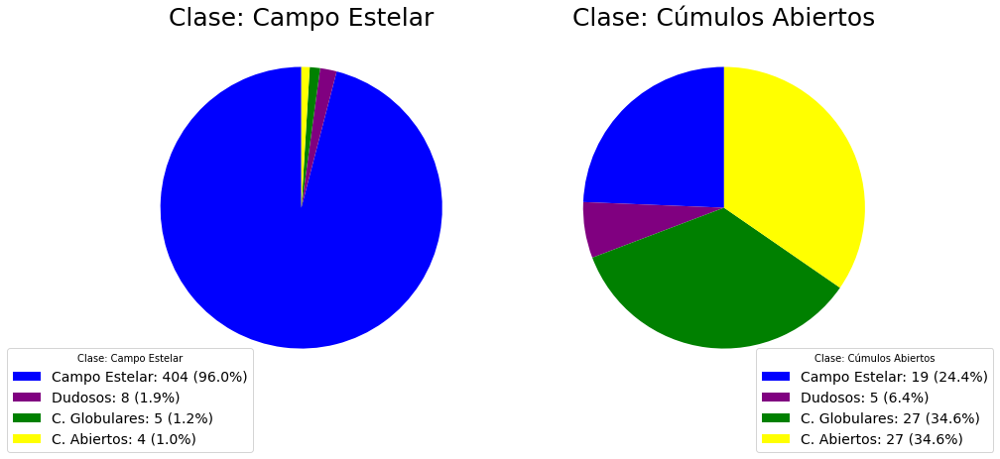

In [45]:
# Shared labels and colors
labels = ['Campo Estelar', 'Dudosos', 'C. Globulares', 'C. Abiertos']
colors = ['blue', 'purple', 'green', 'yellow']

#Totales Campo
# Values for each pie chart
sizes1 = [404, 8, 5, 4]
sizes2 = [19, 5, 27, 27]

def format_legend(labels, sizes):
    total = sum(sizes)
    return [
        f'{label}: {size} ({size / total * 100:.1f}%)'
        for label, size in zip(labels, sizes)
    ]

fig, axs = plt.subplots(1, 2, figsize=(14, 7))

# Pie chart 1
wedges1, _ = axs[0].pie(
    sizes1,
    colors=colors,
    startangle=90
)
axs[0].set_title('Clase: Campo Estelar', fontsize=25)

# Pie chart 2
wedges2, _ = axs[1].pie(
    sizes2,
    colors=colors,
    startangle=90
)
axs[1].set_title('Clase: Cúmulos Abiertos',fontsize=25)

# Create a unified legend (based on labels and first dataset here, but can use either)
legend_labels1 = format_legend(labels, sizes1)
legend_labels2 = format_legend(labels, sizes2)

# Add legend to the right of the second chart
fig.legend(
    wedges1,
    legend_labels1,
    title="Clase: Campo Estelar",
    loc="lower left",
    #bbox_to_anchor=(1.02, 0.6),
    fontsize=14
)

fig.legend(
    wedges2,
    legend_labels2,
    title="Clase: Cúmulos Abiertos",
    loc="lower right",
    #bbox_to_anchor=(1.02, 0.1),
    fontsize=14
)

#plt.tight_layout()
plt.show()


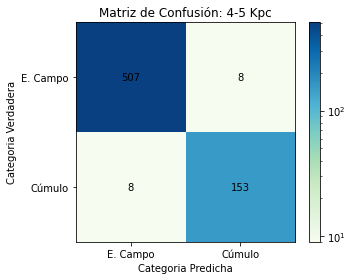

153 507 8 8
Precision: 0.9503105590062112
Recall: 0.9503105590062112
F1 Score: 0.9503105590062112


In [2]:
# Confusion matrix
array = np.array([[507, 8], [8, 153]])
# Define labels for rows and columns
labels = ["E. Campo", "Cúmulo"]

# Create the plot with a logarithmic color scale
plt.figure(figsize=(5, 4))  # Adjusted size to make the plot more compact
norm = mcolors.LogNorm(vmin=array.min() + 1, vmax=array.max())  # Log scale, vmin is adjusted to avoid log(0)
plt.imshow(array, interpolation="nearest", cmap="GnBu", norm=norm)
plt.colorbar()

# Add labels to x and y axes
plt.xticks([0, 1], labels)
plt.yticks([0, 1], labels)
plt.xlabel("Categoria Predicha")
plt.ylabel("Categoria Verdadera")
plt.title("Matriz de Confusión: 4-5 Kpc")

# Add text annotations
for i in range(array.shape[0]):
    for j in range(array.shape[1]):
        plt.text(j, i, f"{array[i, j]}", ha="center", va="center", color="black")

plt.tight_layout()  # Reduces the extra whitespace around the plot
plt.show()
# Extract the values
TN, FP = array[0, 0], array[0, 1]
FN, TP = array[1, 0], array[1, 1]

# Calculate precision, recall, and F1 score
precision = TP / (TP + FP)
recall = TP / (TP + FN)
print(TP, TN, FP, FN)
f1_score = 2 * (precision * recall) / (precision + recall)

print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)

# Comparación Cantat-Gaudin

In [147]:
catalogo_cantat=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\catalogo_cantat_gaudin.csv"
df = pd.read_csv(catalogo_cantat)
df

,Cluster,RA_ICRS,DE_ICRS,r50,nbstars07,pmRA*,pmDE,plx,Flag,AgeNN,...,DistPc,X,Y,Z,Rgc,SimbadName,_RA_icrs,_DE_icrs,GLAT,GLON
0,Melotte_22,56.601,24.114,1.274,952,20.077,-45.503,7.346,NN,7.89,...,128.0,-114.0,27.0,-51.0,8454.0,Cl Melotte 22,56.601,24.114,-23.614,166.462
1,UBC_19,56.336,29.827,0.254,34,2.705,-5.170,2.385,NN,6.84,...,416.0,-373.0,119.0,-138.0,8714.0,UBC 19,56.336,29.827,-19.480,162.215
2,NGC_1333,52.297,31.310,0.095,50,7.425,-9.865,3.344,NN,7.06,...,299.0,-260.0,103.0,-104.0,8601.0,NGC 1333,52.297,31.310,-20.505,158.343
3,UBC_199,67.449,25.422,0.135,55,3.007,-1.769,0.816,NN,9.06,...,1233.0,-1178.0,148.0,-333.0,9519.0,UBC 199,67.449,25.422,-15.669,172.800
4,Czernik_19,74.258,28.763,0.076,79,1.049,-2.126,0.367,NN,8.31,...,2586.0,-2542.0,262.0,-398.0,10885.0,Cl Czernik 19,74.258,28.763,-8.862,174.096
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2012,UPK_599,205.840,-38.576,0.711,87,-9.945,0.293,1.458,NN,7.29,...,652.0,416.0,-432.0,256.0,7935.0,UPK 599,205.840,-38.576,23.147,313.934
2013,Mamajek_4,276.635,-50.772,1.404,180,4.646,-21.051,2.224,NN,8.57,...,461.0,423.0,-121.0,-134.0,7917.0,Cl Mamajek 4,276.635,-50.772,-16.989,344.031
2014,UPK_645,270.167,-42.783,0.198,59,2.797,-2.844,1.430,NN,8.02,...,696.0,675.0,-124.0,-115.0,7665.0,UPK 645,270.167,-42.783,-9.513,349.522
2015,UPK_654,277.329,-34.528,0.308,60,1.165,-8.670,1.970,NN,7.90,...,519.0,54.0,-424.0,-294.0,8296.0,UPK 654,277.329,-34.528,-34.528,277.329


In [5]:
def kpc(x):
    x=abs(x)
    x=1/x
    return x


In [6]:

df = df.rename(columns={'plx': 'Kpc'})
df['Kpc'] = df['Kpc'].apply(kpc)

print(len(df))
df.head()


2017


,Cluster,RA_ICRS,DE_ICRS,r50,nbstars07,pmRA*,pmDE,Kpc,Flag,AgeNN,...,DistPc,X,Y,Z,Rgc,SimbadName,_RA_icrs,_DE_icrs,GLAT,GLON
0,Melotte_22,56.601,24.114,1.274,952,20.077,-45.503,0.136129,NN,7.89,...,128.0,-114.0,27.0,-51.0,8454.0,Cl Melotte 22,56.601,24.114,-23.614,166.462
1,UBC_19,56.336,29.827,0.254,34,2.705,-5.170,0.419287,NN,6.84,...,416.0,-373.0,119.0,-138.0,8714.0,UBC 19,56.336,29.827,-19.480,162.215
2,NGC_1333,52.297,31.310,0.095,50,7.425,-9.865,0.299043,NN,7.06,...,299.0,-260.0,103.0,-104.0,8601.0,NGC 1333,52.297,31.310,-20.505,158.343
3,UBC_199,67.449,25.422,0.135,55,3.007,-1.769,1.225490,NN,9.06,...,1233.0,-1178.0,148.0,-333.0,9519.0,UBC 199,67.449,25.422,-15.669,172.800
4,Czernik_19,74.258,28.763,0.076,79,1.049,-2.126,2.724796,NN,8.31,...,2586.0,-2542.0,262.0,-398.0,10885.0,Cl Czernik 19,74.258,28.763,-8.862,174.096


In [7]:
shell1_cantat = df[df['Kpc'] <= 4]
shell1_cantat = shell1_cantat[shell1_cantat['Kpc'] >= 3]

shell2_cantat = df[df['Kpc'] <= 5]
shell2_cantat = shell2_cantat[shell2_cantat['Kpc'] > 4]
print(len(shell1_cantat),len(shell2_cantat))

325 152


In [8]:
shell1_cantat

,Cluster,RA_ICRS,DE_ICRS,r50,nbstars07,pmRA*,pmDE,Kpc,Flag,AgeNN,...,DistPc,X,Y,Z,Rgc,SimbadName,_RA_icrs,_DE_icrs,GLAT,GLON
14,Berkeley_69,81.090,32.607,0.038,99,0.806,-1.937,3.861004,NN,8.90,...,3410.0,-3392.0,330.0,-110.0,11737.0,Cl Berkeley 69,81.090,32.607,-1.853,174.442
15,NGC_1893,80.724,33.444,0.085,123,-0.231,-1.410,3.745318,NN,6.64,...,3222.0,-3200.0,360.0,-91.0,11546.0,NGC 1893,80.724,33.444,-1.634,173.577
38,NGC_1857,80.031,39.336,0.062,92,0.553,-1.310,3.125000,NN,8.40,...,2900.0,-2840.0,582.0,63.0,11196.0,NGC 1857,80.031,39.336,1.259,168.414
39,Czernik_20,80.129,39.545,0.032,34,0.619,-1.583,3.787879,NN,9.22,...,3488.0,-3414.0,707.0,87.0,11775.0,Cl Czernik 20,80.129,39.545,1.440,168.286
42,UBC_432,79.031,39.518,0.054,28,0.323,-1.876,3.058104,NN,8.52,...,2904.0,-2838.0,612.0,37.0,11195.0,UBC 432,79.031,39.518,0.745,167.823
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1991,NGC_4052,180.446,-63.230,0.101,137,-6.836,0.069,3.095975,NN,8.52,...,2603.0,1197.0,-2311.0,-40.0,7507.0,NGC 4052,180.446,-63.230,-0.895,297.375
1993,Ruprecht_100,181.520,-62.624,0.047,48,-8.255,0.898,3.952569,NN,8.31,...,3373.0,1570.0,-2985.0,-12.0,7398.0,Cl Ruprecht 100,181.520,-62.624,-0.210,297.745
1994,UBC_516,182.541,-62.330,0.038,24,-4.784,0.490,3.676471,NN,8.46,...,3186.0,1503.0,-2809.0,8.0,7390.0,UBC 516,182.541,-62.330,0.157,298.160
1996,UBC_519,185.454,-60.400,0.060,27,-5.635,0.905,3.344482,NN,8.81,...,2746.0,1342.0,-2394.0,108.0,7396.0,UBC 519,185.454,-60.400,2.262,299.275


# Comparacion Castro-Ginard

In [149]:
catalogo_castro=r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\8 Semestre\Proyecto Teorico\Proyecto Teorico 20242\Gaia-DR3-Proyecto-Teorico-20242\catalogo_castro_ginard.csv"
df2 = pd.read_csv(catalogo_castro)
df2.columns

Index(['Seq', 'Cluster', 'RA_ICRS', 's_RA_ICRS', 'DE_ICRS', 's_DE_ICRS',
       'GLON', 's_GLON', 'GLAT', 's_GLAT', 'plx', 's_plx', 'pmRA', 's_pmRA',
       'pmDE', 's_pmDE', 'RV', 's_RV', 'Nmemb', 'NmembRV', 'Flag', 'logAge',
       'Dist', 'AV', '_RA_icrs', '_DE_icrs'],
      dtype='object')

In [10]:
df2 = df2.rename(columns={'plx': 'Kpc'})
df2['Kpc'] = df2['Kpc'].apply(kpc)

print(len(df2))
df2.head()

628


,Seq,Cluster,RA_ICRS,s_RA_ICRS,DE_ICRS,s_DE_ICRS,GLON,s_GLON,GLAT,s_GLAT,...,RV,s_RV,Nmemb,NmembRV,Flag,logAge,Dist,AV,_RA_icrs,_DE_icrs
0,271,UBC1272,68.71,0.10,38.39,0.07,163.66,0.07,-6.23,0.08,...,NaN,NaN,26,0,,7.877,1814.0,1.331,68.71,38.39
1,281,UBC1282,79.37,0.05,33.21,0.03,173.12,0.03,-2.70,0.04,...,1.14,0.47,16,2,,8.479,3415.0,0.806,79.37,33.21
2,282,UBC1283,81.91,0.09,33.31,0.07,174.25,0.06,-0.89,0.08,...,19.65,NaN,31,1,,8.482,2839.0,0.767,81.91,33.31
3,280,UBC1281,80.38,0.13,34.87,0.07,172.24,0.08,-1.06,0.09,...,NaN,NaN,17,0,,7.808,3603.0,1.582,80.38,34.87
4,276,UBC1277,77.75,0.12,36.37,0.11,169.77,0.08,-1.93,0.12,...,NaN,NaN,21,0,,7.686,1669.0,0.813,77.75,36.37


In [11]:
shell1_castro = df2[df2['Kpc'] <= 4]
shell1_castro = shell1_castro[shell1_castro['Kpc'] >= 3]

shell2_castro = df2[df2['Kpc'] <= 5]
shell2_castro = shell2_castro[shell2_castro['Kpc'] > 4]
print(len(shell1_castro),len(shell2_castro))

193 80


# Comparación Hunt

In [3]:
archivo = 'hunt_catalogo.csv'
df3 = pd.read_csv(archivo)
df3 = df3[df3["Type"] == "o"]
def kpc(x):
    x=abs(x)
    x=1/x
    return x
df3 = df3.rename(columns={'Plx': 'Kpc'})
df3['Kpc'] = df3['Kpc'].apply(kpc)
shell1_hunt = df3[df3['Kpc'] <= 4]
shell1_hunt= shell1_hunt[shell1_hunt["Kpc"]>=3]
print(len(shell1_hunt))

shell2_hunt = df3[df3['Kpc'] <= 5]
shell2_hunt= shell2_hunt[shell2_hunt["Kpc"]>4]
print(len(shell2_hunt))

1018
520


In [4]:
shell1_hunt

,Name,ID,Type,N,RA_ICRS,DE_ICRS,r50,pmRA,pmDE,Kpc,...,X,Y,Z,RV,isMerged,isGMMMemb,_RA_icrs,_DE_icrs,GLON,GLAT
44,Berkeley_69,242,o,216,81.090886,32.608154,0.065701,0.738993,-1.953736,3.659361,...,-11285.130269,307.806911,-73.830476,31.678628,0,0,81.090882,32.608163,174.441660,-1.8510
47,NGC_1893,4495,o,207,80.701845,33.426279,0.071378,-0.289832,-1.397974,3.390566,...,-10957.506074,318.953878,-54.603185,21.590430,0,0,80.701847,33.426285,173.581684,-1.6590
53,CWNU_1421,708,o,26,77.818586,34.190715,0.055291,-0.867599,-1.097827,3.053174,...,-10831.800082,401.452669,-124.119582,-7.690233,0,0,77.818590,34.190720,171.571990,-3.1730
71,UBC_1281,6683,o,62,80.480925,34.755082,0.235976,-0.271722,-1.679192,3.249373,...,-10994.048733,384.074311,-25.308730,NaN,0,0,80.480927,34.755089,172.382912,-1.0570
75,Czernik_21,1372,o,319,81.675587,36.018333,0.061113,2.184408,-0.891216,3.672127,...,-11390.080676,465.881730,55.617613,41.627529,0,0,81.675575,36.018337,171.887165,0.4591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7054,CWNU_2299,1044,o,23,183.560761,-59.496125,0.061634,-5.196376,0.929911,3.357727,...,-6700.100871,-2648.735319,176.537343,NaN,0,0,183.560807,-59.496130,298.220713,3.0350
7069,HSC_2616,3892,o,14,204.403218,-52.735879,0.078594,-8.645223,-3.311378,3.435005,...,-6280.147350,-2194.426661,495.482535,-40.401746,0,0,204.403282,-52.735864,309.988760,9.5020
7083,HSC_2626,3900,o,16,203.687824,-44.620556,0.078881,-6.511456,-1.154509,3.446408,...,-6179.103553,-2232.660359,952.594370,NaN,0,0,203.687865,-44.620551,310.995049,17.5700
7097,HSC_2554,3839,o,25,194.660757,-42.291878,0.082605,-7.420456,0.783307,3.005747,...,-6728.529575,-2035.061023,941.827387,NaN,0,0,194.660802,-42.291882,304.354935,20.5600


In [5]:
shell2_hunt

,Name,ID,Type,N,RA_ICRS,DE_ICRS,r50,pmRA,pmDE,Kpc,...,X,Y,Z,RV,isMerged,isGMMMemb,_RA_icrs,_DE_icrs,GLON,GLAT
49,HSC_1353,2886,o,14,79.858476,33.641424,0.050240,0.893582,-0.031843,4.808379,...,-12224.419580,503.359147,-121.328557,-6.925395,0,0,79.858471,33.641425,173.004344,-2.1150
78,CWNU_2206,1011,o,26,75.035211,34.378979,0.032932,0.345329,-1.046052,4.235079,...,-11825.138820,650.525653,-291.810585,NaN,0,0,75.035209,34.378984,170.034571,-4.8970
99,HSC_1320,2862,o,15,79.731427,38.451126,0.068643,0.841199,0.397812,4.672773,...,-11845.124922,723.356781,67.447463,-27.207578,0,0,79.731422,38.451124,169.005560,0.5607
108,King_17,4344,o,58,77.094365,39.071152,0.042004,-0.206941,-1.408761,4.177715,...,-11590.263053,781.724675,-16.352366,7.933286,0,0,77.094366,39.071158,167.297919,-0.7418
110,HSC_1310,2853,o,28,78.927313,39.641583,0.021571,0.594631,-0.658368,4.570569,...,-11849.952174,814.700208,79.575853,NaN,0,0,78.927309,39.641585,167.673071,0.7391
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7031,HSC_2477,3783,o,29,180.141521,-62.863003,0.060808,-6.410438,0.946780,4.600746,...,-6290.182016,-3569.315120,-23.240737,18.717316,0,0,180.141583,-62.863008,297.168543,-0.5619
7032,UBC_1511,6840,o,91,180.415659,-62.775096,0.036371,-7.421936,0.427142,4.863852,...,-6249.207406,-3632.585583,-16.197385,2.261945,0,0,180.415731,-62.775098,297.274356,-0.4514
7035,CWNU_2410,1090,o,77,183.082675,-61.969487,0.046269,-7.158282,0.701428,4.529967,...,-6250.009099,-3468.533240,54.128752,-28.695177,0,0,183.082743,-61.969490,298.354581,0.5542
7041,CWNU_2634,1194,o,133,183.677496,-61.026470,0.123016,-7.212894,0.547429,4.078647,...,-6430.920023,-3114.475959,111.038443,-27.855618,0,0,183.677562,-61.026472,298.497133,1.5290


# Dividir Tablas Catalogos Finales

In [7]:
input_file = "CATALOGO FINAL MEJOR MODELO SHELL 2.csv"  # Replace with your actual file name
df = pd.read_csv(input_file)

# Calculate the midpoint for splitting
midpoint = len(df) // 2

# Split the DataFrame into two parts (first and second halves)
df1 = df.iloc[:midpoint]
df2 = df.iloc[midpoint:]

# Save both parts to new CSV files, keeping the header
df1.to_csv("CATALOGO FINAL MEJOR MODELO SHELL2_parte1.csv", index=False)
df2.to_csv("CATALOGO FINAL MEJOR MODELO SHELL2_parte2.csv", index=False)



# Cúmulos Abiertos Finales

### Shell 1

In [26]:
cuadrantes_shell1={}
for j in range(8):
    folder_path = r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Datos Shell\shell1\clusters"+str(j+1)
    dataframes = {}
    for file_name in os.listdir(folder_path):
        if file_name.endswith('.csv'):
            file_path = os.path.join(folder_path, file_name)
            df = pd.read_csv(file_path)
            first_cols = ['phot_g_mean_mag','phot_bp_mean_mag', 'phot_rp_mean_mag',"parallax"]
            df = df[first_cols + [col for col in df.columns if col not in first_cols]]
            dataframes[file_name]=df
    cuadrantes_shell1["Q"+str(j+1)]=dataframes

In [24]:
cuadrantes_shell1

{'Q1': {'cluster_0.csv':     phot_g_mean_mag  phot_bp_mean_mag  phot_rp_mean_mag  parallax  Unnamed: 0  \
  0         16.504385         16.777021         16.082998  0.317232     3666830   
  1         17.653337         17.907545         17.233496  0.311568     3666914   
  2         17.540915         17.823246         17.101484  0.321511     3667431   
  3         18.267305         18.630150         17.746536  0.313078     6400115   
  4         18.060926         18.478176         17.485458  0.310309     6400243   
  ..              ...               ...               ...       ...         ...   
  72        18.297947         18.610718         17.810470  0.298215     6403842   
  73        18.278788         18.621824         17.833464  0.319134     6403869   
  74        18.371664         18.617447         17.904213  0.318521     6403883   
  75        18.227999         18.562279         17.738651  0.289830     6403997   
  76        17.961546         18.321090         17.438831  0.279

In [10]:
shell1_baseline_candidatos = pd.read_csv("candidatos_shell1_Baseline.csv")  # Replace with your actual file name
shell1_baseline_candidatos = [s[:-4] for s in shell1_baseline_candidatos['Archivo'].astype(str)]

shell1_optuna1_candidatos = pd.read_csv("candidatos_shell1_1condINTENTO2.csv")
shell1_optuna1_candidatos = [s[:-4] for s in shell1_optuna1_candidatos['Archivo'].astype(str)]

shell1_optuna2_candidatos = pd.read_csv("candidatos_shell1_2condINTENTO2.csv")
shell1_optuna2_candidatos = [s[:-4] for s in shell1_optuna2_candidatos['Archivo'].astype(str)]

shell1_optunaS_candidatos = pd.read_csv("candidatos_shell1_simplificado.csv")
shell1_optunaS_candidatos = [s[:-4] for s in shell1_optunaS_candidatos['Archivo'].astype(str)]


In [37]:
all_lists = {"Baseline": shell1_baseline_candidatos, "Optuna 1": shell1_optuna1_candidatos,
             "Optuna 2": shell1_optuna2_candidatos, "Optuna Simplificado":shell1_optunaS_candidatos}



# Step 1: Build the base data rows from cuadrantes_shell1
rows = []
for quadrant, clusters in cuadrantes_shell1.items():
    for cluster_filename in clusters:
        rows.append({
            "quadrant": quadrant,
            "cluster_id": cluster_filename
        })

# Step 2: Create the base DataFrame
df = pd.DataFrame(rows)

# Step 3: For each list, create a column with True/False indicating membership
for list_name, file_list in all_lists.items():
    # Convert file list to a set of tuples like ("Q1", "cluster_66.csv")
    file_set = set()
    for fname in file_list:
        quad, clus = fname.split("_", 1)
        file_set.add((quad, clus))
    
    # Create the boolean column
    df[list_name] = df.apply(
        lambda row: (row["quadrant"], row["cluster_id"]) in file_set,
        axis=1
    )

# Print or save the result
df


,quadrant,cluster_id,Baseline,Optuna 1,Optuna 2,Optuna Simplificado
0,Q1,cluster_0.csv,False,False,False,False
1,Q1,cluster_1.csv,False,False,False,False
2,Q1,cluster_10.csv,True,True,True,True
3,Q1,cluster_11.csv,False,False,False,False
4,Q1,cluster_12.csv,True,False,True,False
...,...,...,...,...,...,...
675,Q8,cluster_95.csv,False,False,False,False
676,Q8,cluster_96.csv,False,False,False,False
677,Q8,cluster_97.csv,False,False,False,False
678,Q8,cluster_98.csv,False,False,False,False


In [54]:
df.to_csv("CATALOGO FINAL SHELL 1.csv")

In [51]:
sampled_df = (
    df.groupby("quadrant", group_keys=False)
      .apply(lambda x: x.sample(n=4))  # set random_state for reproducibility
)

# Reset index if desired
sampled_df = sampled_df.reset_index(drop=True)

# Print or return the sampled DataFrame
sampled_df

C:\Users\juang\AppData\Local\Temp/ipykernel_16640/109083967.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df.groupby("quadrant", group_keys=False)


,quadrant,cluster_id,Baseline,Optuna 1,Optuna 2,Optuna Simplificado
0,Q1,cluster_52.csv,False,False,False,False
1,Q1,cluster_76.csv,False,False,False,False
2,Q1,cluster_4.csv,True,True,True,True
3,Q1,cluster_44.csv,False,False,False,False
4,Q2,cluster_78.csv,False,False,False,False
5,Q2,cluster_3.csv,True,True,True,False
6,Q2,cluster_34.csv,False,False,False,False
7,Q2,cluster_66.csv,False,False,False,False
8,Q3,cluster_8.csv,False,False,False,False
9,Q3,cluster_2.csv,False,True,False,False


In [53]:
sampled_df.to_csv("CATALOGO FINAL SHELL 1 EJEMPLO.csv")

In [98]:
# Shell1
filenames = ["candidatos_shell1_Baseline.csv", "candidatos_shell1_1condINTENTO2.csv", "candidatos_shell1_2condINTENTO2.csv", "candidatos_shell1_simplificado.csv"]

# Set to store unique 'Archivo' values where 'Clasificación' == True
solo_true = set()
true_dudosos = set()
globulares= set()
# Iterate over each file
for file in filenames:
    # Read CSV
    df = pd.read_csv(file)
    
    # Filter rows where 'Clasificación' is True
    true_rows = df[df["Clasificacion"] == "True"]
    dudosos_rows=df[df["Clasificacion"]== "Dudoso"]
    globular_rows=df[df["Clasificacion"]=="Globular"]
    # Add 'Archivo' values to the set
    solo_true.update(true_rows["Archivo"].tolist())
    true_dudosos.update(true_rows["Archivo"].tolist())
    true_dudosos.update(dudosos_rows["Archivo"].tolist())
    globulares.update(globular_rows["Archivo"].tolist())

# Convert the set to a list if needed
solo_true = list(solo_true)
solo_true = sorted(solo_true)
true_dudosos = list(true_dudosos)
true_dudosos = sorted(true_dudosos)
globulares = list(globulares)
globulares = sorted(globulares)
# Print the final unique list
print(solo_true)
print(len(solo_true))
print(true_dudosos)
print(len(true_dudosos))
print(globulares)
print(len(globulares))


['Q1_cluster_66.csv.png', 'Q1_cluster_79.csv.png', 'Q1_cluster_86.csv.png', 'Q2_cluster_0.csv.png', 'Q2_cluster_1.csv.png', 'Q2_cluster_2.csv.png', 'Q2_cluster_23.csv.png', 'Q2_cluster_3.csv.png', 'Q2_cluster_30.csv.png', 'Q2_cluster_35.csv.png', 'Q2_cluster_39.csv.png', 'Q2_cluster_62.csv.png', 'Q2_cluster_95.csv.png', 'Q2_cluster_98.csv.png', 'Q2_cluster_99.csv.png', 'Q3_cluster_1.csv.png', 'Q3_cluster_13.csv.png', 'Q3_cluster_23.csv.png', 'Q3_cluster_25.csv.png', 'Q3_cluster_34.csv.png', 'Q3_cluster_40.csv.png', 'Q3_cluster_42.csv.png', 'Q3_cluster_44.csv.png', 'Q3_cluster_45.csv.png', 'Q3_cluster_46.csv.png', 'Q3_cluster_54.csv.png', 'Q3_cluster_55.csv.png', 'Q3_cluster_63.csv.png', 'Q3_cluster_69.csv.png', 'Q3_cluster_73.csv.png', 'Q3_cluster_74.csv.png', 'Q4_cluster_29.csv.png', 'Q4_cluster_37.csv.png', 'Q4_cluster_43.csv.png', 'Q4_cluster_6.csv.png', 'Q4_cluster_7.csv.png', 'Q5_cluster_10.csv.png', 'Q5_cluster_11.csv.png', 'Q5_cluster_12.csv.png', 'Q5_cluster_27.csv.png', 'Q5_cl

C:\Users\juang\AppData\Local\Temp/ipykernel_16640/3055890330.py:50: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


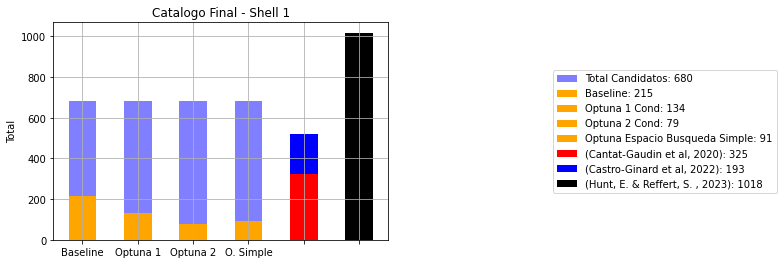

In [18]:
#Shell 1
labels = ['Baseline',"Optuna 1", "Optuna 2", "O. Simple", '', ""]  # Each label gets its own stacked bar

# Values for each stacked segment
total=680
baseline=215
optuna_1=134
optuuna_2=79
optuna_simple=91


###Shell 2
#Modelo Optimizado (con shell1) Optuna 2 cond: (69,430)  [ESTRICTO V2]
#Modelo Laxo (27,472)
#Modelo Optimizado (con Shell2) 2 cond: (79,420)
#Modelo Optimizados 1 cond: (96,403)
#Modelo Simplificado: (78,421)


x = np.arange(len(labels))  # the label locations
width = 0.5                 # width of each bar

fig, ax = plt.subplots()

# Stacked bar for 'A'
bar_total= ax.bar(x[0], 680, width, alpha=0.5, label="Total Candidatos: 680",color="blue")
bar_baselien=ax.bar(x[0],baseline,width,label="Baseline: 215",color="orange")
bar_total= ax.bar(x[1], 680, width, alpha=0.5,color="blue")
bar_optuna1=ax.bar(x[1],optuna_1,width,label="Optuna 1 Cond: 134",color="orange")
bar_total= ax.bar(x[2], 680, width, alpha=0.5,color="blue")
bar_optuna2=ax.bar(x[2],optuuna_2,width,label="Optuna 2 Cond: 79",color="orange")
bar_total= ax.bar(x[3], 680, width, alpha=0.5,color="blue")
bar_optuna3=ax.bar(x[3],optuna_simple,width,label="Optuna Espacio Busqueda Simple: 91",color="orange")


bar_cantat= ax.bar(x[4], 325, width, label= "(Cantat-Gaudin et al, 2020): 325", color="red")
bar_castro= ax.bar(x[4], 193, width,bottom=325, label= "(Castro-Ginard et al, 2022): 193", color="blue")
bar_hunt=ax.bar(x[5], 1018, width, label= "(Hunt, E. & Reffert, S. , 2023): 1018", color="black")


# Add labels and legend
ax.set_ylabel('Total')
ax.set_title("Catalogo Final - Shell 1")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend(loc='center left', bbox_to_anchor=(1.479, 0.5))
#ax.legend()
plt.grid(True)
#plt.yscale("log")
plt.tight_layout()
plt.show()


In [8]:
cuadrantes_shell1={}
for j in range(8):
    folder_path = r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Datos Shell\shell1\clusters"+str(j+1)
    dataframes = {}
    for file_name in os.listdir(folder_path):
        if file_name.endswith('.csv'):
            file_path = os.path.join(folder_path, file_name)
            df = pd.read_csv(file_path)
            first_cols = ['phot_g_mean_mag','phot_bp_mean_mag', 'phot_rp_mean_mag',"parallax"]
            df = df[first_cols + [col for col in df.columns if col not in first_cols]]
            dataframes[file_name]=df
    cuadrantes_shell1["Q"+str(j+1)]=dataframes

In [100]:
solo_true= [s[:-4] for s in solo_true]
globulares=[s[:-4] for s in globulares]

dudosos=[s[:-4] for s in true_dudosos]
dudosos = [item for item in dudosos if item not in solo_true]


In [101]:
filtered_cuadrantes_shell1 = {}

# Process each item in the input list
for item in solo_true:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell1 and cluster in cuadrantes_shell1[quadrant]:
        if quadrant not in filtered_cuadrantes_shell1:
            filtered_cuadrantes_shell1[quadrant] = {}
        filtered_cuadrantes_shell1[quadrant][cluster] = cuadrantes_shell1[quadrant][cluster]

In [31]:
filtered_cuadrantes_shell1 = {}

# Process each item in the input list
for item in shell1_optunaS_candidatos:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell1 and cluster in cuadrantes_shell1[quadrant]:
        if quadrant not in filtered_cuadrantes_shell1:
            filtered_cuadrantes_shell1[quadrant] = {}
        filtered_cuadrantes_shell1[quadrant][cluster] = cuadrantes_shell1[quadrant][cluster]

In [32]:
total=0
for i in range(8):
    sumando=len(filtered_cuadrantes_shell1["Q"+str(i+1)].keys())
    total=total+sumando
total

91

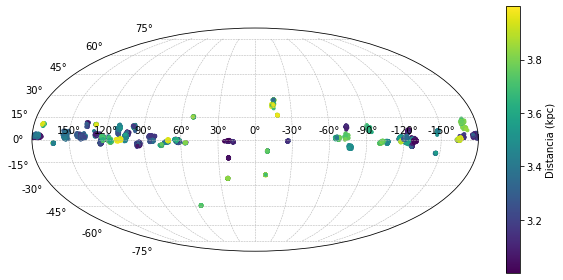

In [33]:
# Accumulate parallaxes
paralajes1 = []
for cua in filtered_cuadrantes_shell1.values():
    for clu in cua.values():
        paralajes1.append(list(clu["parallax"]))
paralajes1 = [item for sublist in paralajes1 for item in sublist]

# Convert parallax (mas) to distance (kpc)
distancias1 = [1 / p for p in paralajes1]  # Assumes parallax in mas → distance in kpc

# Accumulate RA
ra_1 = []
for cua in filtered_cuadrantes_shell1.values():
    for clu in cua.values():
        ra_1.append(list(clu["ra"]))
ra_1 = [item for sublist in ra_1 for item in sublist]

# Accumulate Dec
dec_1 = []
for cua in filtered_cuadrantes_shell1.values():
    for clu in cua.values():
        dec_1.append(list(clu["dec"]))
dec_1 = [item for sublist in dec_1 for item in sublist]

# Convert to numpy arrays
ra = np.array(ra_1)
dec = np.array(dec_1)
dis = distancias1

# Convert to Galactic Coordinates
coords = SkyCoord(ra=ra * u.degree, dec=dec * u.degree, frame='icrs', equinox='J2016.0')
galactic = coords.galactic

# Convert to radians for plotting
l_rad = np.deg2rad(galactic.l.wrap_at(180 * u.degree).value)
b_rad = np.deg2rad(galactic.b.value)

# Plot in Mollweide Projection
plt.figure(figsize=(10, 7))
ax = plt.subplot(111, projection="mollweide")
scatter = ax.scatter(l_rad, b_rad, c=dis, cmap="viridis", marker='.')
ax.grid(True, linestyle='--', linewidth=0.5)
ax.set_xticklabels(['150°', '120°', '90°', '60°', '30°', '0°', '-30°', '-60°', '-90°', '-120°', '-150°'])
cbar = plt.colorbar(scatter, shrink=0.7)
cbar.set_label('Distancia (kpc)')
#plt.title("Coordenadas Galácticas: Modelo Espacio Busqueda Simple - Shell 1")
plt.show()



In [102]:
filtered_cuadrantes_shell1_globulares = {}

# Process each item in the input list
for item in globulares:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell1 and cluster in cuadrantes_shell1[quadrant]:
        #print(quadrant)
        #print(cluster)
        if quadrant not in filtered_cuadrantes_shell1_globulares:
            filtered_cuadrantes_shell1_globulares[quadrant] = {}
        filtered_cuadrantes_shell1_globulares[quadrant][cluster] = cuadrantes_shell1[quadrant][cluster]

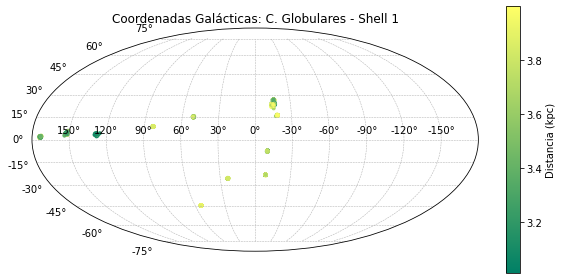

In [23]:
# Accumulate parallaxes
paralajes1 = []
for cua in filtered_cuadrantes_shell1_globulares.values():
    for clu in cua.values():
        paralajes1.append(list(clu["parallax"]))
paralajes1 = [item for sublist in paralajes1 for item in sublist]

# Convert parallax (mas) to distance (kpc)
distancias1 = [1 / p for p in paralajes1]  # Assumes parallax in mas → distance in kpc

# Accumulate RA
ra_1 = []
for cua in filtered_cuadrantes_shell1_globulares.values():
    for clu in cua.values():
        ra_1.append(list(clu["ra"]))
ra_1 = [item for sublist in ra_1 for item in sublist]

# Accumulate Dec
dec_1 = []
for cua in filtered_cuadrantes_shell1_globulares.values():
    for clu in cua.values():
        dec_1.append(list(clu["dec"]))
dec_1 = [item for sublist in dec_1 for item in sublist]

# Convert to numpy arrays
ra = np.array(ra_1)
dec = np.array(dec_1)
dis = distancias1

# Convert to Galactic Coordinates
coords = SkyCoord(ra=ra * u.degree, dec=dec * u.degree, frame='icrs', equinox='J2016.0')
galactic = coords.galactic

# Convert to radians for plotting
l_rad = np.deg2rad(galactic.l.wrap_at(180 * u.degree).value)
b_rad = np.deg2rad(galactic.b.value)

# Plot in Mollweide Projection
plt.figure(figsize=(10, 7))
ax = plt.subplot(111, projection="mollweide")
scatter = ax.scatter(l_rad, b_rad, c=dis, cmap="summer", marker='.')
ax.grid(True, linestyle='--', linewidth=0.5)
ax.set_xticklabels(['150°', '120°', '90°', '60°', '30°', '0°', '-30°', '-60°', '-90°', '-120°', '-150°'])
cbar = plt.colorbar(scatter, shrink=0.7)
cbar.set_label('Distancia (kpc)')
plt.title("Coordenadas Galácticas: C. Globulares - Shell 1")
plt.show()


In [103]:
filtered_cuadrantes_shell1_dudosos = {}

# Process each item in the input list
for item in dudosos:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell1 and cluster in cuadrantes_shell1[quadrant]:
        #print(quadrant)
        #print(cluster)
        if quadrant not in filtered_cuadrantes_shell1_dudosos:
            filtered_cuadrantes_shell1_dudosos[quadrant] = {}
        filtered_cuadrantes_shell1_dudosos[quadrant][cluster] = cuadrantes_shell1[quadrant][cluster]

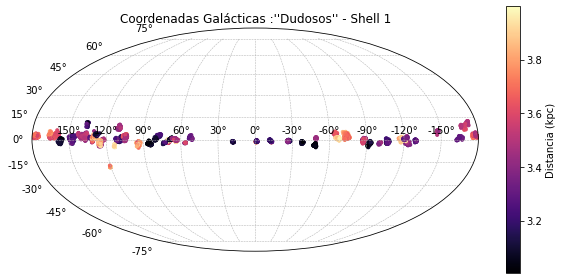

In [25]:
# Accumulate parallaxes
paralajes1 = []
for cua in filtered_cuadrantes_shell1_dudosos.values():
    for clu in cua.values():
        paralajes1.append(list(clu["parallax"]))
paralajes1 = [item for sublist in paralajes1 for item in sublist]

# Convert parallax (mas) to distance (kpc)
distancias1 = [1 / p for p in paralajes1]  # Assumes parallax in mas → distance in kpc

# Accumulate RA
ra_1 = []
for cua in filtered_cuadrantes_shell1_dudosos.values():
    for clu in cua.values():
        ra_1.append(list(clu["ra"]))
ra_1 = [item for sublist in ra_1 for item in sublist]

# Accumulate Dec
dec_1 = []
for cua in filtered_cuadrantes_shell1_dudosos.values():
    for clu in cua.values():
        dec_1.append(list(clu["dec"]))
dec_1 = [item for sublist in dec_1 for item in sublist]

# Convert to numpy arrays
ra = np.array(ra_1)
dec = np.array(dec_1)
dis = distancias1

# Convert to Galactic Coordinates
coords = SkyCoord(ra=ra * u.degree, dec=dec * u.degree, frame='icrs', equinox='J2016.0')
galactic = coords.galactic

# Convert to radians for plotting
l_rad = np.deg2rad(galactic.l.wrap_at(180 * u.degree).value)
b_rad = np.deg2rad(galactic.b.value)

# Plot in Mollweide Projection
plt.figure(figsize=(10, 7))
ax = plt.subplot(111, projection="mollweide")
scatter = ax.scatter(l_rad, b_rad, c=dis, cmap="magma", marker='.')
ax.grid(True, linestyle='--', linewidth=0.5)
ax.set_xticklabels(['150°', '120°', '90°', '60°', '30°', '0°', '-30°', '-60°', '-90°', '-120°', '-150°'])
cbar = plt.colorbar(scatter, shrink=0.7)
cbar.set_label('Distancia (kpc)')
plt.title("Coordenadas Galácticas :''Dudosos'' - Shell 1")
plt.show()


In [94]:
filtered_cuadrantes_shell1 = {}

# Process each item in the input list
for item in shell1_optuna1_candidatos:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell1 and cluster in cuadrantes_shell1[quadrant]:
        if quadrant not in filtered_cuadrantes_shell1:
            filtered_cuadrantes_shell1[quadrant] = {}
        filtered_cuadrantes_shell1[quadrant][cluster] = cuadrantes_shell1[quadrant][cluster]

In [95]:
catalogo_final_galan_shell1=[]
for quadrant, clusters in filtered_cuadrantes_shell1.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_shell1.append(cluster_summary)
        
catalogo_final_galan_shell1 = pd.concat(catalogo_final_galan_shell1, ignore_index=True)



Centroid RA: 251.8128 deg
Centroid Dec: -1.9334 deg
Centroid Distance: 3620.09 pc
Radius: 191.2133507169164

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.225 ± 0.007 mas/yr
Mean Proper Motion Dec: -6.800 ± 0.005 mas/yr
Mean Radial Velocity: -47.83 ± 4.38 km/s
Centroid RA: 294.9912 deg
Centroid Dec: -30.9658 deg
Centroid Distance: 3819.54 pc
Radius: 108.36229780123567

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -3.423 ± 0.008 mas/yr
Mean Proper Motion Dec: -9.314 ± 0.006 mas/yr
Mean Radial Velocity: 166.11 ± 2.07 km/s
Centroid RA: 261.9413 deg
Centroid Dec: -5.0627 deg
Centroid Distance: 3644.51 pc
Radius: 66.00912013624023

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.328 ± 0.005 mas/yr
Mean Proper Motion Dec: -5.148 ± 0.004 mas/yr
Mean Radial Velocity: -121.77 ± 0.25 km/s
Centroid RA: 261.9223 deg
Centroid Dec: -5.0676 deg
Centroid Distance: 3894.03 pc
Radius: 53.504642445782096

----- Cluster Kinematic Properties -----


In [96]:
catalogo_final_galan_shell1

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q1,cluster_10.csv,181,251.812751,-1.933356,3620.092100,15.731751,26.318134,191.213351,-0.225467,0.006601,-6.800178,0.005207,-47.833760,4.382477
1,Q1,cluster_13.csv,96,294.991197,-30.965835,3819.536708,8.789178,-23.265830,108.362298,-3.422927,0.007824,-9.313524,0.006443,166.111370,2.068216
2,Q1,cluster_15.csv,57,261.941302,-5.062655,3644.505564,18.427665,16.038210,66.009120,-0.327900,0.004973,-5.148274,0.003700,-121.774586,0.251270
3,Q1,cluster_16.csv,55,261.922339,-5.067567,3894.025515,18.413382,16.052083,53.504642,-0.366781,0.004056,-5.156519,0.002982,-121.581077,0.192287
4,Q1,cluster_4.csv,86,279.109251,-23.895941,3050.315582,9.904116,-7.555511,28.865865,9.794714,0.005263,-5.736100,0.004186,-150.648644,0.437288
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129,Q8,cluster_5.csv,167,287.707054,-60.019810,3199.693982,336.453446,-25.629765,104.405001,-3.175599,0.005492,-4.009078,0.005454,NaN,NaN
130,Q8,cluster_6.csv,68,287.735874,-60.035330,3551.132779,336.439391,-25.646724,49.201976,-3.115701,0.006348,-4.019328,0.006249,-16.373705,1.710349
131,Q8,cluster_65.csv,95,255.168631,-44.593692,3122.788695,342.037532,-1.468332,66.959951,-1.050687,0.007436,-2.776877,0.005936,57.918553,0.525925
132,Q8,cluster_67.csv,184,251.265810,-47.266881,3061.602577,338.249447,-1.062058,68.603064,-0.977937,0.002871,-2.282843,0.002425,-30.939042,0.273350


In [116]:
# Load the external CSV file
info_df = pd.read_csv("candidatos_shell1_1condINTENTO2.csv")

# Step 1: Strip ".png" from 'Archivo' to match 'quadrant' + '_' + 'cluster_id'
info_df["Archivo_clean"] = info_df["Archivo"].str.replace(".png", "", regex=False)

# Step 2: Create a join key in the main df to match against 'Archivo_clean'
catalogo_final_galan_shell1["Archivo_clean"] = catalogo_final_galan_shell1["quadrant"] + "_" + catalogo_final_galan_shell1["cluster_name"]

# Step 3: Merge on the cleaned 'Archivo' identifier
merged_df = catalogo_final_galan_shell1.merge(info_df[["Archivo_clean", "Clasificacion", "Valor"]],
                     on="Archivo_clean", how="left")

# Optional: drop the helper column if not needed
merged_df.drop(columns="Archivo_clean", inplace=True)

# Print or save result
merged_df


,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err,Clasificacion,Valor
0,Q1,cluster_10.csv,181,251.812751,-1.933356,3620.092100,15.731751,26.318134,191.213351,-0.225467,0.006601,-6.800178,0.005207,-47.833760,4.382477,Globular,0.961119
1,Q1,cluster_13.csv,96,294.991197,-30.965835,3819.536708,8.789178,-23.265830,108.362298,-3.422927,0.007824,-9.313524,0.006443,166.111370,2.068216,Globular,0.995630
2,Q1,cluster_15.csv,57,261.941302,-5.062655,3644.505564,18.427665,16.038210,66.009120,-0.327900,0.004973,-5.148274,0.003700,-121.774586,0.251270,Globular,0.911861
3,Q1,cluster_16.csv,55,261.922339,-5.067567,3894.025515,18.413382,16.052083,53.504642,-0.366781,0.004056,-5.156519,0.002982,-121.581077,0.192287,Globular,0.997050
4,Q1,cluster_4.csv,86,279.109251,-23.895941,3050.315582,9.904116,-7.555511,28.865865,9.794714,0.005263,-5.736100,0.004186,-150.648644,0.437288,Globular,0.887706
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129,Q8,cluster_5.csv,167,287.707054,-60.019810,3199.693982,336.453446,-25.629765,104.405001,-3.175599,0.005492,-4.009078,0.005454,NaN,NaN,True,0.999307
130,Q8,cluster_6.csv,68,287.735874,-60.035330,3551.132779,336.439391,-25.646724,49.201976,-3.115701,0.006348,-4.019328,0.006249,-16.373705,1.710349,True,0.999491
131,Q8,cluster_65.csv,95,255.168631,-44.593692,3122.788695,342.037532,-1.468332,66.959951,-1.050687,0.007436,-2.776877,0.005936,57.918553,0.525925,Dudoso,0.988313
132,Q8,cluster_67.csv,184,251.265810,-47.266881,3061.602577,338.249447,-1.062058,68.603064,-0.977937,0.002871,-2.282843,0.002425,-30.939042,0.273350,True,0.979714


In [117]:
merged_df.to_csv("CATALOGO FINAL MEJOR MODELO SHELL1.csv")

In [104]:
catalogo_final_galan_abiertos_shell1=[]
for quadrant, clusters in filtered_cuadrantes_shell1.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_abiertos_shell1.append(cluster_summary)
        
catalogo_final_galan_abiertos_shell1 = pd.concat(catalogo_final_galan_abiertos_shell1, ignore_index=True)



Centroid RA: 268.0020 deg
Centroid Dec: -28.5351 deg
Centroid Distance: 3063.05 pc
Radius: 46.471625100523646

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.198 ± 0.004 mas/yr
Mean Proper Motion Dec: -1.968 ± 0.002 mas/yr
Mean Radial Velocity: -25.14 ± 0.51 km/s
Centroid RA: 280.6151 deg
Centroid Dec: -6.4404 deg
Centroid Distance: 3163.06 pc
Radius: 31.21675987445588

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.351 ± 0.004 mas/yr
Mean Proper Motion Dec: -2.278 ± 0.004 mas/yr
Mean Radial Velocity: 49.99 ± 3.44 km/s
Centroid RA: 280.8637 deg
Centroid Dec: -5.8134 deg
Centroid Distance: 3410.28 pc
Radius: 66.33225788036725

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -1.021 ± 0.002 mas/yr
Mean Proper Motion Dec: -3.108 ± 0.002 mas/yr
Mean Radial Velocity: 61.95 ± 0.13 km/s
Centroid RA: 259.5727 deg
Centroid Dec: 42.7085 deg
Centroid Distance: 3426.74 pc
Radius: 298.8242702900226

----- Cluster Kinematic Properties -----
Mean

In [105]:
catalogo_final_galan_abiertos_shell1

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q1,cluster_66.csv,155,268.001988,-28.535079,3063.049605,1.065410,-0.993359,46.471625,-0.197941,0.003586,-1.968345,0.002324,-25.137836,0.510703
1,Q1,cluster_79.csv,61,280.615123,-6.440437,3163.056545,26.178862,-0.946262,31.216760,-0.351182,0.004444,-2.277538,0.003763,49.992072,3.444478
2,Q1,cluster_86.csv,375,280.863666,-5.813425,3410.282806,26.849593,-0.879560,66.332258,-1.020794,0.002216,-3.108099,0.001928,61.954622,0.131949
3,Q2,cluster_0.csv,173,259.572651,42.708545,3426.739799,67.851078,34.598254,298.824270,-4.897229,0.006893,-0.727115,0.007295,-263.410920,5.038734
4,Q2,cluster_1.csv,364,250.522881,36.483637,3364.533417,59.050456,40.834770,300.755774,-3.132566,0.003847,-2.497030,0.004637,-37.494814,1.003092
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,Q8,cluster_3.csv,175,265.201558,-53.715373,3042.622958,338.136547,-11.993421,24.773824,3.238927,0.004459,-17.664667,0.003691,18.457393,0.308266
92,Q8,cluster_5.csv,167,287.707054,-60.019810,3199.693982,336.453446,-25.629765,104.405001,-3.175599,0.005492,-4.009078,0.005454,NaN,NaN
93,Q8,cluster_6.csv,68,287.735874,-60.035330,3551.132779,336.439391,-25.646724,49.201976,-3.115701,0.006348,-4.019328,0.006249,-16.373705,1.710349
94,Q8,cluster_67.csv,184,251.265810,-47.266881,3061.602577,338.249447,-1.062058,68.603064,-0.977937,0.002871,-2.282843,0.002425,-30.939042,0.273350


In [24]:
catalogo_final_galan_abiertos_shell1.to_csv("catalogo_final_cabiertos_shell1.csv")

In [28]:
catalogo_final_galan_dudosos_shell1=[]
for quadrant, clusters in filtered_cuadrantes_shell1_dudosos.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_dudosos_shell1.append(cluster_summary)
        
catalogo_final_galan_dudosos_shell1 = pd.concat(catalogo_final_galan_dudosos_shell1, ignore_index=True)



Centroid RA: 286.6892 deg
Centroid Dec: 3.5384 deg
Centroid Distance: 3070.19 pc
Radius: 46.69751418266727

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -1.296 ± 0.005 mas/yr
Mean Proper Motion Dec: -3.582 ± 0.004 mas/yr
Mean Radial Velocity: 9.59 ± 1.46 km/s
Centroid RA: 274.5969 deg
Centroid Dec: -18.4083 deg
Centroid Distance: 3642.64 pc
Radius: 62.59598545445732

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: 0.128 ± 0.005 mas/yr
Mean Proper Motion Dec: -2.058 ± 0.004 mas/yr
Mean Radial Velocity: 19.87 ± 0.11 km/s
Centroid RA: 268.1579 deg
Centroid Dec: -28.6749 deg
Centroid Distance: 3722.32 pc
Radius: 52.361916392846545

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.405 ± 0.004 mas/yr
Mean Proper Motion Dec: -2.174 ± 0.003 mas/yr
Mean Radial Velocity: -5.73 ± 0.15 km/s
Centroid RA: 273.4586 deg
Centroid Dec: -18.7122 deg
Centroid Distance: 3204.53 pc
Radius: 59.44544866630756

----- Cluster Kinematic Properties -----
Mean P

In [29]:
catalogo_final_galan_dudosos_shell1

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q1,cluster_47.csv,110,286.689228,3.538368,3070.192204,37.829047,-1.787278,46.697514,-1.295523,0.004538,-3.582165,0.004146,9.594758,1.456358
1,Q1,cluster_55.csv,54,274.596870,-18.408264,3642.642421,12.853250,-1.297135,62.595985,0.128090,0.005441,-2.058375,0.004227,19.865352,0.109329
2,Q1,cluster_58.csv,153,268.157878,-28.674938,3722.321933,1.014703,-1.182360,52.361916,-0.404591,0.004217,-2.174334,0.002734,-5.731104,0.146263
3,Q1,cluster_64.csv,128,273.458563,-18.712183,3204.529084,12.072374,-0.492638,59.445449,-0.507070,0.003741,-2.026858,0.002870,28.580301,0.139325
4,Q1,cluster_65.csv,133,268.099470,-28.525028,3241.776082,1.117690,-1.061943,67.810497,-0.263302,0.003837,-2.146017,0.002501,-25.540245,0.262108
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63,Q7,cluster_90.csv,78,158.955231,-60.488773,3171.371838,286.974581,-1.888952,57.693154,-5.510323,0.005794,2.742791,0.005458,3.990234,1.693067
64,Q7,cluster_93.csv,67,170.697909,-60.586318,3064.926119,292.255496,0.434743,52.363614,-6.300499,0.004722,1.716601,0.004317,NaN,NaN
65,Q7,cluster_96.csv,67,179.228983,-62.821194,3889.284826,296.752181,-0.605455,65.609151,-5.534970,0.003821,0.701500,0.003904,-9.224487,2.030589
66,Q7,cluster_98.csv,244,179.047354,-62.059856,3446.697824,296.509313,0.120983,92.480976,-6.322660,0.002534,1.013807,0.002560,9.315979,0.253724


In [27]:
catalogo_final_galan_dudosos_shell1.to_csv("catalogo_final_dudosos_shell1.csv")

In [30]:
catalogo_final_galan_globulares_shell1=[]
for quadrant, clusters in filtered_cuadrantes_shell1_globulares.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_globulares_shell1.append(cluster_summary)
        
catalogo_final_galan_globulares_shell1 = pd.concat(catalogo_final_galan_globulares_shell1, ignore_index=True)



Centroid RA: 251.8128 deg
Centroid Dec: -1.9334 deg
Centroid Distance: 3620.09 pc
Radius: 191.2133507169164

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.225 ± 0.007 mas/yr
Mean Proper Motion Dec: -6.800 ± 0.005 mas/yr
Mean Radial Velocity: -47.83 ± 4.38 km/s
Centroid RA: 295.0025 deg
Centroid Dec: -30.9747 deg
Centroid Distance: 3355.90 pc
Radius: 110.09342545807284

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -3.469 ± 0.011 mas/yr
Mean Proper Motion Dec: -9.308 ± 0.010 mas/yr
Mean Radial Velocity: nan ± nan km/s
Centroid RA: 294.9912 deg
Centroid Dec: -30.9658 deg
Centroid Distance: 3819.54 pc
Radius: 108.36229780123567

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -3.423 ± 0.008 mas/yr
Mean Proper Motion Dec: -9.314 ± 0.006 mas/yr
Mean Radial Velocity: 166.11 ± 2.07 km/s
Centroid RA: 261.9413 deg
Centroid Dec: -5.0627 deg
Centroid Distance: 3644.51 pc
Radius: 66.00912013624023

----- Cluster Kinematic Properties -----
Mean

In [31]:
catalogo_final_galan_globulares_shell1

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q1,cluster_10.csv,181,251.812751,-1.933356,3620.092100,15.731751,26.318134,191.213351,-0.225467,0.006601,-6.800178,0.005207,-47.833760,4.382477
1,Q1,cluster_12.csv,84,295.002472,-30.974742,3355.901806,8.783370,-23.277843,110.093425,-3.469297,0.011316,-9.308107,0.009574,NaN,NaN
2,Q1,cluster_13.csv,96,294.991197,-30.965835,3819.536708,8.789178,-23.265830,108.362298,-3.422927,0.007824,-9.313524,0.006443,166.111370,2.068216
3,Q1,cluster_15.csv,57,261.941302,-5.062655,3644.505564,18.427665,16.038210,66.009120,-0.327900,0.004973,-5.148274,0.003700,-121.774586,0.251270
4,Q1,cluster_16.csv,55,261.922339,-5.067567,3894.025515,18.413382,16.052083,53.504642,-0.366781,0.004056,-5.156519,0.002982,-121.581077,0.192287
5,Q1,cluster_4.csv,86,279.109251,-23.895941,3050.315582,9.904116,-7.555511,28.865865,9.794714,0.005263,-5.736100,0.004186,-150.648644,0.437288
6,Q1,cluster_5.csv,203,279.083780,-23.907575,3492.595006,9.883164,-7.539820,72.850840,9.838022,0.002789,-5.649545,0.002207,-150.088797,0.156644
7,Q1,cluster_6.csv,61,279.119393,-23.936798,3752.003061,9.871346,-7.581968,66.466062,9.781021,0.005695,-5.590083,0.004522,-139.097512,0.592261
8,Q1,cluster_7.csv,110,254.242633,-3.340678,3204.725467,15.814976,23.513427,134.176170,-4.872465,0.009861,-6.540292,0.007393,68.070240,7.898966
9,Q1,cluster_8.csv,101,254.347195,-4.122864,3777.635547,15.150238,23.013668,140.293888,-4.757540,0.007945,-6.571303,0.006048,NaN,NaN


In [30]:
catalogo_final_galan_globulares_shell1.to_csv("catalogo_final_cglobulares_shell1.csv")

### Shell 2

In [32]:
# Shell2
filenames = ["candidatos_shell2_Baseline.csv", "candidatos_shell2_1cond.csv", "candidatos_shell2_2condINTENTO2.csv", "candidatos_shell2_simplificado.csv"]

# Set to store unique 'Archivo' values where 'Clasificación' == True
solo_true = set()
true_dudosos = set()
globulares= set()
# Iterate over each file
for file in filenames:
    # Read CSV
    df = pd.read_csv(file)
    
    # Filter rows where 'Clasificación' is True
    true_rows = df[df["Clasificacion"] == "True"]
    dudosos_rows=df[df["Clasificacion"]== "Dudoso"]
    globular_rows=df[df["Clasificacion"]=="Globular"]
    # Add 'Archivo' values to the set
    solo_true.update(true_rows["Archivo"].tolist())
    true_dudosos.update(true_rows["Archivo"].tolist())
    true_dudosos.update(dudosos_rows["Archivo"].tolist())
    globulares.update(globular_rows["Archivo"].tolist())
    

# Convert the set to a list if needed
solo_true = list(solo_true)
solo_true = sorted(solo_true)
true_dudosos = list(true_dudosos)
true_dudosos = sorted(true_dudosos)
globulares = list(globulares)
globulares = sorted(globulares)
# Print the final unique list
print(solo_true)
print(len(solo_true))
print(true_dudosos)
print(len(true_dudosos))
print(globulares)
print(len(globulares))


['Q2_cluster_1.csv.png', 'Q2_cluster_47.csv.png', 'Q2_cluster_50.csv.png', 'Q3_cluster_10.csv.png', 'Q3_cluster_12.csv.png', 'Q3_cluster_14.csv.png', 'Q3_cluster_22.csv.png', 'Q3_cluster_23.csv.png', 'Q3_cluster_24.csv.png', 'Q3_cluster_7.csv.png', 'Q3_cluster_9.csv.png', 'Q4_cluster_13.csv.png', 'Q4_cluster_3.csv.png', 'Q4_cluster_31.csv.png', 'Q4_cluster_32.csv.png', 'Q4_cluster_33.csv.png', 'Q5_cluster_16.csv.png', 'Q5_cluster_21.csv.png', 'Q5_cluster_23.csv.png', 'Q5_cluster_28.csv.png', 'Q5_cluster_31.csv.png', 'Q5_cluster_4.csv.png', 'Q5_cluster_9.csv.png', 'Q6_cluster_0.csv.png', 'Q6_cluster_1.csv.png', 'Q6_cluster_17.csv.png', 'Q6_cluster_2.csv.png', 'Q6_cluster_23.csv.png', 'Q6_cluster_3.csv.png', 'Q6_cluster_32.csv.png', 'Q6_cluster_4.csv.png', 'Q6_cluster_41.csv.png', 'Q6_cluster_43.csv.png', 'Q6_cluster_48.csv.png', 'Q7_cluster_34.csv.png', 'Q7_cluster_37.csv.png', 'Q7_cluster_45.csv.png', 'Q7_cluster_49.csv.png', 'Q7_cluster_52.csv.png', 'Q7_cluster_54.csv.png', 'Q7_cluste

C:\Users\juang\AppData\Local\Temp/ipykernel_16640/4225903628.py:49: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


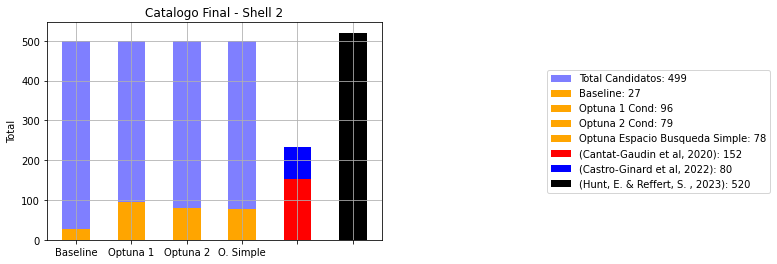

In [23]:
labels = ['Baseline',"Optuna 1", "Optuna 2", "O. Simple", '', ""]  # Each label gets its own stacked bar

# Values for each stacked segment
total=680
baseline=27
optuna_1=96
optuuna_2=79
optuna_simple=78


###Shell 2
#Modelo Optimizado (con shell1) Optuna 2 cond: (69,430)  [ESTRICTO V2]
#Modelo Laxo (27,472)
#Modelo Optimizado (con Shell2) 2 cond: (79,420)
#Modelo Optimizados 1 cond: (96,403)
#Modelo Simplificado: (78,421)


x = np.arange(len(labels))  # the label locations
width = 0.5                 # width of each bar

fig, ax = plt.subplots()

# Stacked bar for 'A'
bar_total= ax.bar(x[0], 499, width, alpha=0.5, label="Total Candidatos: 499",color="blue")
bar_baselien=ax.bar(x[0],baseline,width,label="Baseline: 27",color="orange")
bar_total= ax.bar(x[1], 499, width, alpha=0.5,color="blue")
bar_optuna1=ax.bar(x[1],optuna_1,width,label="Optuna 1 Cond: 96",color="orange")
bar_total= ax.bar(x[2], 499, width, alpha=0.5,color="blue")
bar_optuna2=ax.bar(x[2],optuuna_2,width,label="Optuna 2 Cond: 79",color="orange")
bar_total= ax.bar(x[3], 499, width, alpha=0.5,color="blue")
bar_optuna3=ax.bar(x[3],optuna_simple,width,label="Optuna Espacio Busqueda Simple: 78",color="orange")


bar_cantat= ax.bar(x[4], 152, width, label= "(Cantat-Gaudin et al, 2020): 152", color="red")
bar_castro= ax.bar(x[4], 80, width, bottom=152,label= "(Castro-Ginard et al, 2022): 80", color="blue")
bar_hunt=ax.bar(x[5], 520, width, label= "(Hunt, E. & Reffert, S. , 2023): 520", color="black")


# Add labels and legend
ax.set_ylabel('Total')
ax.set_title("Catalogo Final - Shell 2")
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend(loc='center left', bbox_to_anchor=(1.479, 0.5))
#ax.legend()
plt.grid(True)
#plt.yscale("log")
plt.tight_layout()
plt.show()



In [55]:
cuadrantes_shell2={}
for j in range(8):
    folder_path = r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\9 Semestre\TESIS\Datos Shell\shell2\clusters"+str(j+1)
    dataframes = {}
    for file_name in os.listdir(folder_path):
        if file_name.endswith('.csv'):
            file_path = os.path.join(folder_path, file_name)
            df = pd.read_csv(file_path)
            first_cols = ['phot_g_mean_mag','phot_bp_mean_mag', 'phot_rp_mean_mag',"parallax"]
            df = df[first_cols + [col for col in df.columns if col not in first_cols]]
            dataframes[file_name]=df
    cuadrantes_shell2["Q"+str(j+1)]=dataframes

In [57]:
#"candidatos_shell2_1cond.csv", "candidatos_shell2_2condINTENTO2.csv", "candidatos_shell2_simplificado.csv"]
shell2_baseline_candidatos = pd.read_csv("candidatos_shell2_Baseline.csv")  # Replace with your actual file name
shell2_baseline_candidatos = [s[:-4] for s in shell2_baseline_candidatos['Archivo'].astype(str)]

shell2_optuna1_candidatos = pd.read_csv("candidatos_shell2_1cond.csv")
shell2_optuna1_candidatos = [s[:-4] for s in shell2_optuna1_candidatos['Archivo'].astype(str)]

shell2_optuna2_candidatos = pd.read_csv("candidatos_shell2_2condINTENTO2.csv")
shell2_optuna2_candidatos = [s[:-4] for s in shell2_optuna2_candidatos['Archivo'].astype(str)]

shell2_optunaS_candidatos = pd.read_csv("candidatos_shell2_simplificado.csv")
shell2_optunaS_candidatos = [s[:-4] for s in shell2_optunaS_candidatos['Archivo'].astype(str)]


In [59]:
all_lists = {"Baseline": shell2_baseline_candidatos, "Optuna 1": shell2_optuna1_candidatos,
             "Optuna 2": shell2_optuna2_candidatos, "Optuna Simplificado":shell2_optunaS_candidatos}



# Step 1: Build the base data rows from cuadrantes_shell1
rows = []
for quadrant, clusters in cuadrantes_shell2.items():
    for cluster_filename in clusters:
        rows.append({
            "quadrant": quadrant,
            "cluster_id": cluster_filename
        })

# Step 2: Create the base DataFrame
df2 = pd.DataFrame(rows)

# Step 3: For each list, create a column with True/False indicating membership
for list_name, file_list in all_lists.items():
    # Convert file list to a set of tuples like ("Q1", "cluster_66.csv")
    file_set = set()
    for fname in file_list:
        quad, clus = fname.split("_", 1)
        file_set.add((quad, clus))
    
    # Create the boolean column
    df2[list_name] = df2.apply(
        lambda row: (row["quadrant"], row["cluster_id"]) in file_set,
        axis=1
    )

# Print or save the result
df2


,quadrant,cluster_id,Baseline,Optuna 1,Optuna 2,Optuna Simplificado
0,Q1,cluster_0.csv,False,False,False,False
1,Q1,cluster_1.csv,False,True,True,False
2,Q1,cluster_10.csv,False,True,True,True
3,Q1,cluster_100.csv,False,False,False,False
4,Q1,cluster_101.csv,False,False,False,False
...,...,...,...,...,...,...
494,Q8,cluster_72.csv,False,False,False,False
495,Q8,cluster_73.csv,False,False,False,False
496,Q8,cluster_74.csv,False,False,False,False
497,Q8,cluster_8.csv,False,False,False,False


In [60]:
df2.to_csv("CATALOGO FINALSHELL 2.csv")

In [63]:
sampled_df2 = (
    df2.groupby("quadrant", group_keys=False)
      .apply(lambda x: x.sample(n=4))  # set random_state for reproducibility
)

# Reset index if desired
sampled_df2 = sampled_df2.reset_index(drop=True)
sampled_df2

C:\Users\juang\AppData\Local\Temp/ipykernel_16640/3281929581.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df2.groupby("quadrant", group_keys=False)


,quadrant,cluster_id,Baseline,Optuna 1,Optuna 2,Optuna Simplificado
0,Q1,cluster_38.csv,False,False,True,False
1,Q1,cluster_156.csv,False,False,False,False
2,Q1,cluster_64.csv,False,False,False,False
3,Q1,cluster_128.csv,False,False,False,False
4,Q2,cluster_39.csv,False,False,False,False
5,Q2,cluster_12.csv,False,False,False,False
6,Q2,cluster_28.csv,False,False,False,False
7,Q2,cluster_22.csv,False,False,False,False
8,Q3,cluster_14.csv,False,True,False,False
9,Q3,cluster_20.csv,False,False,False,False


In [64]:
sampled_df2.to_csv("CATALOGO FINAL SHELL 2 EJEMPLO.csv")

In [35]:
solo_true= [s[:-4] for s in solo_true]
globulares=[s[:-4] for s in globulares]
dudosos=[s[:-4] for s in true_dudosos]
dudosos = [item for item in dudosos if item not in solo_true]

In [36]:
filtered_cuadrantes_shell2 = {}

# Process each item in the input list
for item in solo_true:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell2 and cluster in cuadrantes_shell2[quadrant]:
        if quadrant not in filtered_cuadrantes_shell2:
            filtered_cuadrantes_shell2[quadrant] = {}
        filtered_cuadrantes_shell2[quadrant][cluster] = cuadrantes_shell2[quadrant][cluster]

In [118]:
filtered_cuadrantes_shell2 = {}

# Process each item in the input list
for item in shell2_optuna1_candidatos:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell2 and cluster in cuadrantes_shell2[quadrant]:
        if quadrant not in filtered_cuadrantes_shell2:
            filtered_cuadrantes_shell2[quadrant] = {}
        filtered_cuadrantes_shell2[quadrant][cluster] = cuadrantes_shell2[quadrant][cluster]

In [119]:
catalogo_final_galan_shell2=[]
for quadrant, clusters in filtered_cuadrantes_shell2.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_shell2.append(cluster_summary)
        
catalogo_final_galan_shell2 = pd.concat(catalogo_final_galan_shell2, ignore_index=True)



Centroid RA: 229.9256 deg
Centroid Dec: 0.7037 deg
Centroid Distance: 4397.22 pc
Radius: 328.7313854012069

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: 3.993 ± 0.007 mas/yr
Mean Proper Motion Dec: -9.684 ± 0.007 mas/yr
Mean Radial Velocity: 34.83 ± 2.61 km/s
Centroid RA: 251.8020 deg
Centroid Dec: -1.9278 deg
Centroid Distance: 4791.52 pc
Radius: 121.84826184410312

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.231 ± 0.004 mas/yr
Mean Proper Motion Dec: -6.766 ± 0.003 mas/yr
Mean Radial Velocity: -40.42 ± 0.22 km/s
Centroid RA: 271.8657 deg
Centroid Dec: -27.5306 deg
Centroid Distance: 4880.02 pc
Radius: 173.04207897126392

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -2.364 ± 0.004 mas/yr
Mean Proper Motion Dec: -5.280 ± 0.003 mas/yr
Mean Radial Velocity: -3.57 ± 0.27 km/s
Centroid RA: 270.2217 deg
Centroid Dec: -27.9786 deg
Centroid Distance: 4324.69 pc
Radius: 201.83549783477727

----- Cluster Kinematic Properties -----
Mea

In [120]:
catalogo_final_galan_shell2

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q1,cluster_1.csv,112,229.925642,0.703659,4397.218318,2.581915,45.700876,328.731385,3.992700,0.006629,-9.684417,0.006664,34.830663,2.608614
1,Q1,cluster_10.csv,117,251.802020,-1.927841,4791.520842,15.730694,26.330157,121.848262,-0.231171,0.003570,-6.766428,0.002837,-40.423776,0.220219
2,Q1,cluster_105.csv,238,271.865742,-27.530567,4880.018618,3.632645,-3.454853,173.042079,-2.364445,0.003826,-5.279602,0.002868,-3.567586,0.267488
3,Q1,cluster_113.csv,225,270.221704,-27.978646,4324.689755,2.528853,-2.404951,201.835498,-2.429168,0.004324,-4.782033,0.003139,60.629905,0.849355
4,Q1,cluster_12.csv,173,261.931665,-5.021229,4237.987432,18.459942,16.067298,234.218755,-0.339769,0.002419,-5.142615,0.001788,-116.587181,0.119591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,Q8,cluster_31.csv,116,269.781951,-35.159187,4414.999244,356.081040,-5.620647,121.377337,-3.316324,0.006507,-5.541698,0.004327,-66.770920,2.940693
92,Q8,cluster_32.csv,359,269.773468,-35.183861,4602.279838,356.056020,-5.626725,137.446668,-2.566263,0.003578,-5.346703,0.002393,-77.302912,0.613081
93,Q8,cluster_33.csv,329,269.653002,-35.295150,4811.683077,355.910040,-5.595750,138.391253,-2.943364,0.003632,-5.519245,0.002426,-114.583269,0.591912
94,Q8,cluster_6.csv,140,257.725349,-31.139243,4266.726360,353.998096,5.034040,146.730933,-3.754172,0.006587,-5.293484,0.004448,-70.355559,1.045937


In [121]:
# Load the external CSV file
info_df = pd.read_csv("candidatos_shell2_1Cond.csv")

# Step 1: Strip ".png" from 'Archivo' to match 'quadrant' + '_' + 'cluster_id'
info_df["Archivo_clean"] = info_df["Archivo"].str.replace(".png", "", regex=False)

# Step 2: Create a join key in the main df to match against 'Archivo_clean'
catalogo_final_galan_shell2["Archivo_clean"] = catalogo_final_galan_shell2["quadrant"] + "_" + catalogo_final_galan_shell2["cluster_name"]

# Step 3: Merge on the cleaned 'Archivo' identifier
merged_df2 = catalogo_final_galan_shell2.merge(info_df[["Archivo_clean", "Clasificacion", "Valor"]],
                     on="Archivo_clean", how="left")

# Optional: drop the helper column if not needed
merged_df2.drop(columns="Archivo_clean", inplace=True)

# Print or save result
merged_df2


,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err,Clasificacion,Valor
0,Q1,cluster_1.csv,112,229.925642,0.703659,4397.218318,2.581915,45.700876,328.731385,3.992700,0.006629,-9.684417,0.006664,34.830663,2.608614,Globular,0.971599
1,Q1,cluster_10.csv,117,251.802020,-1.927841,4791.520842,15.730694,26.330157,121.848262,-0.231171,0.003570,-6.766428,0.002837,-40.423776,0.220219,Globular,0.889297
2,Q1,cluster_105.csv,238,271.865742,-27.530567,4880.018618,3.632645,-3.454853,173.042079,-2.364445,0.003826,-5.279602,0.002868,-3.567586,0.267488,False,0.847979
3,Q1,cluster_113.csv,225,270.221704,-27.978646,4324.689755,2.528853,-2.404951,201.835498,-2.429168,0.004324,-4.782033,0.003139,60.629905,0.849355,False,0.884213
4,Q1,cluster_12.csv,173,261.931665,-5.021229,4237.987432,18.459942,16.067298,234.218755,-0.339769,0.002419,-5.142615,0.001788,-116.587181,0.119591,Globular,0.972431
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,Q8,cluster_31.csv,116,269.781951,-35.159187,4414.999244,356.081040,-5.620647,121.377337,-3.316324,0.006507,-5.541698,0.004327,-66.770920,2.940693,False,0.936022
92,Q8,cluster_32.csv,359,269.773468,-35.183861,4602.279838,356.056020,-5.626725,137.446668,-2.566263,0.003578,-5.346703,0.002393,-77.302912,0.613081,False,0.785895
93,Q8,cluster_33.csv,329,269.653002,-35.295150,4811.683077,355.910040,-5.595750,138.391253,-2.943364,0.003632,-5.519245,0.002426,-114.583269,0.591912,False,0.928812
94,Q8,cluster_6.csv,140,257.725349,-31.139243,4266.726360,353.998096,5.034040,146.730933,-3.754172,0.006587,-5.293484,0.004448,-70.355559,1.045937,False,0.927840


In [122]:
merged_df2.to_csv("CATALOGO FINAL MEJOR MODELO SHELL 2.csv")

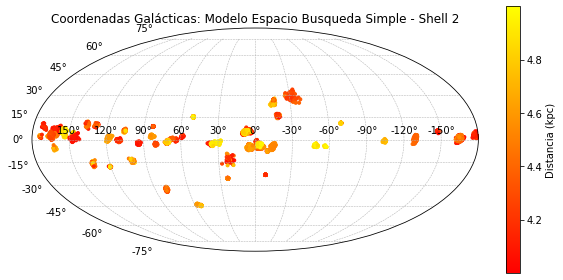

In [93]:
# Accumulate parallaxes
paralajes2 = []
for cua in filtered_cuadrantes_shell2.values():
    for clu in cua.values():
        paralajes2.append(list(clu["parallax"]))
paralajes2 = [item for sublist in paralajes2 for item in sublist]

# Convert parallax (mas) to distance (kpc)
distancias2 = [1 / p for p in paralajes2]  # Assumes parallax in mas → distance in kpc

# Accumulate RA
ra_2 = []
for cua in filtered_cuadrantes_shell2.values():
    for clu in cua.values():
        ra_2.append(list(clu["ra"]))
ra_2 = [item for sublist in ra_2 for item in sublist]

# Accumulate Dec
dec_2 = []
for cua in filtered_cuadrantes_shell2.values():
    for clu in cua.values():
        dec_2.append(list(clu["dec"]))
dec_2 = [item for sublist in dec_2 for item in sublist]

# Convert to numpy arrays
ra = np.array(ra_2)
dec = np.array(dec_2)
dis = distancias2

# Convert to Galactic Coordinates
coords = SkyCoord(ra=ra * u.degree, dec=dec * u.degree, frame='icrs', equinox='J2016.0')
galactic = coords.galactic

# Convert to radians for plotting
l_rad = np.deg2rad(galactic.l.wrap_at(180 * u.degree).value)
b_rad = np.deg2rad(galactic.b.value)

# Plot in Mollweide Projection
plt.figure(figsize=(10, 7))
ax = plt.subplot(111, projection="mollweide")
scatter = ax.scatter(l_rad, b_rad, c=dis, cmap="autumn", marker='.')
ax.grid(True, linestyle='--', linewidth=0.5)
ax.set_xticklabels(['150°', '120°', '90°', '60°', '30°', '0°', '-30°', '-60°', '-90°', '-120°', '-150°'])
cbar = plt.colorbar(scatter, shrink=0.7)
cbar.set_label('Distancia (kpc)')
plt.title("Coordenadas Galácticas: Modelo Espacio Busqueda Simple - Shell 2")
plt.show()


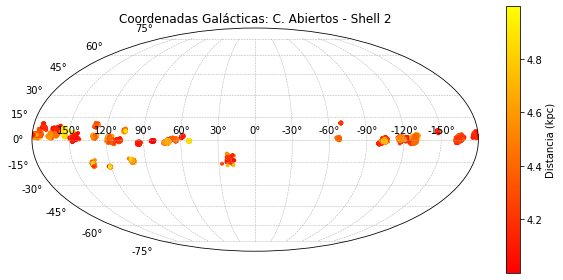

In [37]:
# Accumulate parallaxes
paralajes2 = []
for cua in filtered_cuadrantes_shell2.values():
    for clu in cua.values():
        paralajes2.append(list(clu["parallax"]))
paralajes2 = [item for sublist in paralajes2 for item in sublist]

# Convert parallax (mas) to distance (kpc)
distancias2 = [1 / p for p in paralajes2]  # Assumes parallax in mas → distance in kpc

# Accumulate RA
ra_2 = []
for cua in filtered_cuadrantes_shell2.values():
    for clu in cua.values():
        ra_2.append(list(clu["ra"]))
ra_2 = [item for sublist in ra_2 for item in sublist]

# Accumulate Dec
dec_2 = []
for cua in filtered_cuadrantes_shell2.values():
    for clu in cua.values():
        dec_2.append(list(clu["dec"]))
dec_2 = [item for sublist in dec_2 for item in sublist]

# Convert to numpy arrays
ra = np.array(ra_2)
dec = np.array(dec_2)
dis = distancias2

# Convert to Galactic Coordinates
coords = SkyCoord(ra=ra * u.degree, dec=dec * u.degree, frame='icrs', equinox='J2016.0')
galactic = coords.galactic

# Convert to radians for plotting
l_rad = np.deg2rad(galactic.l.wrap_at(180 * u.degree).value)
b_rad = np.deg2rad(galactic.b.value)

# Plot in Mollweide Projection
plt.figure(figsize=(10, 7))
ax = plt.subplot(111, projection="mollweide")
scatter = ax.scatter(l_rad, b_rad, c=dis, cmap="autumn", marker='.')
ax.grid(True, linestyle='--', linewidth=0.5)
ax.set_xticklabels(['150°', '120°', '90°', '60°', '30°', '0°', '-30°', '-60°', '-90°', '-120°', '-150°'])
cbar = plt.colorbar(scatter, shrink=0.7)
cbar.set_label('Distancia (kpc)')
plt.title("Coordenadas Galácticas: C. Abiertos - Shell 2")
plt.show()


In [38]:
filtered_cuadrantes_shell2_globulares = {}

# Process each item in the input list
for item in globulares:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell2 and cluster in cuadrantes_shell2[quadrant]:
        #print(quadrant)
        #print(cluster)
        if quadrant not in filtered_cuadrantes_shell2_globulares:
            filtered_cuadrantes_shell2_globulares[quadrant] = {}
        filtered_cuadrantes_shell2_globulares[quadrant][cluster] = cuadrantes_shell2[quadrant][cluster]

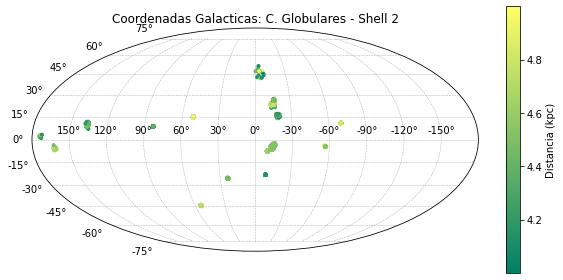

In [39]:
# Accumulate parallaxes
paralajes2 = []
for cua in filtered_cuadrantes_shell2_globulares.values():
    for clu in cua.values():
        paralajes2.append(list(clu["parallax"]))
paralajes2 = [item for sublist in paralajes2 for item in sublist]

# Convert parallax (mas) to distance (kpc)
distancias2 = [1 / p for p in paralajes2]  # Assumes parallax in mas → distance in kpc

# Accumulate RA
ra_2 = []
for cua in filtered_cuadrantes_shell2_globulares.values():
    for clu in cua.values():
        ra_2.append(list(clu["ra"]))
ra_2 = [item for sublist in ra_2 for item in sublist]

# Accumulate Dec
dec_2 = []
for cua in filtered_cuadrantes_shell2_globulares.values():
    for clu in cua.values():
        dec_2.append(list(clu["dec"]))
dec_2 = [item for sublist in dec_2 for item in sublist]

# Convert to numpy arrays
ra = np.array(ra_2)
dec = np.array(dec_2)
dis = distancias2

# Convert to Galactic Coordinates
coords = SkyCoord(ra=ra * u.degree, dec=dec * u.degree, frame='icrs', equinox='J2016.0')
galactic = coords.galactic

# Convert to radians for plotting
l_rad = np.deg2rad(galactic.l.wrap_at(180 * u.degree).value)
b_rad = np.deg2rad(galactic.b.value)

# Plot in Mollweide Projection
plt.figure(figsize=(10, 7))
ax = plt.subplot(111, projection="mollweide")
scatter = ax.scatter(l_rad, b_rad, c=dis, cmap="summer", marker='.')
ax.grid(True, linestyle='--', linewidth=0.5)
ax.set_xticklabels(['150°', '120°', '90°', '60°', '30°', '0°', '-30°', '-60°', '-90°', '-120°', '-150°'])
cbar = plt.colorbar(scatter, shrink=0.7)
cbar.set_label('Distancia (kpc)')
plt.title("Coordenadas Galacticas: C. Globulares - Shell 2")
plt.show()


In [40]:
filtered_cuadrantes_shell2_dudosos = {}

# Process each item in the input list
for item in dudosos:
    quadrant, cluster = item.split("_", 1)  # Split into "Q1" and "cluster_66.csv"
    if quadrant in cuadrantes_shell2 and cluster in cuadrantes_shell2[quadrant]:
        #print(quadrant)
        #print(cluster)
        if quadrant not in filtered_cuadrantes_shell2_dudosos:
            filtered_cuadrantes_shell2_dudosos[quadrant] = {}
        filtered_cuadrantes_shell2_dudosos[quadrant][cluster] = cuadrantes_shell2[quadrant][cluster]

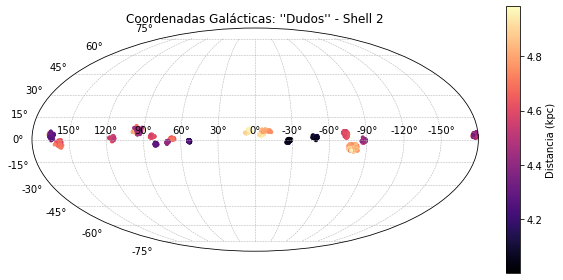

In [41]:
# Accumulate parallaxes
paralajes2 = []
for cua in filtered_cuadrantes_shell2_dudosos.values():
    for clu in cua.values():
        paralajes2.append(list(clu["parallax"]))
paralajes2 = [item for sublist in paralajes2 for item in sublist]

# Convert parallax (mas) to distance (kpc)
distancias2 = [1 / p for p in paralajes2]  # Assumes parallax in mas → distance in kpc

# Accumulate RA
ra_2 = []
for cua in filtered_cuadrantes_shell2_dudosos.values():
    for clu in cua.values():
        ra_2.append(list(clu["ra"]))
ra_2 = [item for sublist in ra_2 for item in sublist]

# Accumulate Dec
dec_2 = []
for cua in filtered_cuadrantes_shell2_dudosos.values():
    for clu in cua.values():
        dec_2.append(list(clu["dec"]))
dec_2 = [item for sublist in dec_2 for item in sublist]

# Convert to numpy arrays
ra = np.array(ra_2)
dec = np.array(dec_2)
dis = distancias2

# Convert to Galactic Coordinates
coords = SkyCoord(ra=ra * u.degree, dec=dec * u.degree, frame='icrs', equinox='J2016.0')
galactic = coords.galactic

# Convert to radians for plotting
l_rad = np.deg2rad(galactic.l.wrap_at(180 * u.degree).value)
b_rad = np.deg2rad(galactic.b.value)

# Plot in Mollweide Projection
plt.figure(figsize=(10, 7))
ax = plt.subplot(111, projection="mollweide")
scatter = ax.scatter(l_rad, b_rad, c=dis, cmap="magma", marker='.')
ax.grid(True, linestyle='--', linewidth=0.5)
ax.set_xticklabels(['150°', '120°', '90°', '60°', '30°', '0°', '-30°', '-60°', '-90°', '-120°', '-150°'])
cbar = plt.colorbar(scatter, shrink=0.7)
cbar.set_label('Distancia (kpc)')
plt.title("Coordenadas Galácticas: ''Dudos'' - Shell 2")
plt.show()


In [42]:
catalogo_final_galan_abiertos_shell2=[]
for quadrant, clusters in filtered_cuadrantes_shell2.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_abiertos_shell2.append(cluster_summary)
        
catalogo_final_galan_abiertos_shell2 = pd.concat(catalogo_final_galan_abiertos_shell2, ignore_index=True)



Centroid RA: 290.1858 deg
Centroid Dec: 37.7657 deg
Centroid Distance: 4182.31 pc
Radius: 52.727554277712066

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.414 ± 0.005 mas/yr
Mean Proper Motion Dec: -2.288 ± 0.005 mas/yr
Mean Radial Velocity: -46.28 ± 0.36 km/s
Centroid RA: 299.8382 deg
Centroid Dec: 30.3778 deg
Centroid Distance: 4921.99 pc
Radius: 63.95067244785319

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -2.988 ± 0.002 mas/yr
Mean Proper Motion Dec: -5.418 ± 0.003 mas/yr
Mean Radial Velocity: -11.04 ± 0.17 km/s
Centroid RA: 299.6330 deg
Centroid Dec: 30.3727 deg
Centroid Distance: 4360.98 pc
Radius: 71.79421735724301

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -2.848 ± 0.003 mas/yr
Mean Proper Motion Dec: -5.388 ± 0.003 mas/yr
Mean Radial Velocity: 14.32 ± 3.79 km/s
Centroid RA: 25.8039 deg
Centroid Dec: 61.4322 deg
Centroid Distance: 4514.61 pc
Radius: 119.64327091567691

----- Cluster Kinematic Properties -----
Mean

In [43]:
catalogo_final_galan_dudosos_shell2=[]
for quadrant, clusters in filtered_cuadrantes_shell2_dudosos.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_dudosos_shell2.append(cluster_summary)
        
catalogo_final_galan_dudosos_shell2 = pd.concat(catalogo_final_galan_dudosos_shell2, ignore_index=True)



Centroid RA: 280.7878 deg
Centroid Dec: -5.8738 deg
Centroid Distance: 4061.15 pc
Radius: 67.6908558851965

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -1.120 ± 0.003 mas/yr
Mean Proper Motion Dec: -3.409 ± 0.003 mas/yr
Mean Radial Velocity: 51.17 ± 0.48 km/s
Centroid RA: 266.9974 deg
Centroid Dec: -19.7048 deg
Centroid Distance: 4836.91 pc
Radius: 243.21096624156732

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.100 ± 0.008 mas/yr
Mean Proper Motion Dec: -4.687 ± 0.005 mas/yr
Mean Radial Velocity: -28.03 ± 1.09 km/s
Centroid RA: 313.6022 deg
Centroid Dec: 36.2527 deg
Centroid Distance: 4813.93 pc
Radius: 193.37625403283477

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -3.230 ± 0.002 mas/yr
Mean Proper Motion Dec: -4.430 ± 0.003 mas/yr
Mean Radial Velocity: -18.27 ± 0.18 km/s
Centroid RA: 316.9049 deg
Centroid Dec: 46.3436 deg
Centroid Distance: 4430.48 pc
Radius: 102.07193232175058

----- Cluster Kinematic Properties -----
Me

In [44]:
catalogo_final_galan_globulares_shell2=[]
for quadrant, clusters in filtered_cuadrantes_shell2_globulares.items():
    for cluster_name, df in clusters.items():
# Convert parallax to distance
        df['distance_pc'] = 1000.0 / df['parallax']
        df['distance_error_pc'] = (1000.0 / df['parallax']**2) * df['parallax_error']

        # Create SkyCoord with full velocity info
        coords = SkyCoord(
            ra=df['ra'].values * u.deg,
            dec=df['dec'].values * u.deg,
            distance=df['distance_pc'].values * u.pc,
            pm_ra_cosdec=df['pmra'].values * u.mas/u.yr,
            pm_dec=df['pmdec'].values * u.mas/u.yr,
            radial_velocity=df['radial_velocity'].values * u.km/u.s,
            frame='icrs'
            
        )

        # Step 1: Cartesian coordinates and errors
        cart = coords.cartesian
        x, y, z = cart.x.value, cart.y.value, cart.z.value

        # Estimate Cartesian coordinate errors
        ra_rad = np.deg2rad(df['ra'])
        dec_rad = np.deg2rad(df['dec'])
        ra_error_rad = np.deg2rad(df['ra_error'])
        dec_error_rad = np.deg2rad(df['dec_error'])
        d = df['distance_pc'].values
        dd = df['distance_error_pc'].values

        x_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.cos(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.cos(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.sin(ra_rad) * ra_error_rad)**2
        )
        y_error = np.sqrt(
            (dd * np.cos(dec_rad) * np.sin(ra_rad))**2 +
            (d * np.sin(dec_rad) * np.sin(ra_rad) * dec_error_rad)**2 +
            (d * np.cos(dec_rad) * np.cos(ra_rad) * ra_error_rad)**2
        )
        z_error = np.sqrt(
            (dd * np.sin(dec_rad))**2 +
            (d * np.cos(dec_rad) * dec_error_rad)**2
        )

        # Inverse variance weights
        wx, wy, wz = 1 / x_error**2, 1 / y_error**2, 1 / z_error**2

        # Weighted centroid
        x_cent = np.average(x, weights=wx)
        y_cent = np.average(y, weights=wy)
        z_cent = np.average(z, weights=wz)

        centroid = SkyCoord(x=x_cent, y=y_cent, z=z_cent, unit='pc',
                            representation_type='cartesian', frame='icrs')

        # Step 2: Radius of the cluster (RMS 3D distance from centroid)
        deltas = np.sqrt((x - x_cent)**2 + (y - y_cent)**2 + (z - z_cent)**2)
        radius_pc = np.sqrt(np.mean(deltas**2))

        # Step 3: Proper motion and radial velocity centroid

        # Proper motion in RA
        if 'pmra_error' in df.columns:
            pmra_valid = df[['pmra', 'pmra_error']].dropna()
            if not pmra_valid.empty and (pmra_valid['pmra_error'] > 0).any():
                w_pm_ra = 1 / pmra_valid['pmra_error']**2
                pm_ra_cent = np.average(pmra_valid['pmra'], weights=w_pm_ra)
                pm_ra_cent_err = np.sqrt(1 / np.sum(w_pm_ra))
            else:
                pm_ra_cent = np.nan
                pm_ra_cent_err = np.nan
        else:
            pm_ra_cent = np.nan
            pm_ra_cent_err = np.nan

        # Proper motion in Dec
        if 'pmdec_error' in df.columns:
            pmdec_valid = df[['pmdec', 'pmdec_error']].dropna()
            if not pmdec_valid.empty and (pmdec_valid['pmdec_error'] > 0).any():
                w_pm_dec = 1 / pmdec_valid['pmdec_error']**2
                pm_dec_cent = np.average(pmdec_valid['pmdec'], weights=w_pm_dec)
                pm_dec_cent_err = np.sqrt(1 / np.sum(w_pm_dec))
            else:
                pm_dec_cent = np.nan
                pm_dec_cent_err = np.nan
        else:
            pm_dec_cent = np.nan
            pm_dec_cent_err = np.nan

        # Radial velocity
        if 'radial_velocity_error' in df.columns:
            rv_valid = df[['radial_velocity', 'radial_velocity_error']].dropna()
            if not rv_valid.empty and (rv_valid['radial_velocity_error'] > 0).any():
                w_rv = 1 / rv_valid['radial_velocity_error']**2
                rv_cent = np.average(rv_valid['radial_velocity'], weights=w_rv)
                rv_cent_err = np.sqrt(1 / np.sum(w_rv))
            else:
                rv_cent = np.nan
                rv_cent_err = np.nan
        else:
            rv_cent = np.nan
            rv_cent_err = np.nan


        # Convert centroid to ICRS (spherical) to access RA, Dec, Distance
        centroid_icrs = centroid.transform_to('icrs')

        centroid_icrs = SkyCoord(centroid_icrs.represent_as('spherical'))


        # Final Output
        print(f"Centroid RA: {centroid_icrs.ra.deg:.4f} deg")
        print(f"Centroid Dec: {centroid_icrs.dec.deg:.4f} deg")
        print(f"Centroid Distance: {centroid_icrs.distance.pc:.2f} pc")
        print("Radius: "+str(radius_pc))



        print("\n----- Cluster Kinematic Properties -----")
        print(f"Mean Proper Motion RA: {pm_ra_cent:.3f} ± {pm_ra_cent_err:.3f} mas/yr")
        print(f"Mean Proper Motion Dec: {pm_dec_cent:.3f} ± {pm_dec_cent_err:.3f} mas/yr")
        print(f"Mean Radial Velocity: {rv_cent:.2f} ± {rv_cent_err:.2f} km/s")

        # Convert to Galactic for (l, b)
        centroid_gal = centroid_icrs.galactic

        # Prepare output DataFrame
        cluster_summary = pd.DataFrame([{
            "quadrant": quadrant,
            "cluster_name": cluster_name,
            "n_stars": len(df),
            
            # Centroid coordinates (ICRS)
            "ra_deg": centroid_icrs.ra.deg,
            "dec_deg": centroid_icrs.dec.deg,
            "distance_pc": centroid_icrs.distance.pc,
            
            # Centroid coordinates (Galactic)
            "l_deg": centroid_gal.l.deg,
            "b_deg": centroid_gal.b.deg,
            
            # Cluster radius
            "radius_pc": radius_pc,
            
            # Proper motion and RV
            "pmra": pm_ra_cent,
            "pmra_err": pm_ra_cent_err,
            "pmdec": pm_dec_cent,
            "pmdec_err": pm_dec_cent_err,
            "rv": rv_cent,
            "rv_err": rv_cent_err
        }])

        # Show result
        catalogo_final_galan_globulares_shell2.append(cluster_summary)
        
catalogo_final_galan_globulares_shell2 = pd.concat(catalogo_final_galan_globulares_shell2, ignore_index=True)



Centroid RA: 229.9256 deg
Centroid Dec: 0.7037 deg
Centroid Distance: 4397.22 pc
Radius: 328.7313854012069

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: 3.993 ± 0.007 mas/yr
Mean Proper Motion Dec: -9.684 ± 0.007 mas/yr
Mean Radial Velocity: 34.83 ± 2.61 km/s
Centroid RA: 251.8020 deg
Centroid Dec: -1.9278 deg
Centroid Distance: 4791.52 pc
Radius: 121.84826184410312

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.231 ± 0.004 mas/yr
Mean Proper Motion Dec: -6.766 ± 0.003 mas/yr
Mean Radial Velocity: -40.42 ± 0.22 km/s
Centroid RA: 261.9317 deg
Centroid Dec: -5.0212 deg
Centroid Distance: 4237.99 pc
Radius: 234.21875520823983

----- Cluster Kinematic Properties -----
Mean Proper Motion RA: -0.340 ± 0.002 mas/yr
Mean Proper Motion Dec: -5.143 ± 0.002 mas/yr
Mean Radial Velocity: -116.59 ± 0.12 km/s
Centroid RA: 279.0847 deg
Centroid Dec: -23.9046 deg
Centroid Distance: 4182.15 pc
Radius: 134.74668236853657

----- Cluster Kinematic Properties -----
Me

In [45]:
catalogo_final_galan_abiertos_shell2

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q2,cluster_1.csv,81,290.185765,37.765652,4182.313711,69.940627,10.926086,52.727554,-0.414026,0.004717,-2.287719,0.005465,-46.275657,0.363704
1,Q2,cluster_47.csv,112,299.838244,30.377800,4921.994791,67.330903,0.365524,63.950672,-2.988061,0.002431,-5.417681,0.002791,-11.038218,0.166381
2,Q2,cluster_50.csv,128,299.633011,30.372735,4360.978203,67.233797,0.513670,71.794217,-2.848134,0.002753,-5.387929,0.003149,14.319852,3.793350
3,Q3,cluster_10.csv,79,25.803881,61.432194,4514.614419,129.081826,-0.819767,119.643271,-1.154831,0.003151,-0.309853,0.003548,-84.625763,0.685414
4,Q3,cluster_12.csv,759,0.049313,63.100429,4137.161630,117.174162,0.802930,220.256426,-2.257135,0.001138,-0.683043,0.001246,-78.641617,0.129313
5,Q3,cluster_14.csv,253,0.174833,63.162127,4532.664650,117.241910,0.852285,96.477720,-2.250648,0.002026,-0.671700,0.002178,-75.734585,0.136071
6,Q3,cluster_22.csv,215,335.501923,56.209067,4024.443527,103.206765,-0.830010,149.002341,-3.573850,0.001997,-2.872623,0.001840,-68.145162,0.513140
7,Q3,cluster_23.csv,603,337.063094,56.560734,4295.470976,104.126068,-0.990317,190.386660,-3.461649,0.001237,-2.704060,0.001121,-63.655070,0.213273
8,Q3,cluster_24.csv,59,337.598646,56.638409,4722.708407,104.418602,-1.076338,68.451477,-3.464796,0.004175,-2.694930,0.003697,-55.647948,1.109902
9,Q3,cluster_7.csv,136,27.986676,64.065409,4715.355859,129.489294,1.966727,164.105517,-1.118363,0.002526,-0.020558,0.002945,-48.756013,0.246516


In [64]:
catalogo_final_galan_abiertos_shell2.to_csv("catalogo_final_cabierto_shell2.csv")

In [46]:
catalogo_final_galan_dudosos_shell2

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q1,cluster_154.csv,257,280.787765,-5.873835,4061.153797,26.761347,-0.839995,67.690856,-1.120408,0.002948,-3.409426,0.002565,51.174468,0.479986
1,Q1,cluster_20.csv,59,266.997420,-19.704844,4836.913773,8.185613,4.316326,243.210966,-0.100346,0.008294,-4.687210,0.005136,-28.033445,1.093157
2,Q2,cluster_10.csv,306,313.602198,36.252723,4813.927712,78.793713,-5.579805,193.376254,-3.230439,0.002216,-4.430386,0.002544,-18.269992,0.183897
3,Q2,cluster_16.csv,215,316.904914,46.343591,4430.482432,88.037814,-0.805833,102.071932,-3.116257,0.002759,-3.848303,0.002828,-50.200722,0.121969
4,Q2,cluster_21.csv,350,289.253187,14.867631,4094.299135,49.042972,1.215252,83.551947,-2.003219,0.002203,-4.932011,0.002004,39.199239,0.161707
5,Q2,cluster_40.csv,115,299.715816,36.886968,4600.704422,72.829216,3.858183,126.084208,-2.573952,0.003946,-4.679761,0.004378,-24.659542,0.465701
6,Q4,cluster_11.csv,82,88.622325,32.302010,4831.079617,178.086423,3.363054,157.967295,0.182295,0.005010,-1.462274,0.003222,-2.853437,0.720558
7,Q4,cluster_14.csv,151,89.363948,32.256300,4414.974399,178.440476,3.883032,170.182725,0.272861,0.003622,-1.669031,0.002362,26.774500,0.322401
8,Q5,cluster_14.csv,127,95.040884,8.216690,4645.975600,202.045024,-3.133383,142.489298,0.175866,0.004311,-0.011676,0.003584,63.896919,0.383515
9,Q5,cluster_20.csv,139,96.545588,16.898934,4772.382879,195.058245,2.229203,123.769479,-0.003951,0.002908,-0.335074,0.002329,71.068503,0.599208


In [65]:
catalogo_final_galan_dudosos_shell2.to_csv("catalogo_final_dudosos_shell2.csv")

In [47]:
catalogo_final_galan_globulares_shell2

,quadrant,cluster_name,n_stars,ra_deg,dec_deg,distance_pc,l_deg,b_deg,radius_pc,pmra,pmra_err,pmdec,pmdec_err,rv,rv_err
0,Q1,cluster_1.csv,112,229.925642,0.703659,4397.218318,2.581915,45.700876,328.731385,3.992700,0.006629,-9.684417,0.006664,34.830663,2.608614
1,Q1,cluster_10.csv,117,251.802020,-1.927841,4791.520842,15.730694,26.330157,121.848262,-0.231171,0.003570,-6.766428,0.002837,-40.423776,0.220219
2,Q1,cluster_12.csv,173,261.931665,-5.021229,4237.987432,18.459942,16.067298,234.218755,-0.339769,0.002419,-5.142615,0.001788,-116.587181,0.119591
3,Q1,cluster_2.csv,380,279.084727,-23.904567,4182.153874,9.886270,-7.539259,134.746682,9.889717,0.002362,-5.602074,0.001845,-152.930311,0.227467
4,Q1,cluster_3.csv,75,279.118742,-23.896159,4625.357535,9.907809,-7.563382,63.096131,9.688418,0.006212,-5.735993,0.004854,-140.630815,7.219116
5,Q1,cluster_5.csv,188,294.983776,-30.968157,4762.607539,8.784561,-23.260548,165.461127,-3.445939,0.002538,-9.314062,0.002044,174.008236,0.274513
6,Q1,cluster_6.csv,71,294.998271,-30.957427,4240.779361,8.799965,-23.268878,67.779811,-3.425284,0.007231,-9.314631,0.005925,NaN,NaN
7,Q1,cluster_7.csv,54,254.266125,-4.172332,4254.273410,15.058216,23.056254,101.787286,-4.687267,0.006963,-6.616211,0.005296,73.644925,0.867649
8,Q1,cluster_8.csv,117,254.331003,-3.916833,4704.418406,15.331342,23.135934,165.764082,-4.812203,0.003324,-6.602367,0.002542,70.678329,0.165286
9,Q1,cluster_80.csv,102,278.349941,-18.365694,4521.580239,14.547775,-4.431124,137.391430,-1.746948,0.005148,-4.652390,0.004078,24.994149,0.352923


In [66]:
catalogo_final_galan_globulares_shell2.to_csv("catalogo_final_cglobulares_shell2.csv")

# Comparación 1a1 Catalogos

In [106]:
catalogo_final_galan_abiertos_shell1.keys()

Index(['quadrant', 'cluster_name', 'n_stars', 'ra_deg', 'dec_deg',
       'distance_pc', 'l_deg', 'b_deg', 'radius_pc', 'pmra', 'pmra_err',
       'pmdec', 'pmdec_err', 'rv', 'rv_err'],
      dtype='object')

In [126]:
merged_df.keys()

Index(['quadrant', 'cluster_name', 'n_stars', 'ra_deg', 'dec_deg',
       'distance_pc', 'l_deg', 'b_deg', 'radius_pc', 'pmra', 'pmra_err',
       'pmdec', 'pmdec_err', 'rv', 'rv_err', 'Clasificacion', 'Valor'],
      dtype='object')

In [ ]:
df.keys() #Cantat Gaudin

Index(['Cluster', 'RA_ICRS', 'DE_ICRS', 'r50', 'nbstars07', 'pmRA*', 'pmDE',
       'plx', 'Flag', 'AgeNN', 'AVNN', 'DMNN', 'DistPc', 'X', 'Y', 'Z', 'Rgc',
       'SimbadName', '_RA_icrs', '_DE_icrs', 'GLAT', 'GLON'],
      dtype='object')

In [150]:
df2.keys() #Castro Ginard

Index(['Seq', 'Cluster', 'RA_ICRS', 's_RA_ICRS', 'DE_ICRS', 's_DE_ICRS',
       'GLON', 's_GLON', 'GLAT', 's_GLAT', 'plx', 's_plx', 'pmRA', 's_pmRA',
       'pmDE', 's_pmDE', 'RV', 's_RV', 'Nmemb', 'NmembRV', 'Flag', 'logAge',
       'Dist', 'AV', '_RA_icrs', '_DE_icrs'],
      dtype='object')

In [127]:
df3.keys() #Hunt

Index(['Name', 'ID', 'Type', 'N', 'RA_ICRS', 'DE_ICRS', 'r50', 'pmRA', 'pmDE',
       'Kpc', 'dist50', 'X', 'Y', 'Z', 'RV', 'isMerged', 'isGMMMemb',
       '_RA_icrs', '_DE_icrs', 'GLON', 'GLAT'],
      dtype='object')

In [128]:
shell1_hunt.head()

,Name,ID,Type,N,RA_ICRS,DE_ICRS,r50,pmRA,pmDE,Kpc,...,X,Y,Z,RV,isMerged,isGMMMemb,_RA_icrs,_DE_icrs,GLON,GLAT
44,Berkeley_69,242,o,216,81.090886,32.608154,0.065701,0.738993,-1.953736,3.659361,...,-11285.130269,307.806911,-73.830476,31.678628,0,0,81.090882,32.608163,174.441660,-1.8510
47,NGC_1893,4495,o,207,80.701845,33.426279,0.071378,-0.289832,-1.397974,3.390566,...,-10957.506074,318.953878,-54.603185,21.590430,0,0,80.701847,33.426285,173.581684,-1.6590
53,CWNU_1421,708,o,26,77.818586,34.190715,0.055291,-0.867599,-1.097827,3.053174,...,-10831.800082,401.452669,-124.119582,-7.690233,0,0,77.818590,34.190720,171.571990,-3.1730
71,UBC_1281,6683,o,62,80.480925,34.755082,0.235976,-0.271722,-1.679192,3.249373,...,-10994.048733,384.074311,-25.308730,NaN,0,0,80.480927,34.755089,172.382912,-1.0570
75,Czernik_21,1372,o,319,81.675587,36.018333,0.061113,2.184408,-0.891216,3.672127,...,-11390.080676,465.881730,55.617613,41.627529,0,0,81.675575,36.018337,171.887165,0.4591


In [129]:
# --- Load your dataframes ---
df1 = merged_df
df2 = shell1_hunt

df1 = df1.rename(columns={'distance_pc': 'Distance [pc]', "n_stars":"Num Stars", "ra_deg":"Centroid RA [deg]", "dec_deg":"Centroid Dec [deg]", "radius_pc":"Radius [pc]"})
df2 = df2.rename(columns={'Kpc': 'Distance [pc]', "N":"Num Stars", "RA_ICRS":"Centroid RA [deg]", "DE_ICRS":"Centroid Dec [deg]"})
df2['Distance [pc]'] = df2['Distance [pc]'] * 1000

In [166]:
# --- Matching thresholds ---
max_angular_sep_deg = 1                  # degrees
max_distance_diff_pct = 40.0               # percent
max_nstars_diff_pct = 40.0                 # percent

matches = []
matched_indices_df1 = set()

for idx1, row1 in df1.iterrows():
    ra1 = row1['Centroid RA [deg]']
    dec1 = row1['Centroid Dec [deg]']
    dist1 = row1['Distance [pc]']
    n1 = row1['Num Stars']
    
    coord1 = SkyCoord(ra=ra1 * u.deg, dec=dec1 * u.deg, distance=dist1 * u.pc, frame='icrs')
    
    match_found = False
    for idx2, row2 in df2.iterrows():
        ra2 = row2['Centroid RA [deg]']
        dec2 = row2['Centroid Dec [deg]']
        dist2 = row2['Distance [pc]']
        n2 = row2['Num Stars']
        
        coord2 = SkyCoord(ra=ra2 * u.deg, dec=dec2 * u.deg, distance=dist2 * u.pc, frame='icrs')
        
        angular_sep = coord1.separation(coord2).deg
        distance_diff_pct = abs(dist1 - dist2) / dist1 * 100 if dist1 > 0 else np.inf
        nstars_diff_pct = abs(n1 - n2) / n1 * 100 if n1 > 0 else np.inf
        
        if (angular_sep <= max_angular_sep_deg and
            distance_diff_pct <= max_distance_diff_pct and
            nstars_diff_pct <= max_nstars_diff_pct):
            
            matches.append({
                'df1_index': idx1,
                'df2_index': idx2,
                'angular_sep_deg': angular_sep,
                'distance_diff_pct': distance_diff_pct,
                'num_stars_diff_pct': nstars_diff_pct
            })
            matched_indices_df1.add(idx1)
            match_found = True
            # No `break`: allow multiple matches per cluster

# --- Results ---
matches_df = pd.DataFrame(matches)
num_matches = len(matches_df)
num_total_df1 = len(df1)
num_matched_clusters = len(matched_indices_df1)
num_unmatched = num_total_df1 - num_matched_clusters

unmatched_df1 = df1.drop(index=list(matched_indices_df1))

# --- Output summary ---
print(f"✅ Total matches found: {num_matches}")
print(f"📌 Matched clusters: {num_matched_clusters} / {num_total_df1}")
print(f"❌ Clusters without match: {num_unmatched}")

# --- Optional: Save results ---
# matches_df.to_csv("matched_clusters.csv", index=False)
# unmatched_df1.to_csv("unmatched_clusters.csv", index=False)

# Optional: print unmatched summary
# print("\nUnmatched clusters:")
# print(unmatched_df1[['Centroid RA [deg]', 'Centroid Dec [deg]', 'Distance [pc]', 'Num Stars']])


✅ Total matches found: 49
📌 Matched clusters: 36 / 96
❌ Clusters without match: 60


In [167]:
matches_df

,df1_index,df2_index,angular_sep_deg,distance_diff_pct,num_stars_diff_pct
0,0,3652,0.365582,13.583165,27.741935
1,1,4161,0.221341,10.473000,36.065574
2,1,4166,0.863891,14.156496,16.393443
3,8,1949,0.316097,7.319743,38.787879
4,13,1582,0.168695,3.503887,7.092199
5,14,1616,0.815051,13.512084,16.417910
6,20,1494,0.854877,23.166086,35.294118
7,21,438,0.981989,14.445483,19.587629
8,22,1494,0.845486,19.262220,22.666667
9,22,1495,0.839624,0.834644,37.333333


In [171]:
# --- Matching thresholds ---
max_angular_sep = 0.4 * u.deg       # Angular separation tolerance
max_distance_diff = 150              # pc
max_nstars_diff = 100                # number of stars

all_matches = []
matched_indices_df1 = set()

for idx1, row1 in df1.iterrows():
    ra1 = row1['Centroid RA [deg]']
    dec1 = row1['Centroid Dec [deg]']
    dist1 = row1['Distance [pc]']
    n1 = row1['Num Stars']
    
    coord1 = SkyCoord(ra=ra1 * u.deg, dec=dec1 * u.deg, distance=dist1 * u.pc, frame='icrs')
    
    cluster_matches = []

    for idx2, row2 in df2.iterrows():
        ra2 = row2['Centroid RA [deg]']
        dec2 = row2['Centroid Dec [deg]']
        dist2 = row2['Distance [pc]']
        n2 = row2['Num Stars']
        
        coord2 = SkyCoord(ra=ra2 * u.deg, dec=dec2 * u.deg, distance=dist2 * u.pc, frame='icrs')
        
        angular_sep = coord1.separation(coord2)
        distance_diff = abs(dist1 - dist2)
        nstars_diff = abs(n1 - n2)
        
        if angular_sep < max_angular_sep and distance_diff <= max_distance_diff and nstars_diff <= max_nstars_diff:
            cluster_matches.append({
                'df1_index': idx1,
                'df2_index': idx2,
                'angular_sep_deg': angular_sep.deg,
                'distance_diff_pc': distance_diff,
                'num_stars_diff': nstars_diff
            })

    if cluster_matches:
        matched_indices_df1.add(idx1)
        all_matches.extend(cluster_matches)

# --- Compile results ---
matches_df = pd.DataFrame(all_matches)
num_matches = len(matches_df)
num_clusters_with_matches = len(matched_indices_df1)
num_total_df1 = len(df1)
num_unmatched = num_total_df1 - num_clusters_with_matches

unmatched_df1 = df1.drop(index=list(matched_indices_df1))

# --- Output summary ---
print(f"✅ Total match *pairs* found: {num_matches}")
print(f"📌 Clusters from df1 with at least one match: {num_clusters_with_matches}")
print(f"❌ Clusters in df1 without any match: {num_unmatched} / {num_total_df1}")

# --- Optional: Save results ---
# matches_df.to_csv("multi_matches_clusters.csv", index=False)
# unmatched_df1.to_csv("unmatched_clusters.csv", index=False)


✅ Total match *pairs* found: 8
📌 Clusters from df1 with at least one match: 7
❌ Clusters in df1 without any match: 89 / 96


In [130]:
# --- Example DataFrames ---
# df1 = pd.read_csv('clusters_ours.csv')     # Must have: 'Centroid RA [deg]', 'Centroid Dec [deg]', 'Distance [pc]', 'Radius [pc]'
# df2 = pd.read_csv('clusters_reference.csv')  # Must have: 'Centroid RA [deg]', 'Centroid Dec [deg]', 'Distance [pc]'

# --- Matching thresholds ---
max_distance_diff = 100  # parsecs

all_matches = []
matched_indices_df1 = set()

for idx1, row1 in df1.iterrows():
    ra1 = row1['Centroid RA [deg]']
    dec1 = row1['Centroid Dec [deg]']
    dist1 = row1['Distance [pc]']
    radius_pc = row1['Radius [pc]']

    # Angular radius in radians: θ = arctan(radius / distance) ≈ radius / distance (small angle approximation)
    angular_radius_rad = (radius_pc / dist1)
    angular_radius = Angle(angular_radius_rad, unit=u.rad).to(u.deg)

    coord1 = SkyCoord(ra=ra1 * u.deg, dec=dec1 * u.deg, distance=dist1 * u.pc, frame='icrs')
    
    cluster_matches = []

    for idx2, row2 in df2.iterrows():
        ra2 = row2['Centroid RA [deg]']
        dec2 = row2['Centroid Dec [deg]']
        dist2 = row2['Distance [pc]']
        
        coord2 = SkyCoord(ra=ra2 * u.deg, dec=dec2 * u.deg, distance=dist2 * u.pc, frame='icrs')
        
        angular_sep = coord1.separation(coord2)
        distance_diff = abs(dist1 - dist2)
        
        if angular_sep < angular_radius and distance_diff <= max_distance_diff:
            cluster_matches.append({
                'df1_index': idx1,
                'df2_index': idx2,
                'angular_sep_deg': angular_sep.deg,
                'distance_diff_pc': distance_diff
            })

    if cluster_matches:
        matched_indices_df1.add(idx1)
        all_matches.extend(cluster_matches)

# --- Compile results ---
matches_df = pd.DataFrame(all_matches)
num_matches = len(matches_df)
num_clusters_with_matches = len(matched_indices_df1)
num_total_df1 = len(df1)
num_unmatched = num_total_df1 - num_clusters_with_matches

unmatched_df1 = df1.drop(index=list(matched_indices_df1))

# --- Output summary ---
print(f"✅ Total match *pairs* found: {num_matches}")
print(f"📌 Clusters from df1 with at least one match: {num_clusters_with_matches}")
print(f"❌ Clusters in df1 without any match: {num_unmatched} / {num_total_df1}")

# --- Optional: Save results ---
# matches_df.to_csv("matches_with_radius_logic.csv", index=False)
# unmatched_df1.to_csv("unmatched_clusters_radius.csv", index=False)


✅ Total match *pairs* found: 79
📌 Clusters from df1 with at least one match: 45
❌ Clusters in df1 without any match: 89 / 134
